## Installations

In [1]:
!pip install tslearn

Defaulting to user installation because normal site-packages is not writeable
DEPRECATION: Loading egg at /usr/local/lib/python3.11/site-packages/numpy-1.26.4-py3.11-linux-x86_64.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330
DEPRECATION: Loading egg at /usr/local/lib/python3.11/site-packages/face_recognition-1.4.0-py3.11.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330
DEPRECATION: Loading egg at /usr/local/lib/python3.11/site-packages/dlib-19.24.2-py3.11-linux-x86_64.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330
DEPRECATION: Loading egg at /usr/l

In [2]:
!pip install kaggle

Defaulting to user installation because normal site-packages is not writeable
DEPRECATION: Loading egg at /usr/local/lib/python3.11/site-packages/numpy-1.26.4-py3.11-linux-x86_64.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330
DEPRECATION: Loading egg at /usr/local/lib/python3.11/site-packages/face_recognition-1.4.0-py3.11.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330
DEPRECATION: Loading egg at /usr/local/lib/python3.11/site-packages/dlib-19.24.2-py3.11-linux-x86_64.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330
DEPRECATION: Loading egg at /usr/l

## Imports

In [5]:
import pandas as pd 
from tqdm import tqdm
import time
import os
import os
import re
from collections import Counter
import pickle 
import lichess.api
import pandas as pd
from tqdm import tqdm
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
import matplotlib.pyplot as plt
from collections import Counter
import matplotlib.pyplot as plt
import numpy as np
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from tslearn.clustering import TimeSeriesKMeans
from tslearn.clustering import TimeSeriesKMeans
import numpy as np
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import pandas as pd
import numpy as np
from tslearn.clustering import TimeSeriesKMeans, KShape, KernelKMeans
from tslearn.preprocessing import TimeSeriesScalerMeanVariance
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from matplotlib.patches import ConnectionPatch
import matplotlib.pyplot as plt
import numpy as np
import scipy.spatial.distance as dist
from warnings import filterwarnings
from random import sample 
from datetime import datetime, timezone
import os
import pandas as pd

from tslearn.utils import to_time_series_dataset
from tslearn.preprocessing import TimeSeriesScalerMeanVariance
from tslearn.clustering import TimeSeriesKMeans, silhouette_score


try:
  from tslearn.clustering import TimeSeriesKMeans
  from tslearn.clustering import silhouette_score
except:
  import sys
  !{sys.executable} -m pip install tslearn
  from tslearn.clustering import TimeSeriesKMeans
  from tslearn.clustering import silhouette_score

import time
from sklearn import metrics
# Avoid showing warnings to keep the notebook outputs clean.
filterwarnings("ignore")

## Methods

In [7]:
def read_file(file):
    df=pd.read_csv(file)
    df["White"]=df["White"].apply(lambda r:str(r).replace("\"",""))
    df["Black"]=df["Black"].apply(lambda r:str(r).replace("\"",""))
    df["Event"]=df["Event"].apply(lambda r:str(r).replace("\"",""))
    df["UTCDate"]=df["UTCDate"].apply(lambda r:str(r).replace("\"",""))

    return df


def get_all_players(df):
    all_whites=list(set(sorted(df["White"])))
    all_whites=sorted(all_whites)
    all_black=list(set(sorted(df["Black"])))
    all_black=sorted(all_black)
    all_players=list(set(all_whites+all_black))
    return all_players
def get_events_for_player(df,player):
    return Counter(list(df[(df["White"]==player)|(df["Black"]==player)]["Event"]))
def get_games_for_player(df,player):
    return df[(df["White"]==player)|(df["Black"]==player)]

def get_years_for_player(df,player):
    return dict(Counter(list(df[(df["White"]==player)|(df["Black"]==player)]["Year"])))
def get_years_for_player_game(df,player,game):
    return dict(Counter(list(df[((df["White"]==player)|(df["Black"]==player))&(df["Event"]==game)]["Year"])))
def get_players(df):
    w=list(df["White"])
    b=list(df["Black"])
    all=list(set((w+b)))
    return all

def get_games_for_player(df,player):
    player_black_df=df[df["Black"]==player]
    player_black_df=player_black_df[["UTCDate","BlackElo","UTCTime"]]
    player_black_df.rename(columns={'BlackElo':'Elo'},inplace=True)

    player_white_df=df[df["White"]==player]
    player_white_df=player_white_df[["UTCDate","WhiteElo","UTCTime"]]
    player_white_df.rename(columns={'WhiteElo':'Elo'},inplace=True)
    
    return pd.concat([player_black_df,player_white_df]).sort_values(by='UTCDate')


def date_to_num(date_str):
    # Parse the date string to datetime object
    date_obj = datetime.strptime(date_str, "%Y.%m.%d %H:%M:%S")
    
    # Convert the datetime object to Unix timestamp (seconds since epoch)
    unix_timestamp = date_obj.replace(tzinfo=timezone.utc).timestamp()
    return unix_timestamp
def win_rate_by_elo_diff(elo_diff):
    try:
        win_freq=Counter(df[df["EloDiff"] > elo_diff]["Result"])
        white_won=win_freq["1-0"]
        draw=win_freq["1/2-1/2"]
        black_won=win_freq["0-1"]
        total=white_won+draw+black_won
        white_wins_proportion = white_won / total
        white_loss_proportion = black_won / total
        draw_proportion = draw / total
        return pd.DataFrame({
            'total':[total],
            'white_won':[white_won],
            'white_wins_proportion':[white_wins_proportion],
            'white_loss_proportion':[white_loss_proportion],
            'black_won':[black_won],
            'draw':[draw],
            'draw_proportion':[draw_proportion],
        })
    except Exception as err:
           return pd.DataFrame({
            'total':[],
            'white_won':[],
            'white_wins_proportion':[],
            'white_loss_proportion':[],
            'black_won':[],
            'draw':[],
            'draw_proportion':[],
        }) 
        
def get_players_atleast_x_games_type(x,game_type,df):
        
    df_c=(df[df["Event"]==" Blitz "])
    w=dict(df_c["White"].value_counts())
    b=dict(df_c["Black"].value_counts())
    all={}
    all=w
    for k,v in b.items():
        all[k]=all.get(k,0)+v
    h=[]
    for k,v in w.items():
        if v>200:
            h.append(k)
    len(h)

    #
    df=df[(df["White"].isin(h))|(df["Black"].isin(h))]
    
    #
    df1=df[(df["White"].isin(h))&(df["Black"].isin(h))]
    df1=df1[["White","WhiteElo","UTCDate","UTCTime"]].rename(columns={"White":"Player","WhiteElo":"Elo"})
    
    df2=df[(df["White"].isin(h))&(~df["Black"].isin(h))]
    df2=df2[["White","WhiteElo","UTCDate","UTCTime"]].rename(columns={"White":"Player","WhiteElo":"Elo"})
    
    #
    df3=df[(~df["White"].isin(h))&(df["Black"].isin(h))]
    df3=df3[["Black","BlackElo","UTCDate","UTCTime"]].rename(columns={"Black":"Player","BlackElo":"Elo"})
    
    #
    df4=df[(df["White"].isin(h))&(df["Black"].isin(h))]
    df4=df4[["Black","BlackElo","UTCDate","UTCTime"]].rename(columns={"Black":"Player","BlackElo":"Elo"})
    
    #
    df=pd.concat([df1,df2,df3,df4])
    return df



In [5]:
!export KAGGLE_USERNAME=arielzilber
!export KAGGLE_KEY=7f0cfa2d136af50998e08583c84cc892

In [6]:
!mkdir -p data
!mkdir -p data/fics
!mkdir -p data/lichess
!mkdir -p data/lichess/raw
!mkdir -p data/lichess/dataset_raw


In [9]:
!who

ariel-zilber tty2         2024-03-19 19:29 (tty2)


In [15]:
# Api key for kaggle
api_token = {"username":"arielzilber","key":"7f0cfa2d136af50998e08583c84cc892"}
!mkdir -p /home/ariel-zilber/.kaggle

import json
with open('/home/ariel-zilber/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)

In [22]:
!kaggle datasets download arielzilber/chess-games-for-uni-course -p ./data/lichess/dataset_raw



... resuming from 0 bytes (1555836415 bytes left) ...
100%|█████████████████████████████████████▉| 1.45G/1.45G [01:01<00:00, 15.8MB/s]
100%|██████████████████████████████████████| 1.45G/1.45G [01:01<00:00, 25.3MB/s]


In [24]:
!ls data/lichess/dataset_raw
!unzip data/lichess/dataset_raw/chess-games-for-uni-course.zip
!mv chess_games data/lichess/dataset_raw/
!ls data/lichess/dataset_raw

chess_games.csv  chess-games-for-uni-course.zip  players_dict.pkl
Archive:  data/lichess/dataset_raw/chess-games-for-uni-course.zip
replace chess_games.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: ^C
mv: cannot stat 'chess_games': No such file or directory
chess_games.csv  chess-games-for-uni-course.zip  players_dict.pkl


In [25]:
df=read_file("data/lichess/dataset_raw/chess_games.csv")

### EDA 

In [27]:
df["EloDiff"] = df["WhiteElo"] - df["BlackElo"]
df["RelativeEloDiff"] = (
    ((df["WhiteElo"] / (df[["WhiteElo", "BlackElo"]].median(axis=1))) - 1.0) * 100.0
).round(2)
display(df.head())

,Event,White,Black,Result,UTCDate,UTCTime,WhiteElo,BlackElo,WhiteRatingDiff,BlackRatingDiff,ECO,Opening,TimeControl,Termination,AN,EloDiff,RelativeEloDiff
0,Classical,eisaaaa,HAMID449,1-0,2016.06.30,22:00:01,1901,1896,11.0,-11.0,D10,Slav Defense,300+5,Time forfeit,1. d4 d5 2. c4 c6 3. e3 a6 4. Nf3 e5 5. cxd5 e...,5,0.13
1,Blitz,go4jas,Sergei1973,0-1,2016.06.30,22:00:01,1641,1627,-11.0,12.0,C20,King's Pawn Opening: 2.b3,300+0,Normal,1. e4 e5 2. b3 Nf6 3. Bb2 Nc6 4. Nf3 d6 5. d3 ...,14,0.43
2,Blitz tournament,Evangelistaizac,kafune,1-0,2016.06.30,22:00:02,1647,1688,13.0,-13.0,B01,Scandinavian Defense: Mieses-Kotroc Variation,180+0,Time forfeit,1. e4 d5 2. exd5 Qxd5 3. Nf3 Bg4 4. Be2 Nf6 5....,-41,-1.23
3,Correspondence,Jvayne,Wsjvayne,1-0,2016.06.30,22:00:02,1706,1317,27.0,-25.0,A00,Van't Kruijs Opening,-,Normal,1. e3 Nf6 2. Bc4 d6 3. e4 e6 4. Nf3 Nxe4 5. Nd...,389,12.87
4,Blitz tournament,kyoday,BrettDale,0-1,2016.06.30,22:00:02,1945,1900,-14.0,13.0,B90,"Sicilian Defense: Najdorf, Lipnitsky Attack",180+0,Time forfeit,1. e4 c5 2. Nf3 d6 3. d4 cxd4 4. Nxd4 Nf6 5. N...,45,1.17


In [31]:
df["Result"]

0          1-0
1          0-1
2          1-0
3          1-0
4          0-1
          ... 
6256179    1-0
6256180    1-0
6256181    0-1
6256182    0-1
6256183    0-1
Name: Result, Length: 6256184, dtype: object

In [33]:
frames=[]
for diff in np.arange(600,3601, 200):
    frames.append(win_rate_by_elo_diff(diff))
    
frames_df=pd.concat(frames)

In [34]:
win_freq2=Counter(df[df["EloDiff"] > 20]["Result"])
white_won2=win_freq2["1-0"]
draw2=win_freq2["1/2-1/2"]
black_won2=win_freq2["0-1"]
total2=white_won2+draw2+black_won2
white_wins_proportion2 = white_won2 / total2
white_loss_proportion2 = black_won2 / total2
draw_proportion2 = draw2 / total2
print(
    f"Out of {total2} games:\n  White won {white_won2} games "
    f"({white_wins_proportion2:.2%}).\n  White lost {black_won2} games "
    f"({white_loss_proportion2:.2%}).\n"
    f"  White draw {draw2} games ({draw_proportion2:.2%}).  "
)

Out of 2788002 games:
  White won 1850600 games (66.38%).
  White lost 835549 games (29.97%).
  White draw 101853 games (3.65%).  


In [35]:
win_freq2=Counter(df[df["EloDiff"] < 0]["Result"])
white_won2=win_freq2["1-0"]
draw2=win_freq2["1/2-1/2"]
black_won2=win_freq2["0-1"]
total2=white_won2+draw2+black_won2
white_wins_proportion2 = white_won2 / total2
white_loss_proportion2 = black_won2 / total2
draw_proportion2 = draw2 / total2
print(
    f"Out of {total2} games:\n  White won {white_won2} games "
    f"({white_wins_proportion2:.2%}).\n  White lost {black_won2} games "
    f"({white_loss_proportion2:.2%}).\n"
    f"  White draw {draw2} games ({draw_proportion2:.2%}).  "
)

Out of 3096197 games:
  White won 1075249 games (34.73%).
  White lost 1900495 games (61.38%).
  White draw 120453 games (3.89%).  


In [41]:
def get_elo_freq(df):
    freq_elo_black=Counter(list(df["BlackElo"]))
    freq_elo_white=Counter(list(df["WhiteElo"]))
    both={}
    for k,v in freq_elo_black.items():
        both[k]=v
        
    for k,v in freq_elo_white.items():
        both[k]=both.get(k,0)+v
    keys=list(both.keys())
    vals=list(both.values())
    frame=pd.DataFrame({
        'Elo':keys,
        'Count':vals,
    }).sort_values('Count',ascending=True)
    return frame

Text(0, 0.5, 'Count')

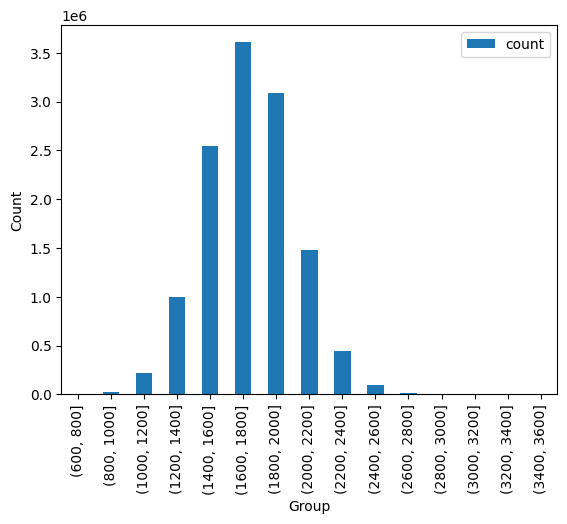

In [48]:
elo_freq=get_elo_freq(df)
elo_freq=elo_freq[["Elo","Count"]]
rating_bins = np.arange(600,3601, 200)
cuts=pd.cut(elo_freq["Elo"], bins=rating_bins)
elo_freq["group"]=cuts
groups=elo_freq.groupby('group').sum(["count"]).drop(columns="Elo")["Count"]
elo_freq=pd.DataFrame.from_dict({'group':list(groups.index.astype(str)),'count':list(groups.values)})
ax=elo_freq.plot(kind='bar',x='group',y='count')
ax.set_xlabel("Elo range group")
ax.set_ylabel("Count")

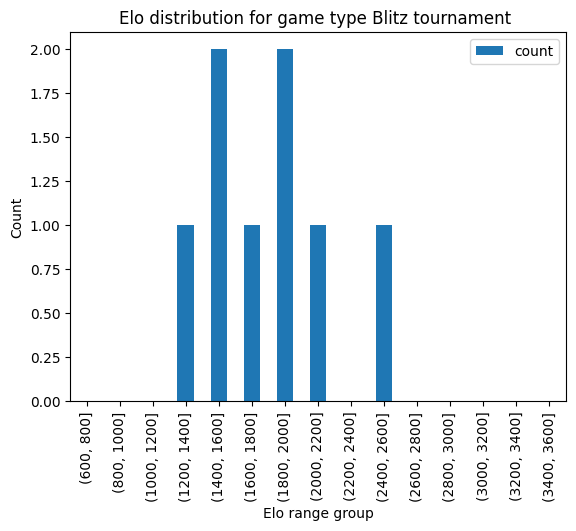

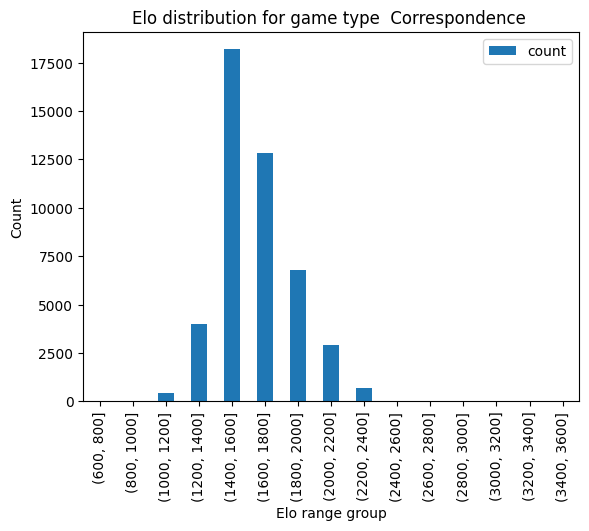

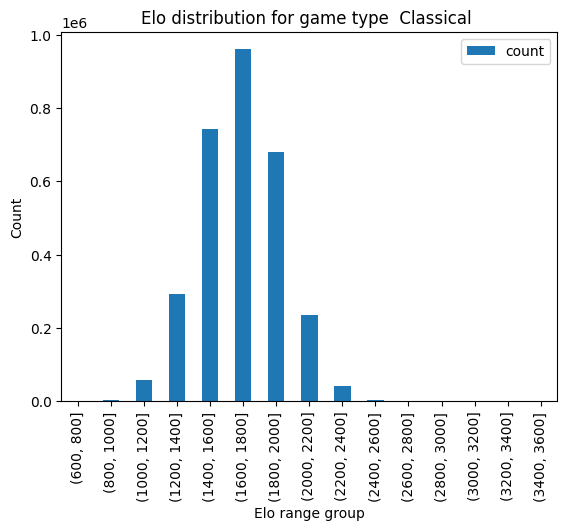

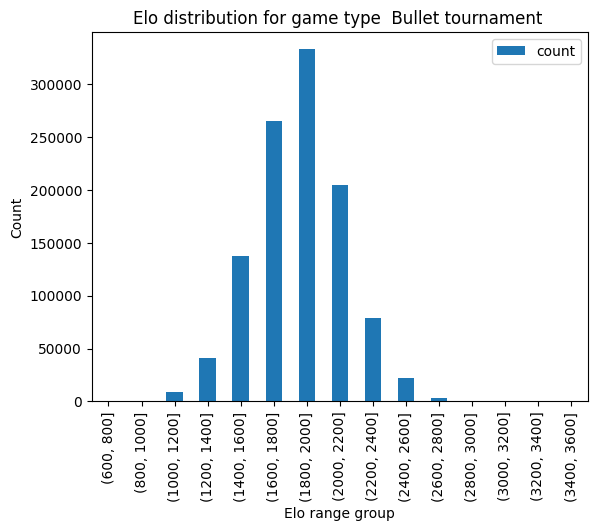

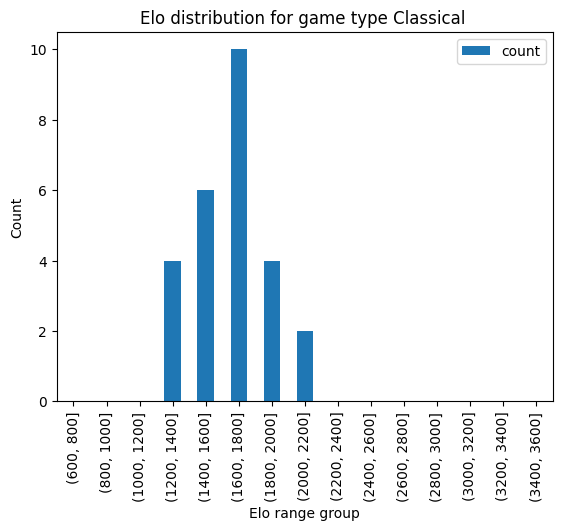

...

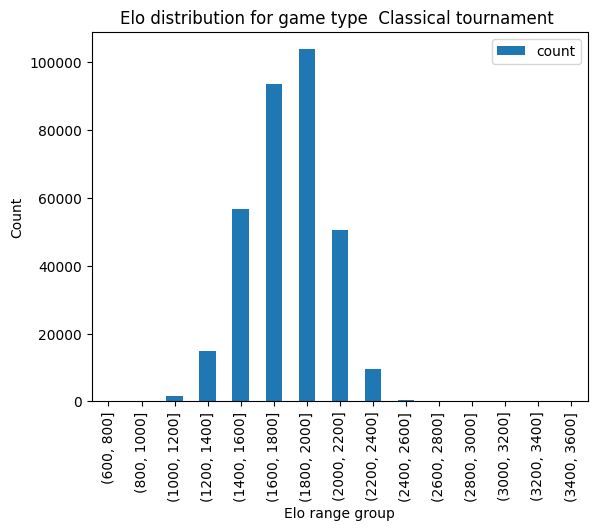

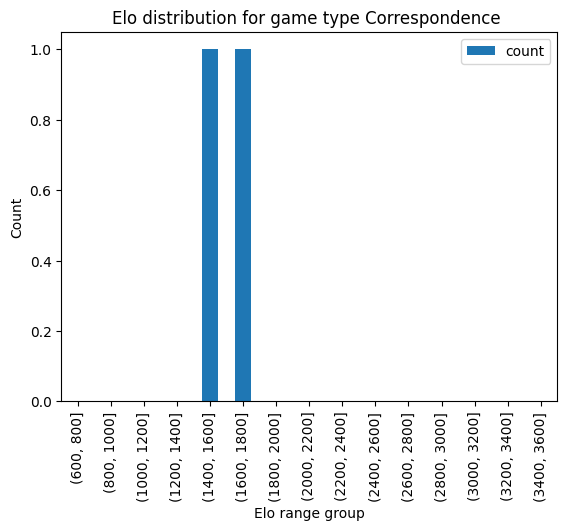

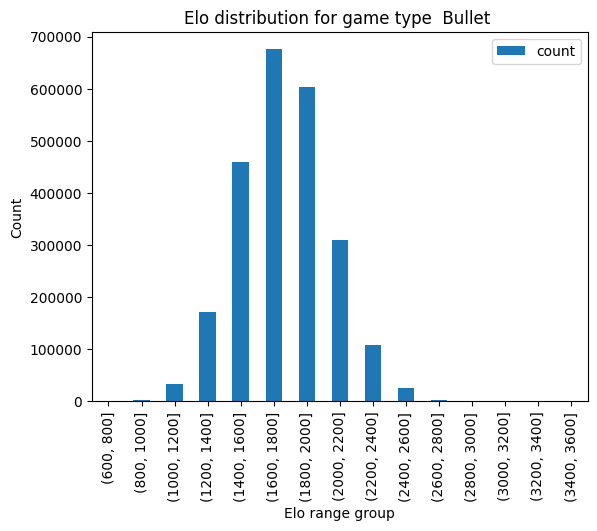

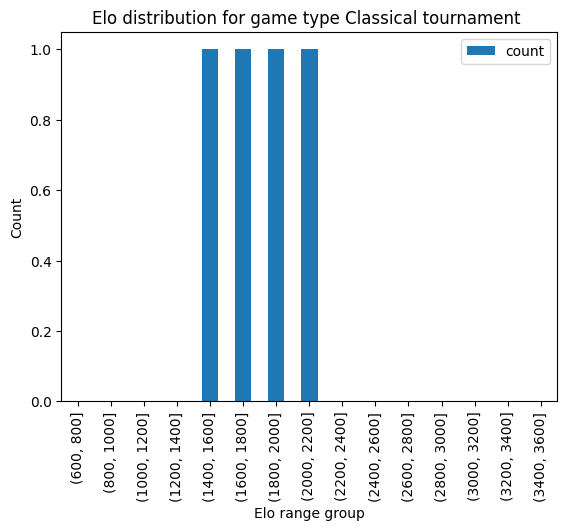

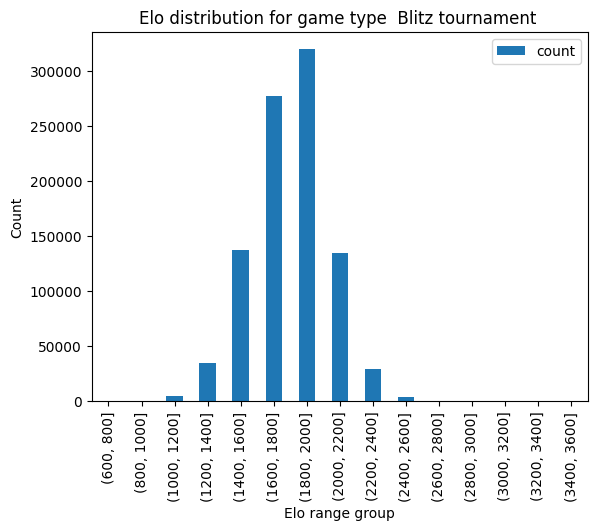

In [43]:
events=list(set(list(df["Event"])))

for e in events:
    df_e=df[df["Event"]==e]
    
    elo_freq=get_elo_freq(df_e)
    elo_freq=elo_freq[["Elo","Count"]]
    rating_bins = np.arange(600,3601, 200)
    cuts=pd.cut(elo_freq["Elo"], bins=rating_bins)
    elo_freq["group"]=cuts
    groups=elo_freq.groupby('group').sum(["count"]).drop(columns="Elo")["Count"]
    elo_freq=pd.DataFrame.from_dict({'group':list(groups.index.astype(str)),'count':list(groups.values)})
    ax=elo_freq.plot(kind='bar',x='group',y='count')
    ax.set_xlabel("Elo range group")
    ax.set_ylabel("Count")
    ax.set_title(f"Elo distribution for game type {e}")

## Effect of Higher Rating on White Win Rate

In [49]:

# Count the outcomes of games where White had a higher rating.
higher_white_outcomes = df[df["EloDiff"] > 0]["Result"].value_counts().compute()
print("\n\nResults of Games When White Had a Higher Rating:")
display(higher_white_outcomes)
# Calculate how often White won and lost when they had a higher rating.
num_higher_white_wins = higher_white_outcomes.loc["1-0"]
higher_white_wins_proportion = num_higher_white_wins / higher_white_outcomes.sum()
num_higher_white_losses = higher_white_outcomes.loc["0-1"]
higher_white_losses_proportion = num_higher_white_losses / higher_white_outcomes.sum()
print(
    f"Out of {higher_white_outcomes.sum()} games when White had a higher rating:\n  "
    f"White won {num_higher_white_wins} games ({higher_white_wins_proportion:.2%}).\n  "
    f"White lost {num_higher_white_losses} games ({higher_white_losses_proportion:.2%})."
)

AttributeError: 'Series' object has no attribute 'compute'

In [5]:
### Distribution of players games

In [4]:
df=read_file("data/lichess/dataset_raw/chess_games.csv")

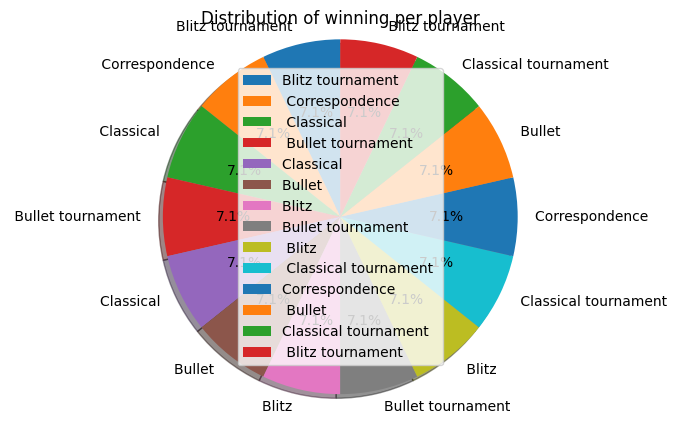

In [20]:
import matplotlib.pyplot as plt


by_event={e:len(df["Event"]==e) for e in list(set(list(df["Event"])))}
# defining labels
activities = list(by_event.keys())
 
# portion covered by each label
slices = list(by_event.values())
 
# color for each label
colors = ['r', 'y', 'g', 'b']
 
# plotting the pie chart
plt.pie(slices, labels = activities,  
        startangle=90, shadow = True,
        radius = 1.2, autopct = '%1.1f%%')
 
# plotting legend
plt.legend()
plt.title("Distribution of winning per player")


# showing the plot
plt.show()


<BarContainer object of 7 artists>

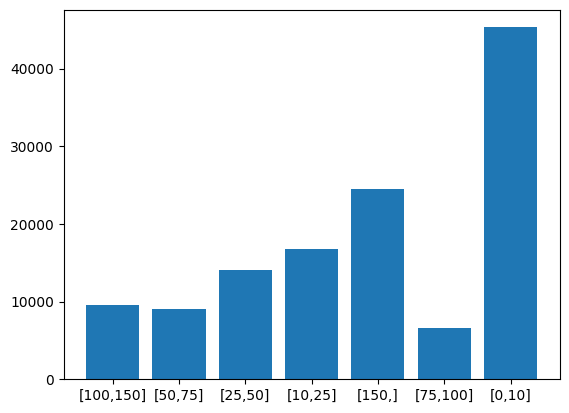

In [26]:
from collections import Counter
white_freq=Counter(list(df["White"]))
black_freq=Counter(list(df["Black"]))
all_freq=white_freq

for k,v in black_freq.items():
    all_freq[k]=all_freq.get(k,0)+v

count_freq={}
for k,v in all_freq.items():
    if v <=10:
        count_freq["[0,10]"]=count_freq.get("[0,10]",0)+1
    elif v <=25:
        count_freq["[10,25]"]=count_freq.get("[10,25]",0)+1
    elif v <=50:
        count_freq["[25,50]"]=count_freq.get("[25,50]",0)+1
    elif v <=75:
        count_freq["[50,75]"]=count_freq.get("[50,75]",0)+1
    elif v <=100:
        count_freq["[75,100]"]=count_freq.get("[75,100]",0)+1
    elif v <=150:
        count_freq["[100,150]"]=count_freq.get("[100,150]",0)+1
    else:
        count_freq["[150,]"]=count_freq.get("[150,]",0)+1

x = list(count_freq.keys())
y = list(count_freq.values())
plt.xlabel('Number of games')
plt.ylabel('Number of players')
plt.title('Number of players for every frequncy group')
plt.bar( x, y)


4
22939
1510798
546774
13
8
20
3
2339554
165633
1
1198177
2
472258


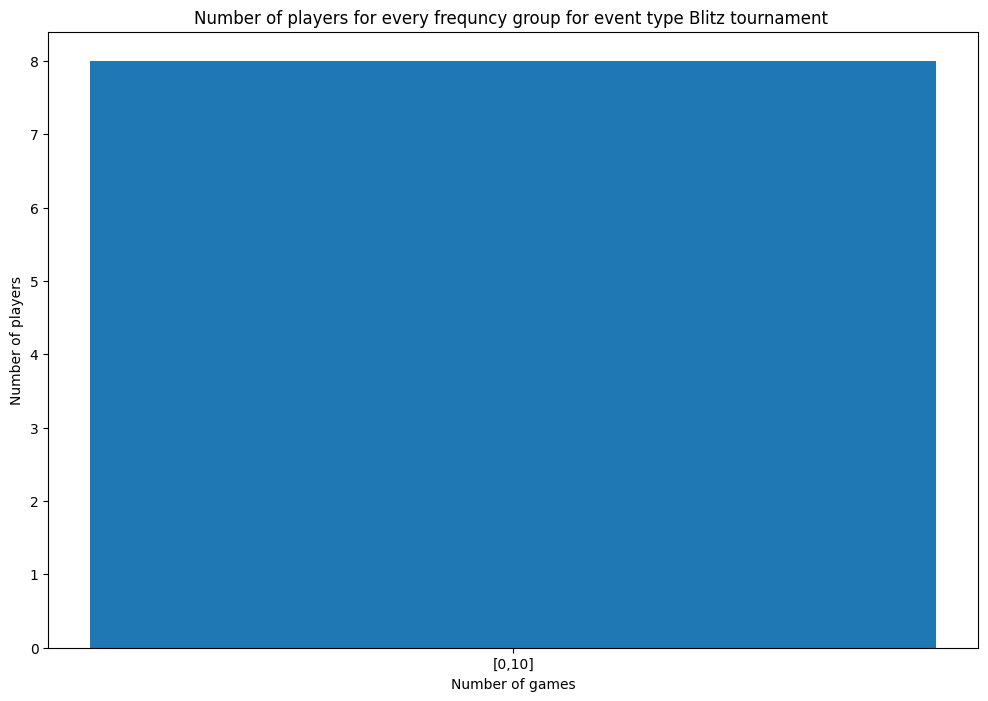

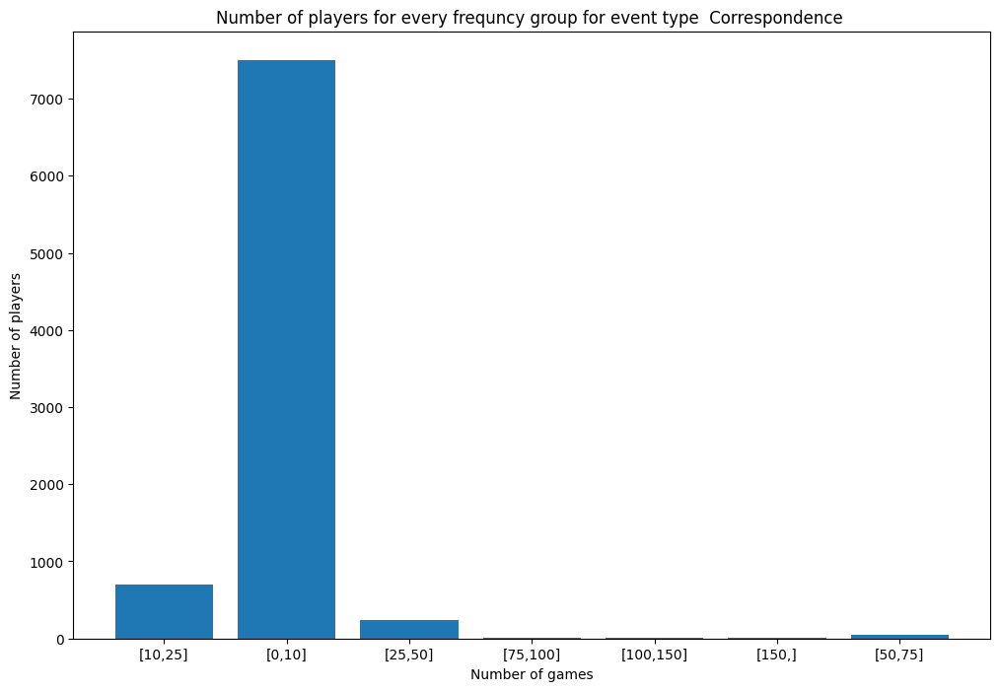

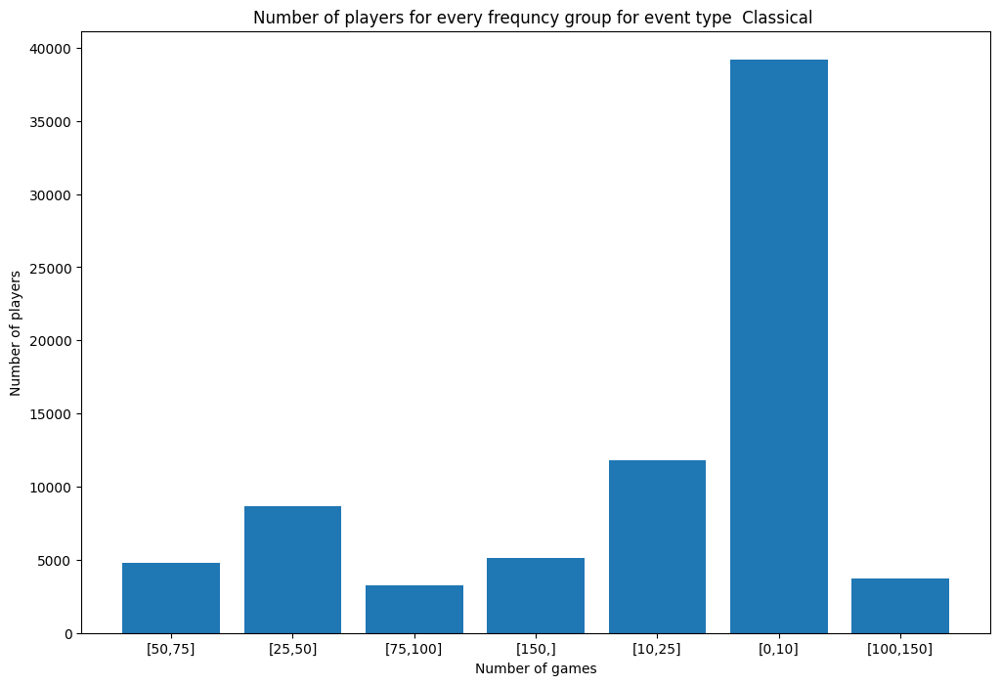

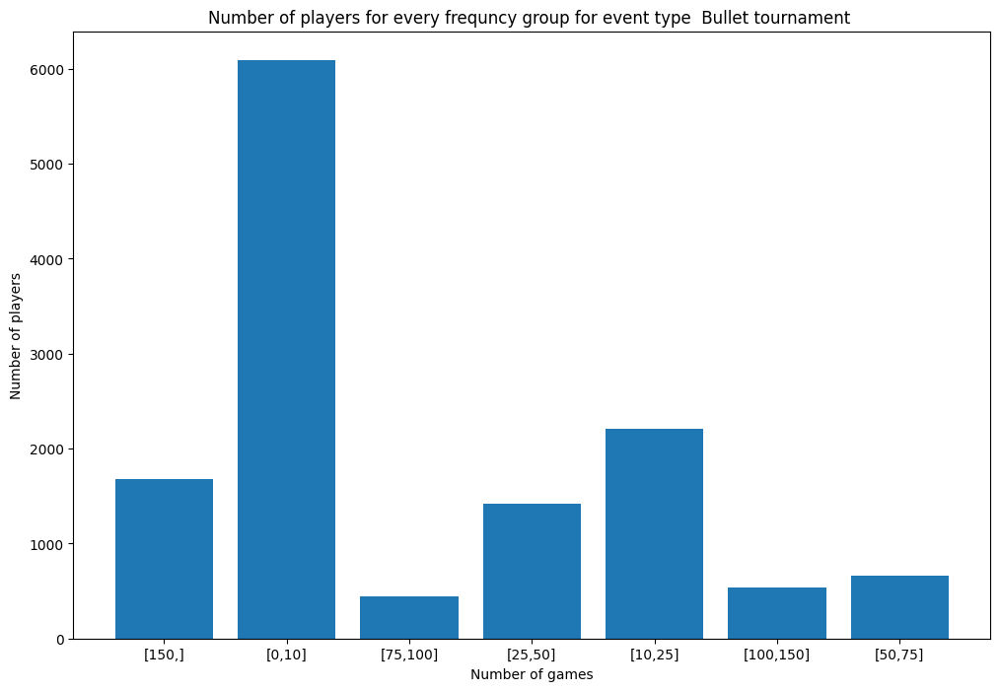

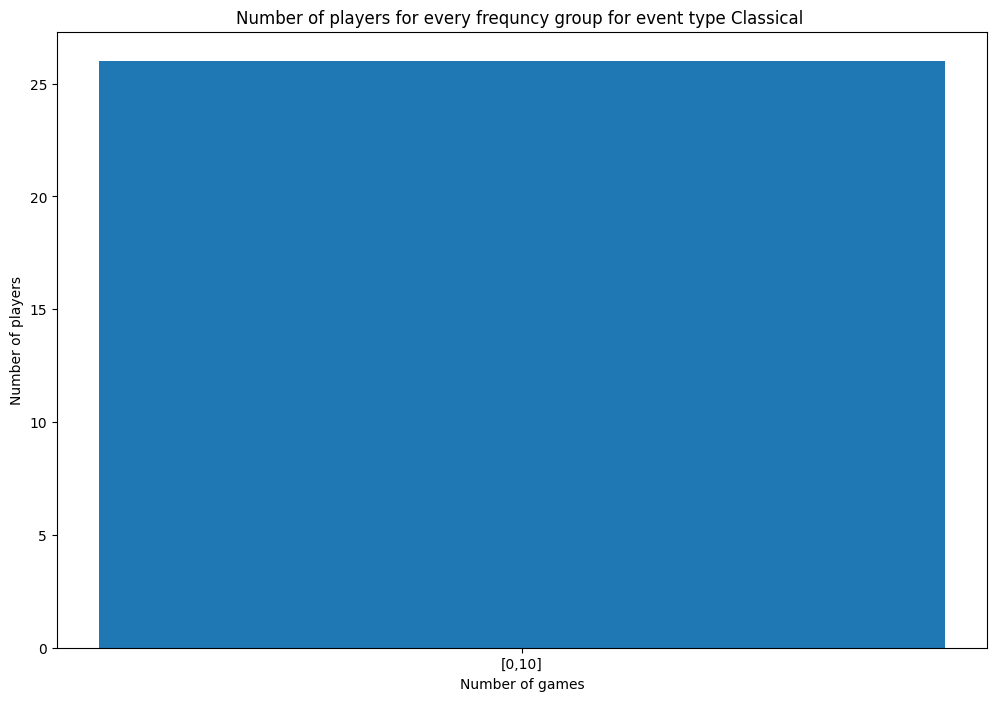

...

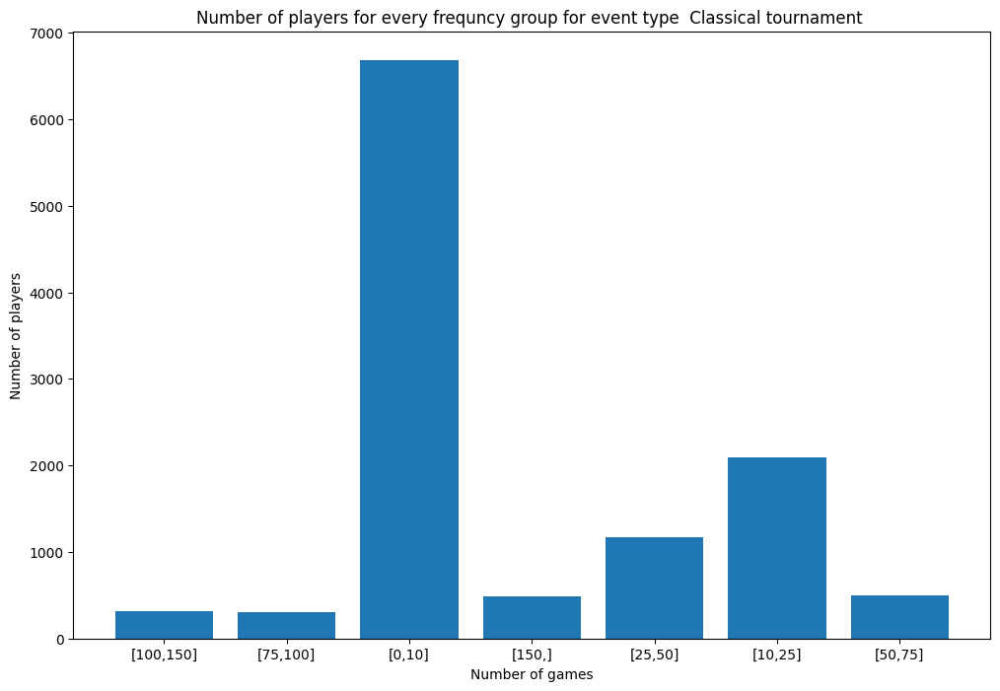

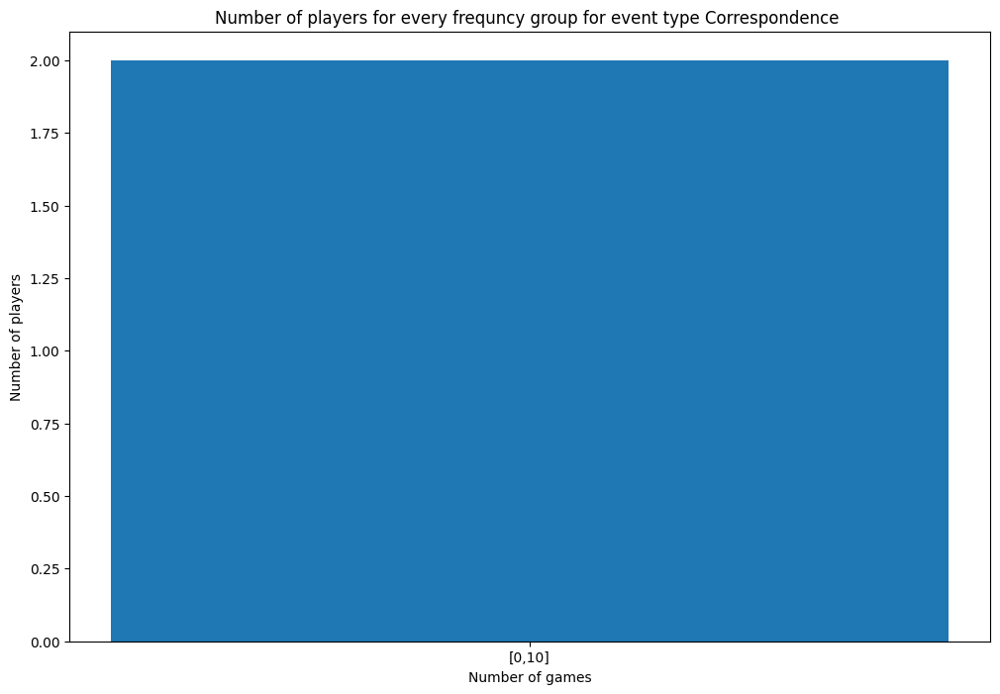

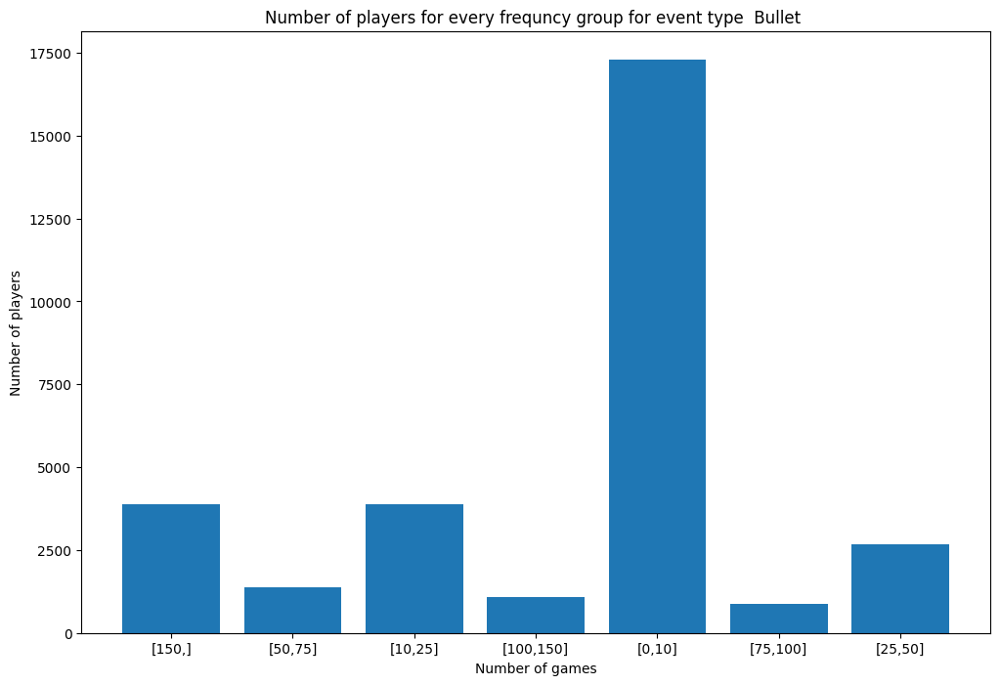

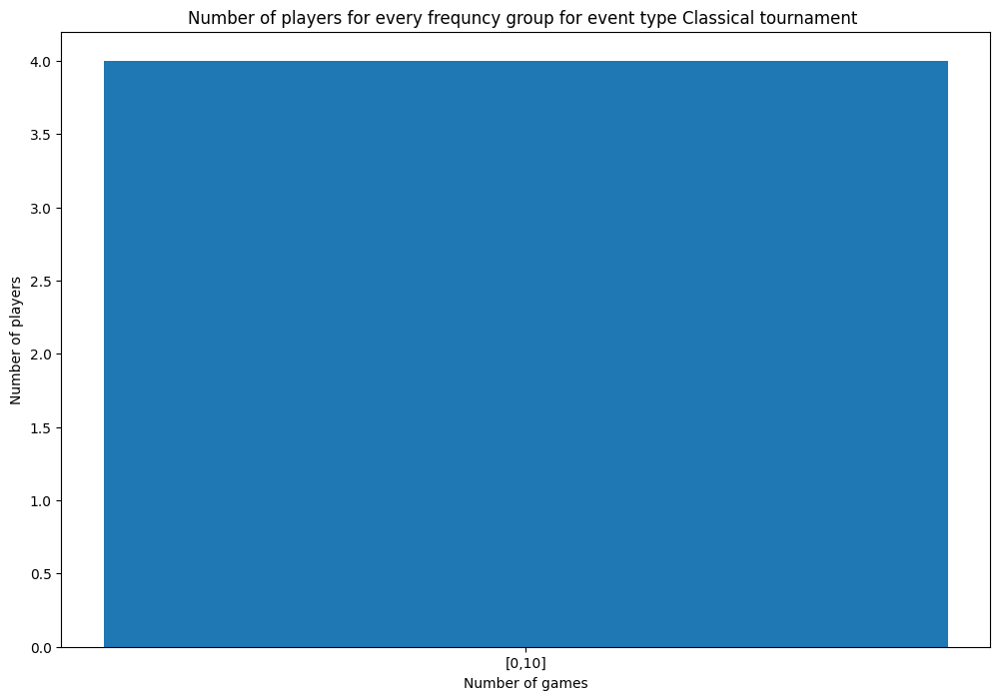

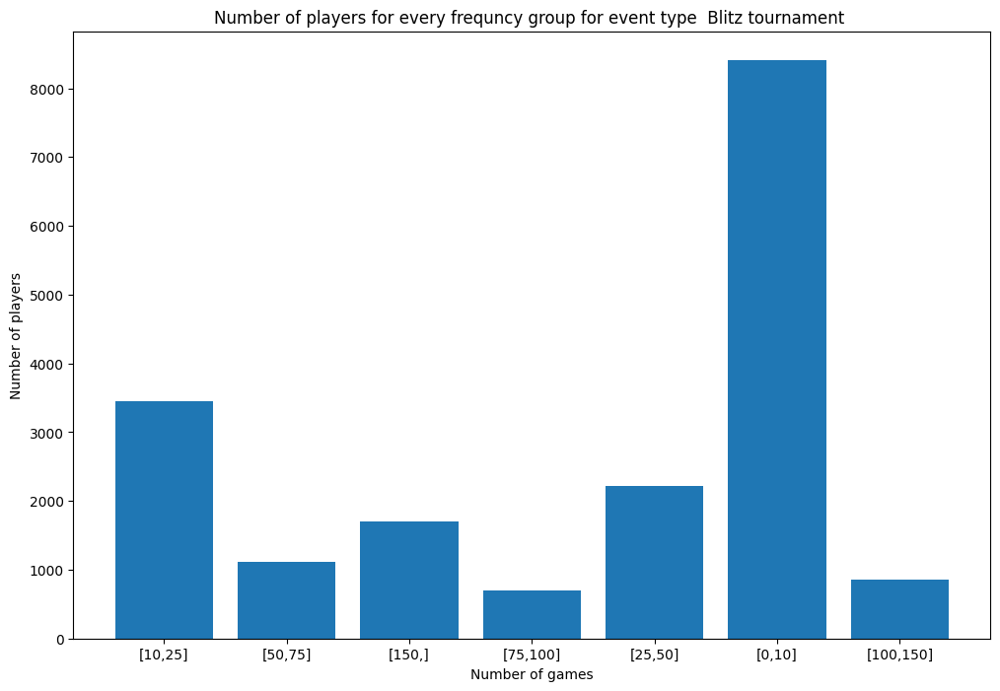

In [35]:
from collections import Counter

events=list(set(list(df["Event"])))


for e in events:
    df_e=df[df["Event"]==e]
    white_freq=Counter(list(df_e["White"]))
    black_freq=Counter(list(df_e["Black"]))
    all_freq=white_freq
    
    for k,v in black_freq.items():
        all_freq[k]=all_freq.get(k,0)+v
    
    count_freq={}
    for k,v in all_freq.items():
        if v <=10:
            count_freq["[0,10]"]=count_freq.get("[0,10]",0)+1
        elif v <=25:
            count_freq["[10,25]"]=count_freq.get("[10,25]",0)+1
        elif v <=50:
            count_freq["[25,50]"]=count_freq.get("[25,50]",0)+1
        elif v <=75:
            count_freq["[50,75]"]=count_freq.get("[50,75]",0)+1
        elif v <=100:
            count_freq["[75,100]"]=count_freq.get("[75,100]",0)+1
        elif v <=150:
            count_freq["[100,150]"]=count_freq.get("[100,150]",0)+1
        else:
            count_freq["[150,]"]=count_freq.get("[150,]",0)+1
    plt.figure(figsize=(12, 8))
    x = list(count_freq.keys())
    y = list(count_freq.values())
    plt.xlabel('Number of games')
    plt.ylabel('Number of players')
    plt.title(f'Number of players for every frequncy group for event type {e}')
    plt.bar( x, y)


4
22939
1510798
546774
13
8
20
3
2339554
165633
1
1198177
2
472258


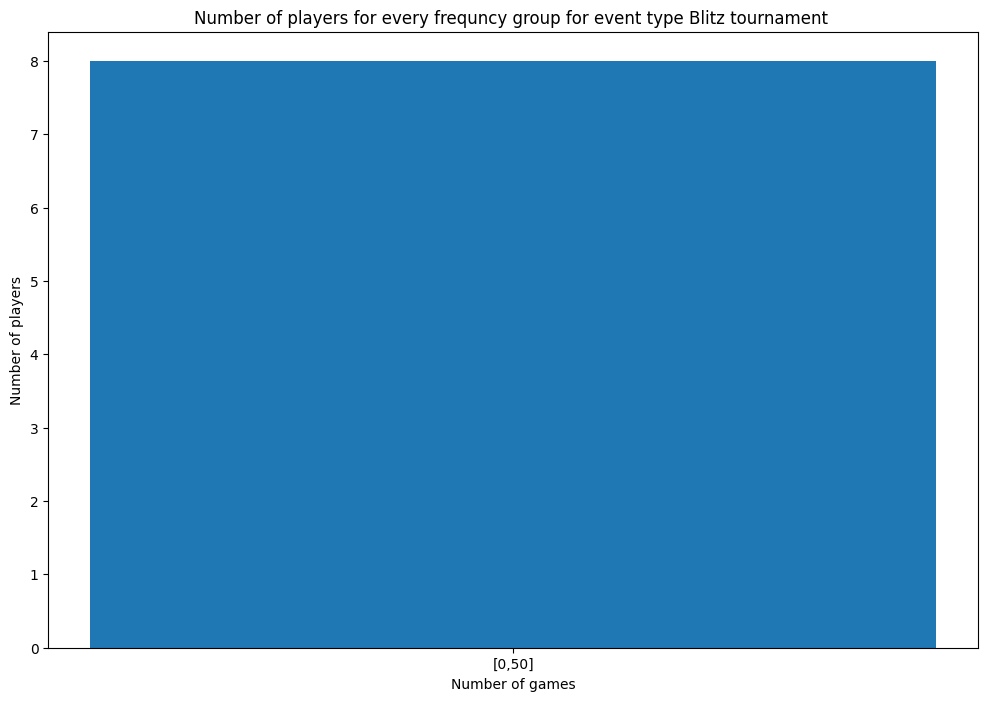

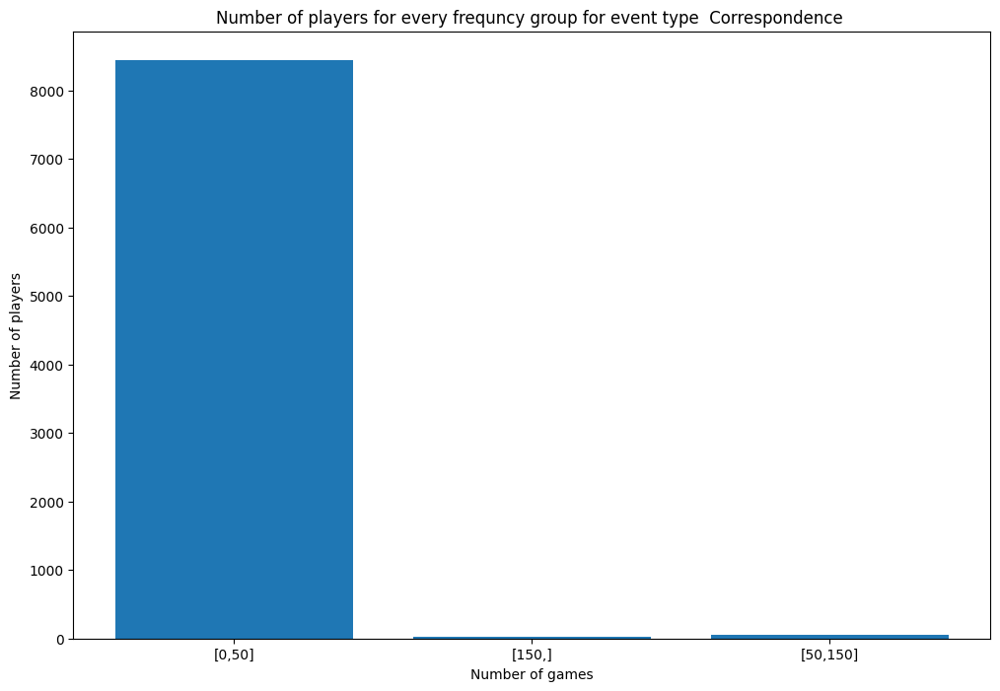

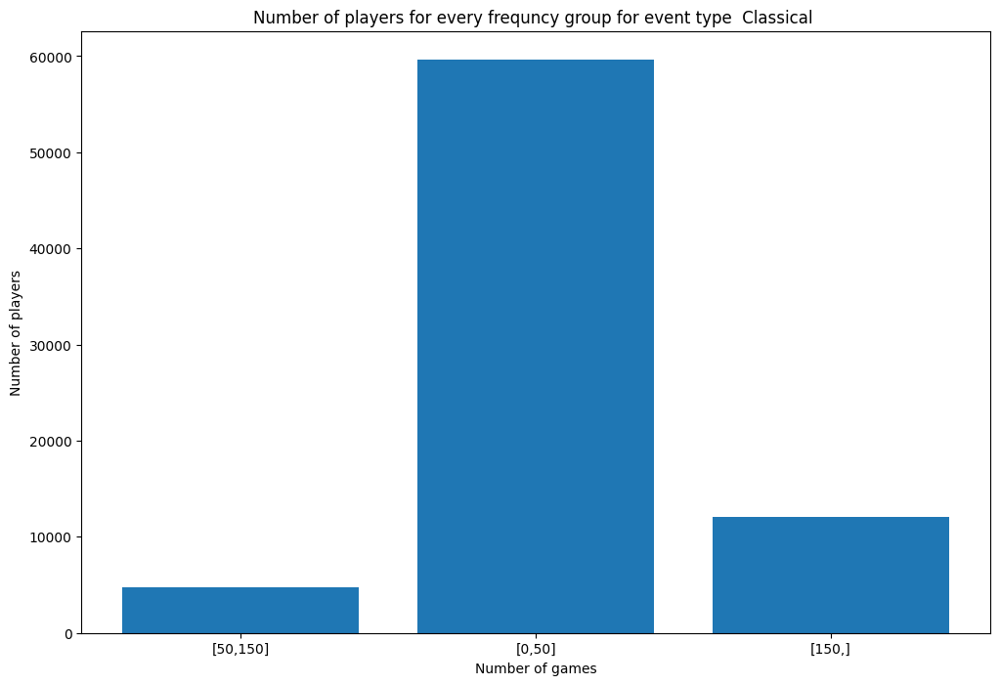

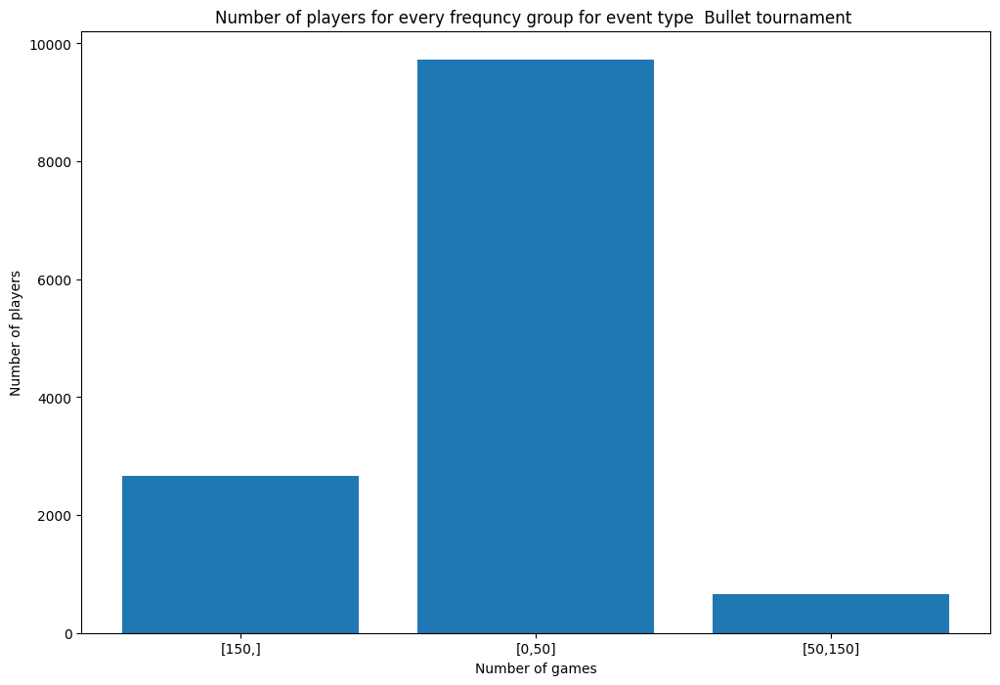

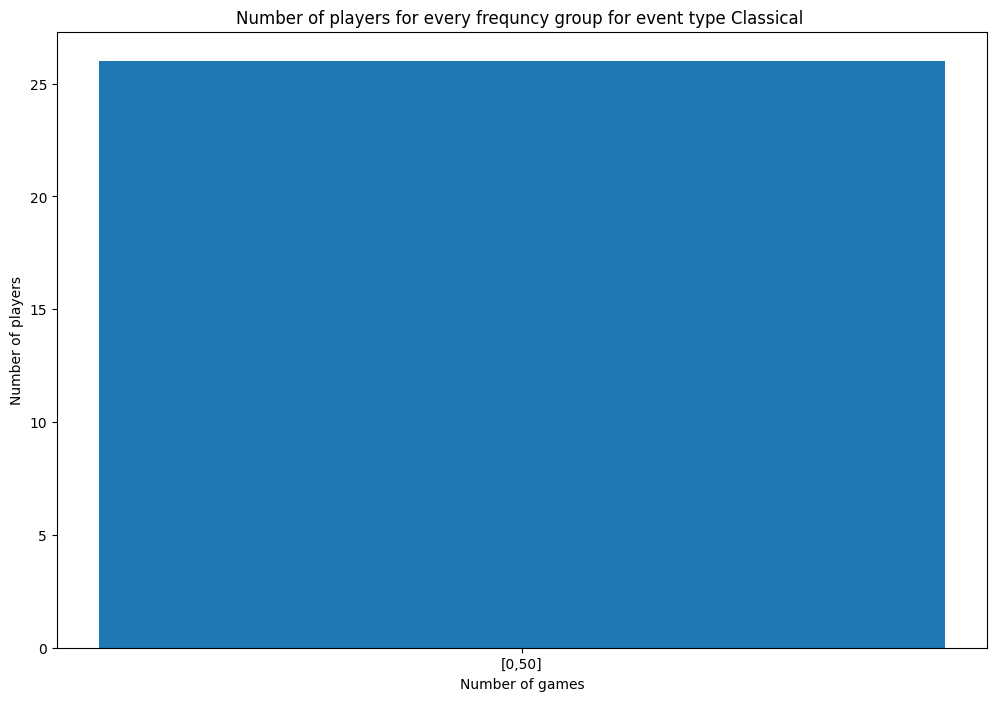

...

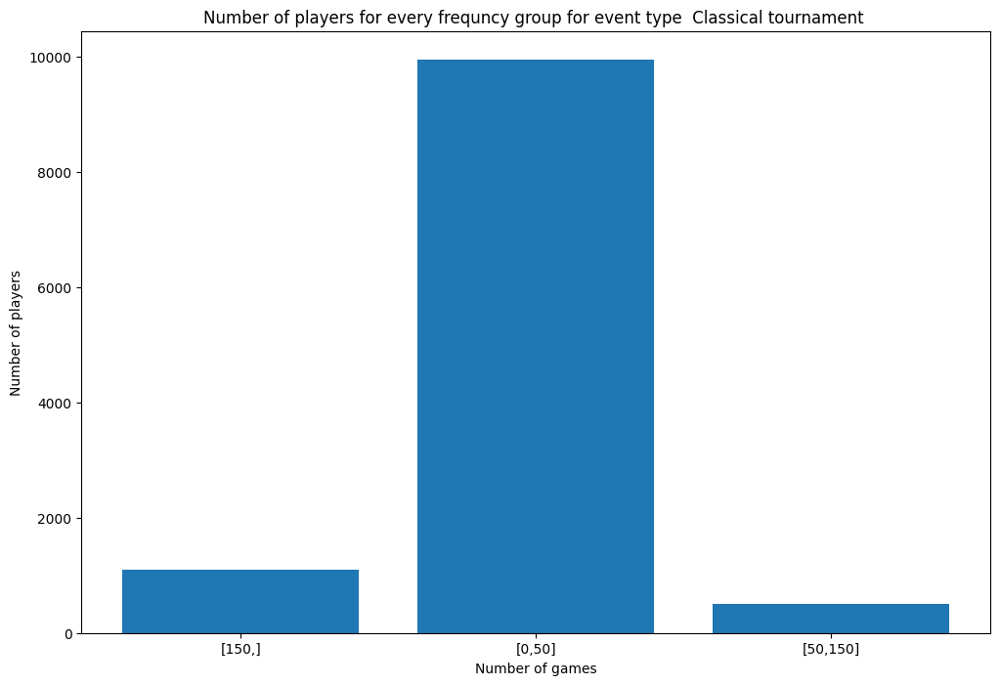

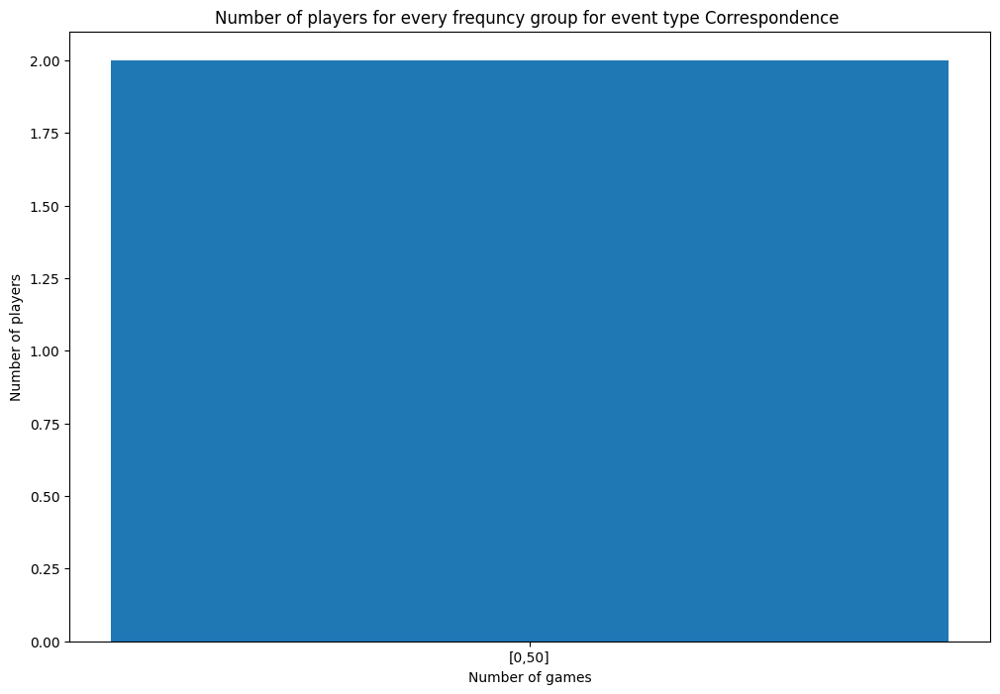

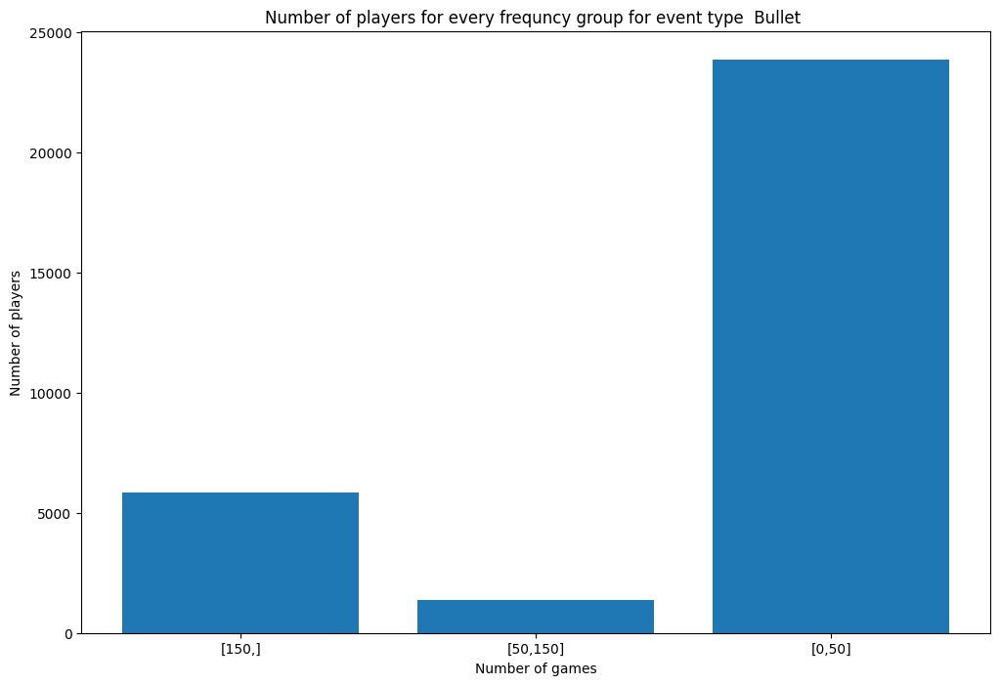

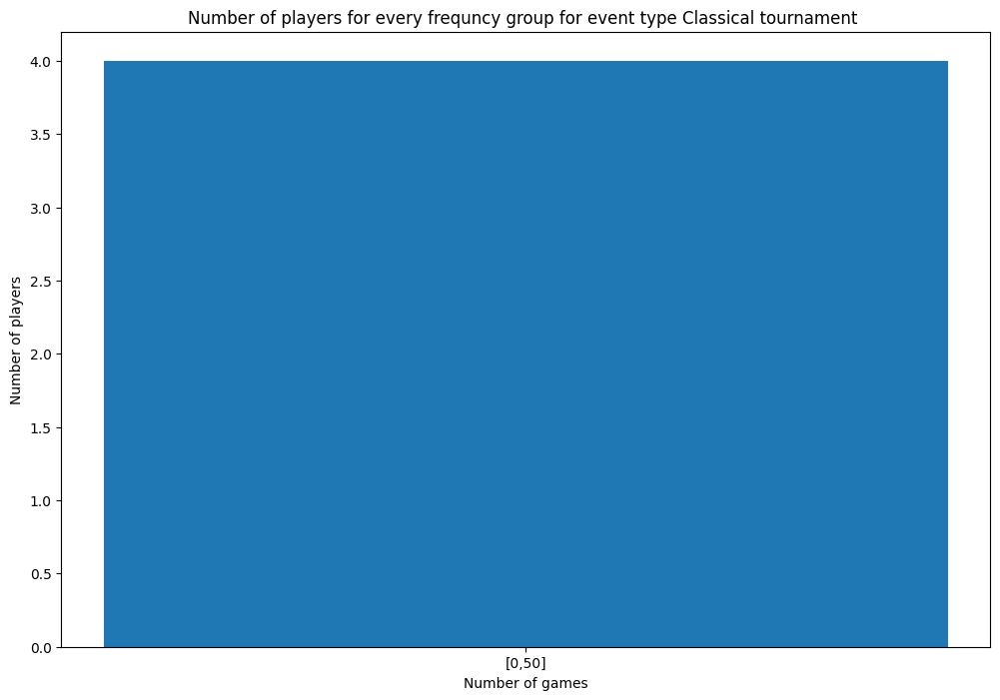

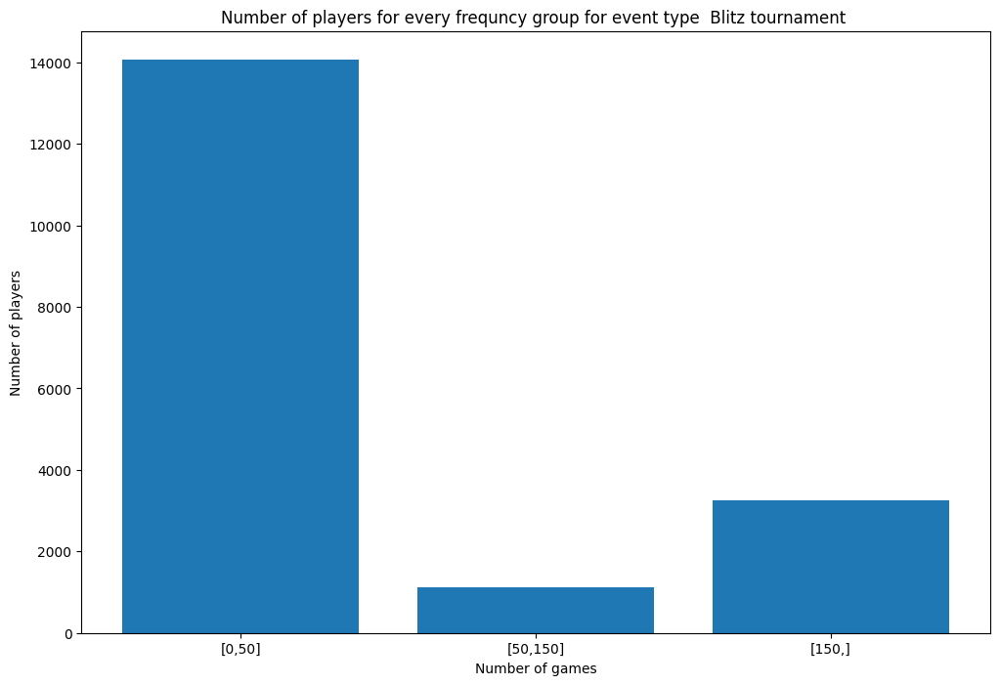

In [37]:
from collections import Counter

events=list(set(list(df["Event"])))


for e in events:
    df_e=df[df["Event"]==e]
    white_freq=Counter(list(df_e["White"]))
    black_freq=Counter(list(df_e["Black"]))
    all_freq=white_freq
    
    for k,v in black_freq.items():
        all_freq[k]=all_freq.get(k,0)+v
    
    count_freq={}
    for k,v in all_freq.items():
        if v <=50:
            count_freq["[0,50]"]=count_freq.get("[0,50]",0)+1
        elif v <=75:
            count_freq["[50,150]"]=count_freq.get("[50,150]",0)+1
        else:
            count_freq["[150,]"]=count_freq.get("[150,]",0)+1
    plt.figure(figsize=(12, 8))
    x = list(count_freq.keys())
    y = list(count_freq.values())
    plt.xlabel('Number of games')
    plt.ylabel('Number of players')
    plt.title(f'Number of players for every frequncy group for event type {e}')
    plt.bar( x, y)


In [ ]:
elo_freq=get_elo_freq(df)
elo_freq=elo_freq[["Elo","Count"]]
rating_bins = np.arange(600,3601, 200)
cuts=pd.cut(elo_freq["Elo"], bins=rating_bins)
elo_freq["group"]=cuts
groups=elo_freq.groupby('group').sum(["count"]).drop(columns="Elo")["Count"]
elo_freq=pd.DataFrame.from_dict({'group':list(groups.index.astype(str)),'count':list(groups.values)})
ax=elo_freq.plot(kind='bar',x='group',y='count')
ax.set_xlabel("Elo range group")
ax.set_ylabel("Count")

In [ ]:
import matplotlib.pyplot as plt




by_event={e:len(df["Event"]==e) for e in list(set(list(df["Event"])))}


for e in by_event.keys():
    by_player_for_event={}



# defining labels
activities = list(by_event.keys())
 
# portion covered by each label
slices = list(by_event.values())
 
# color for each label
colors = ['r', 'y', 'g', 'b']
 
# plotting the pie chart
plt.pie(slices, labels = activities,  
        startangle=90, shadow = True,
        radius = 1.2, autopct = '%1.1f%%')
 
# plotting legend
plt.legend()
plt.title("Distribution of winning per player")


# showing the plot
plt.show()


In [ ]:
ax=elo_freq.plot(kind='bar',x='group',y='count')
ax.set_xlabel("Elo range group")
ax.set_ylabel("Count")

In [ ]:
df_c=(df[df["Event"]==" Blitz "])
w=dict(df_c["White"].value_counts())
b=dict(df_c["Black"].value_counts())

In [130]:
df

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,label,kmeans_euclidean
petedoherty,1915,1921,1931,1942,1953,1962,1971,1959,1954,1962,...,1975,1982,1968,1957,1973,1984,1995,2001,3,3
tom62,1577,1589,1600,1610,1623,1624,1638,1647,1656,1662,...,1686,1692,1677,1683,1676,1687,1675,1683,6,6
dachampChi,1505,1519,1510,1527,1517,1531,1545,1539,1532,1527,...,1522,1510,1500,1492,1485,1478,1474,1466,3,3
sniperchess,2147,2159,2165,2172,2182,2192,2180,2185,2190,2185,...,2173,2156,2163,2171,2181,2188,2172,2159,14,14
Analitico,1944,1956,1968,1978,1978,1988,1998,2006,2013,2025,...,2060,2046,2053,2039,2036,2025,2036,2044,6,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Eric_1380,1596,1586,1597,1600,1586,1573,1585,1595,1600,1589,...,1565,1576,1588,1592,1598,1604,1609,1601,12,12
TPC,1559,1569,1587,1605,1620,1633,1622,1612,1608,1605,...,1614,1610,1606,1603,1587,1605,1597,1590,3,3
jopsyc,1208,1197,1187,1206,1198,1191,1209,1206,1198,1211,...,1245,1239,1235,1257,1256,1274,1270,1251,4,4
carlosalemao,1432,1428,1426,1435,1430,1422,1431,1449,1442,1455,...,1460,1452,1442,1439,1428,1439,1443,1434,1,1


In [23]:

df_c=(df[df["Event"]==" Blitz "])
w=dict(df_c["White"].value_counts())
b=dict(df_c["Black"].value_counts())

all={}

all=w

for k,v in b.items():
    all[k]=all.get(k,0)+v
h=[]
for k,v in w.items():
    if v>200:
        h.append(k)
len(h)

6798

In [63]:
#
df=df[(df["White"].isin(h))|(df["Black"].isin(h))]

#
df1=df[(df["White"].isin(h))&(df["Black"].isin(h))]
df1=df1[["White","WhiteElo","UTCDate","UTCTime"]].rename(columns={"White":"Player","WhiteElo":"Elo"})

df2=df[(df["White"].isin(h))&(~df["Black"].isin(h))]
df2=df2[["White","WhiteElo","UTCDate","UTCTime"]].rename(columns={"White":"Player","WhiteElo":"Elo"})

#
df3=df[(~df["White"].isin(h))&(df["Black"].isin(h))]
df3=df3[["Black","BlackElo","UTCDate","UTCTime"]].rename(columns={"Black":"Player","BlackElo":"Elo"})

#
df4=df[(df["White"].isin(h))&(df["Black"].isin(h))]
df4=df4[["Black","BlackElo","UTCDate","UTCTime"]].rename(columns={"Black":"Player","BlackElo":"Elo"})

#
df=pd.concat([df1,df2,df3,df4])

In [65]:
players=list(set(df_fixed["Player"]))
players_dict = {p: df[df['Player'] == p] for p in tqdm(players)}

100%|███████████████████████████████████████| 6798/6798 [15:09<00:00,  7.47it/s]


In [67]:
with open("data/lichess/dataset_raw/players_dict.pkl", 'wb') as f:
    pickle.dump(players_dict, f)  

In [68]:
# order dates
for k,v in tqdm(players_dict.items()):
    curr=players_dict[k] 
    curr["Timestamp"]=(curr["UTCDate"]+" "+curr["UTCTime"]).apply(lambda r:date_to_num(r))
    curr=curr.sort_values(by="Timestamp")
    players_dict[k]=curr.reset_index().drop(columns="index")



100%|██████████████████████████████████████| 6798/6798 [00:14<00:00, 456.07it/s]


In [70]:
with open("data/lichess/dataset_raw/players_dict.pkl", 'wb') as f:
    pickle.dump(players_dict, f)  

In [44]:
with open("data/lichess/dataset_raw/players_dict.pkl", 'rb') as f:
    players_dict=pickle.load( f)  

In [45]:
for k,v in tqdm(players_dict.items()):
   players_dict[k]=players_dict[k][["Elo","Timestamp"]] 

100%|█████████████████████████████████████| 6798/6798 [00:02<00:00, 2369.83it/s]


In [166]:
def get_samples(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        v=players_dict[p]
        samples[p]=list(v[(v.index<=offset+num_samples)&(v.index>=offset)]["Elo"])
            
    return samples

def dp(dist_mat):
    """
    Find minimum-cost path through matrix `dist_mat` using dynamic programming.

    The cost of a path is defined as the sum of the matrix entries on that
    path. See the following for details of the algorithm:

    - http://en.wikipedia.org/wiki/Dynamic_time_warping
    - https://www.ee.columbia.edu/~dpwe/resources/matlab/dtw/dp.m

    The notation in the first reference was followed, while Dan Ellis's code
    (second reference) was used to check for correctness. Returns a list of
    path indices and the cost matrix.
    """

    N, M = dist_mat.shape
    
    # Initialize the cost matrix
    cost_mat = np.zeros((N + 1, M + 1))
    for i in range(1, N + 1):
        cost_mat[i, 0] = np.inf
    for i in range(1, M + 1):
        cost_mat[0, i] = np.inf

    # Fill the cost matrix while keeping traceback information
    traceback_mat = np.zeros((N, M))
    for i in range(N):
        for j in range(M):
            penalty = [
                cost_mat[i, j],      # match (0)
                cost_mat[i, j + 1],  # insertion (1)
                cost_mat[i + 1, j]]  # deletion (2)
            i_penalty = np.argmin(penalty)
            cost_mat[i + 1, j + 1] = dist_mat[i, j] + penalty[i_penalty]
            traceback_mat[i, j] = i_penalty

    # Traceback from bottom right
    i = N - 1
    j = M - 1
    path = [(i, j)]
    while i > 0 or j > 0:
        tb_type = traceback_mat[i, j]
        if tb_type == 0:
            # Match
            i = i - 1
            j = j - 1
        elif tb_type == 1:
            # Insertion
            i = i - 1
        elif tb_type == 2:
            # Deletion
            j = j - 1
        path.append((i, j))

    # Strip infinity edges from cost_mat before returning
    cost_mat = cost_mat[1:, 1:]
    return (path[::-1], cost_mat)


def kmeans_silhoutte(X_train,metric,max_k=10):
    silhoutte_score = []
    for i in range(2,max_k):
        start = time.time()
        model= TimeSeriesKMeans(n_clusters=i,metric=metric,n_jobs=-1,random_state=0)
        y_pred = model.fit_predict(X_train)
        score = silhouette_score(X_train, y_pred, metric=metric)
        silhoutte_score.append(score)
        stop = time.time()
        duration = stop - start
        print(f"K = {i}.", f"Took {duration:.2f} seconds to calculate.")

    return silhoutte_score

def kmeans_calinski_harabasz(X_train,metric,max_k=10):
    scores = []
    for i in range(2,max_k):
        start = time.time()
        model= TimeSeriesKMeans(n_clusters=i,metric=metric,n_jobs=-1,random_state=0)
        y_pred = model.fit_predict(X_train)
        score = metrics.calinski_harabasz_score(X_ss, y_pred_ss)
        scores.append(score)
        stop = time.time()
        duration = stop - start
        print(f"K = {i}.", f"Took {duration:.2f} seconds to calculate.")

    return scores

  

def kmeans_wcsss(X_train,metric,max_k=10):
    wcss = []
    for i in range(2,max_k):
        start = time.time()
        model= TimeSeriesKMeans(n_clusters=i,metric=metric,n_jobs=-1,random_state=0)
        model.fit_predict(X_train)
        wcss.append(model.inertia_)
        stop = time.time()
        duration = stop - start
        print(f"K = {i}.", f"Took {duration:.2f} seconds to calculate.")
    return wcss

def kmeans_cluster(n_clusters,algo,X_train,metric):
    model= TimeSeriesKMeans(n_clusters=n_clusters,
                        metric=metric,
                        n_jobs=-1,
                        random_state=0)
    y_pred = model.fit_predict(X_train)
    model.to_pickle(f"./tsl/models/{algo}.pkl")



    for yi in range(len(np.unique(y_pred))):
      for xx in X_train[y_pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=.2)

        
      plt.plot(model.cluster_centers_[yi].ravel(), "r-")
      plt.xlim(0, X_train.shape[1])
      plt.ylim(-5, 5)
      plt.text(0.55, 0.85,'Cluster %d' % (yi + 1), transform=plt.gca().transAxes)
      plt.title("kmeans")
      plt.tight_layout()
      plt.show();
    
    
    for i in range(len(np.unique(y_pred))):
      count = (sum(y_pred == i)/len(y_pred))*100
      print(f"The {count:.2f}% of the observations fall into Cluster {i + 1}")
    
    return y_pred

In [47]:
# create required directory structure
dir_paths = ['./tsl', './tsl/models', './tsl/plots']

for dir_path in dir_paths:
    if not os.path.exists(dir_path):
        os.makedirs(dir_path)

## length 10 timeseries

In [158]:
df=pd.DataFrame.from_dict(get_samples(players_dict,50,10)).T

In [153]:
players_dict

{'petedoherty':       Elo     Timestamp
 0    1983  1.467394e+09
 1    1974  1.467395e+09
 2    1987  1.467395e+09
 3    1978  1.467395e+09
 4    1969  1.467396e+09
 ..    ...           ...
 328  1989  1.470001e+09
 329  1975  1.470001e+09
 330  1983  1.470001e+09
 331  1991  1.470001e+09
 332  1998  1.470002e+09
 
 [333 rows x 2 columns],
 'tom62':       Elo     Timestamp
 0    1567  1.467376e+09
 1    1555  1.467378e+09
 2    1542  1.467379e+09
 3    1535  1.467379e+09
 4    1548  1.467379e+09
 ..    ...           ...
 309  1623  1.469427e+09
 310  1616  1.469456e+09
 311  1611  1.469458e+09
 312  1613  1.469459e+09
 313  1602  1.469459e+09
 
 [314 rows x 2 columns],
 'dachampChi':       Elo     Timestamp
 0    1537  1.467326e+09
 1    1531  1.467326e+09
 2    1524  1.467343e+09
 3    1520  1.467345e+09
 4    1512  1.467345e+09
 ..    ...           ...
 410  1518  1.469938e+09
 411  1509  1.469938e+09
 412  1501  1.469997e+09
 413  1494  1.469997e+09
 414  1510  1.469998e+09
 
 [415 

In [51]:

%%time

# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values 
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization 
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)

,0,1,2,3,4,5,6,7,8,9,10
petedoherty,-1.875248,-1.525626,-0.942921,-0.301947,0.339028,0.863462,1.387896,0.688651,0.397298,0.863462,0.105946
tom62,-1.723269,-1.305890,-0.923293,-0.575477,-0.123316,-0.088535,0.398407,0.711441,1.024476,1.233165,1.372291
dachampChi,-1.696124,-0.481226,-1.262232,0.213002,-0.654783,0.560115,1.775013,1.254343,0.646894,0.213002,-0.568004
sniperchess,-2.178593,-1.274272,-0.822111,-0.294590,0.459012,1.212613,0.308292,0.685092,1.061893,0.685092,0.157571
Analitico,-1.698782,-1.252978,-0.807175,-0.435672,-0.435672,-0.064169,0.307334,0.604537,0.864589,1.310392,1.607594


,0,1,2,3,4,5,6,7,8,9,10
petedoherty,0.0,0.107143,0.285714,0.482143,0.678571,0.839286,1.000000,0.785714,0.696429,0.839286,0.607143
tom62,0.0,0.134831,0.258427,0.370787,0.516854,0.528090,0.685393,0.786517,0.887640,0.955056,1.000000
dachampChi,0.0,0.350000,0.125000,0.550000,0.300000,0.650000,1.000000,0.850000,0.675000,0.550000,0.325000
sniperchess,0.0,0.266667,0.400000,0.555556,0.777778,1.000000,0.733333,0.844444,0.955556,0.844444,0.688889
Analitico,0.0,0.134831,0.269663,0.382022,0.382022,0.494382,0.606742,0.696629,0.775281,0.910112,1.000000


(6798, 11, 1) (6798, 11, 1)
CPU times: user 1.32 s, sys: 2.03 ms, total: 1.33 s
Wall time: 1.33 s


In [123]:
players_names=list(df.index)

In [117]:
len(X_train)

6798

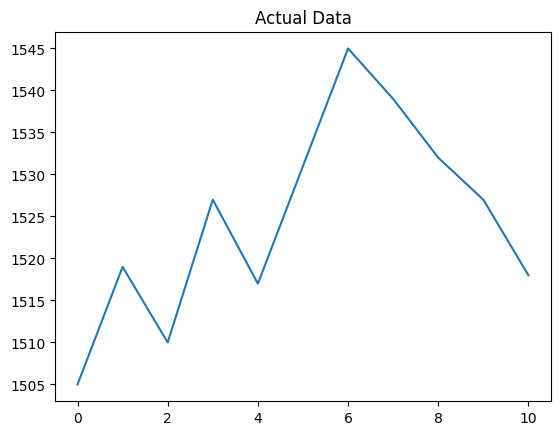

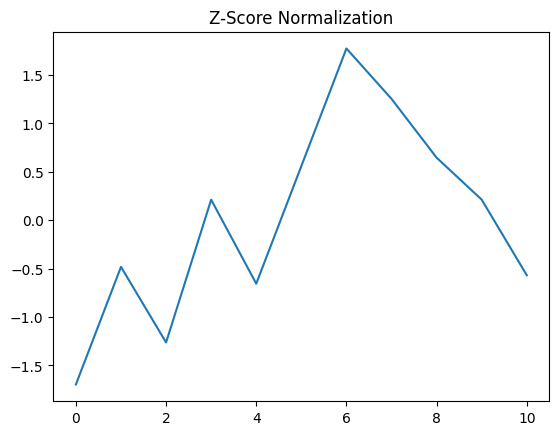

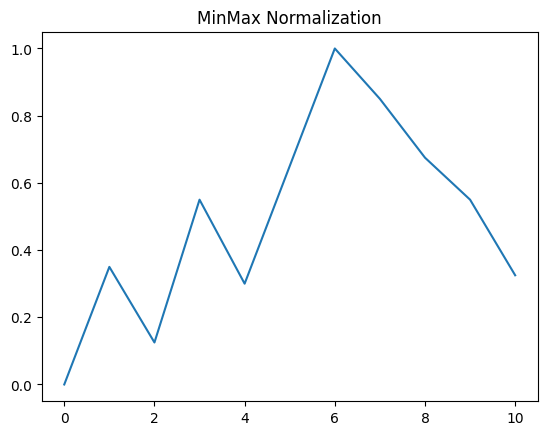

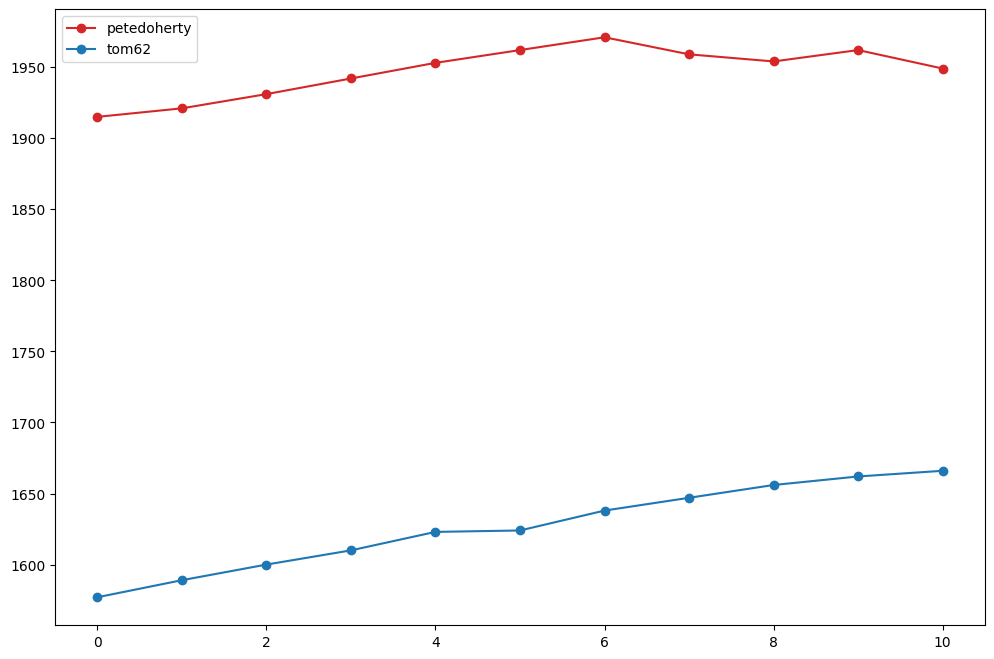

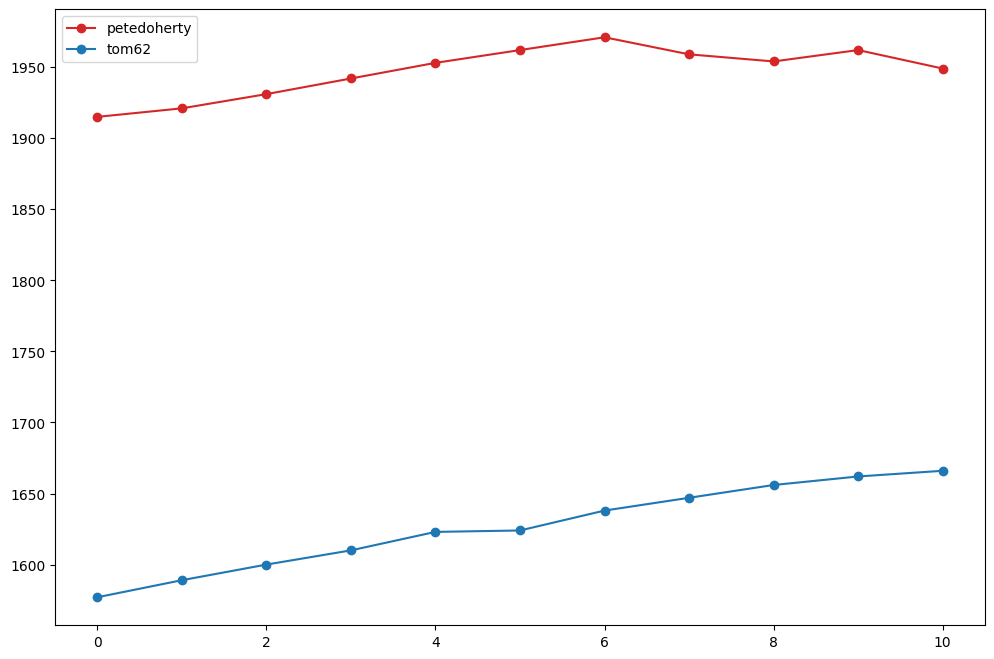

In [52]:
# Select a product Id to compare normal data with scaled data
product = "dachampChi"

# Visualize the sales (qty) for the product
df.loc[product].plot(title="Actual Data"), plt.show()
df_ss.loc[product].plot(title="Z-Score Normalization"), plt.show()
df_mm.loc[product].plot(title="MinMax Normalization"), plt.show();


x = df.loc["petedoherty"]
y = df.loc["tom62"]

plt.figure(figsize=(12, 8))
plt.plot(x, "-o", c="C3")
plt.plot(y, "-o", c="C0")
plt.legend([x.name, y.name]);

# Select moving average sales
w = df.loc["petedoherty"]
z = df.loc["tom62"]

plt.figure(figsize=(12, 8))
plt.plot(w, "-o", c="C3")
plt.plot(z, "-o", c="C0")
plt.legend([w.name, z.name]);

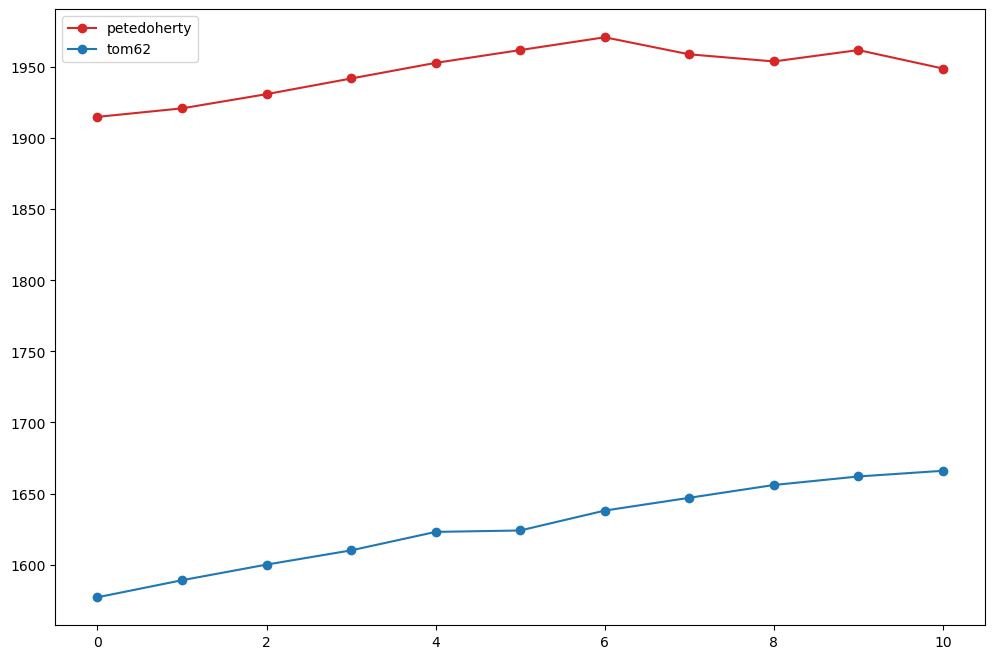

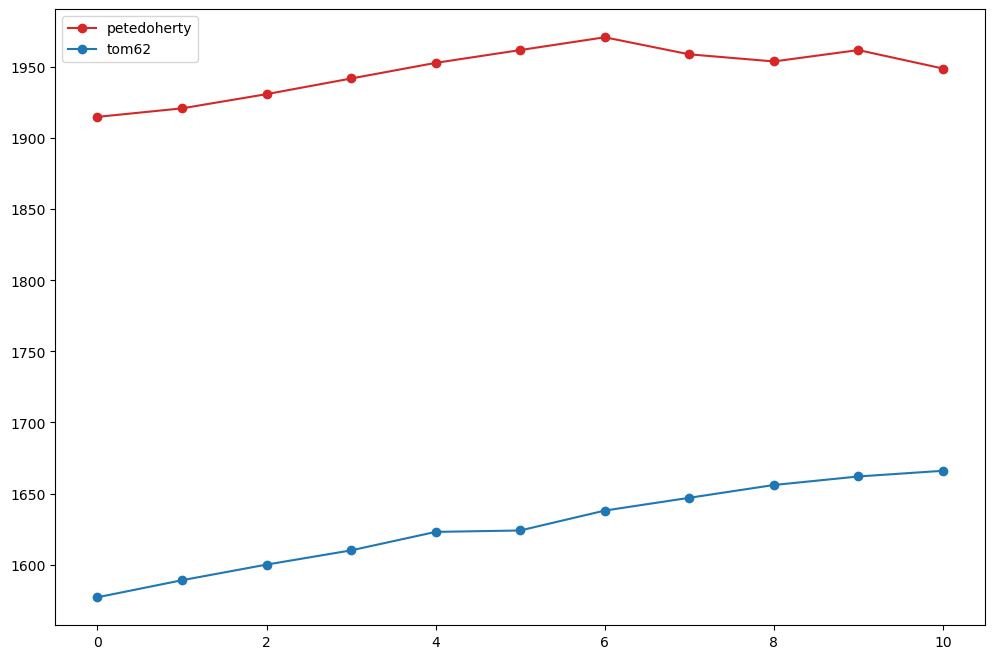

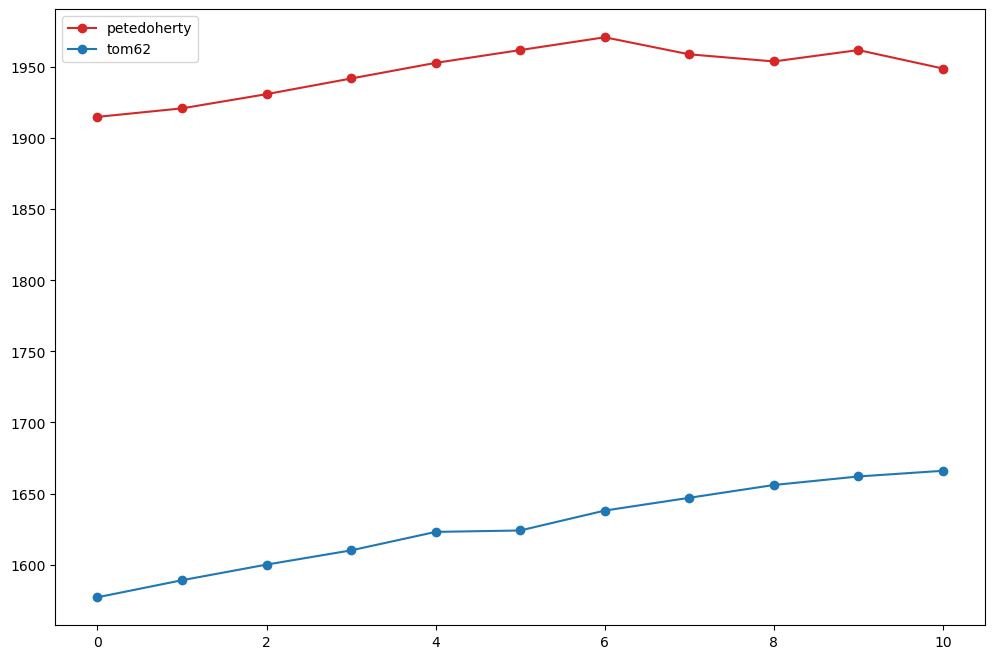

In [53]:
# Distance matrix
N = w.shape[0]
M = z.shape[0]
dist_mat = np.zeros((N, M))
for i in range(N):
    for j in range(M):
        dist_mat[i, j] = abs(x[i] - y[j])


Alignment cost: 3527.0000
Normalized alignment cost: 160.3182


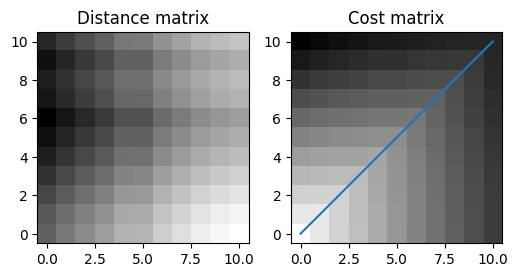

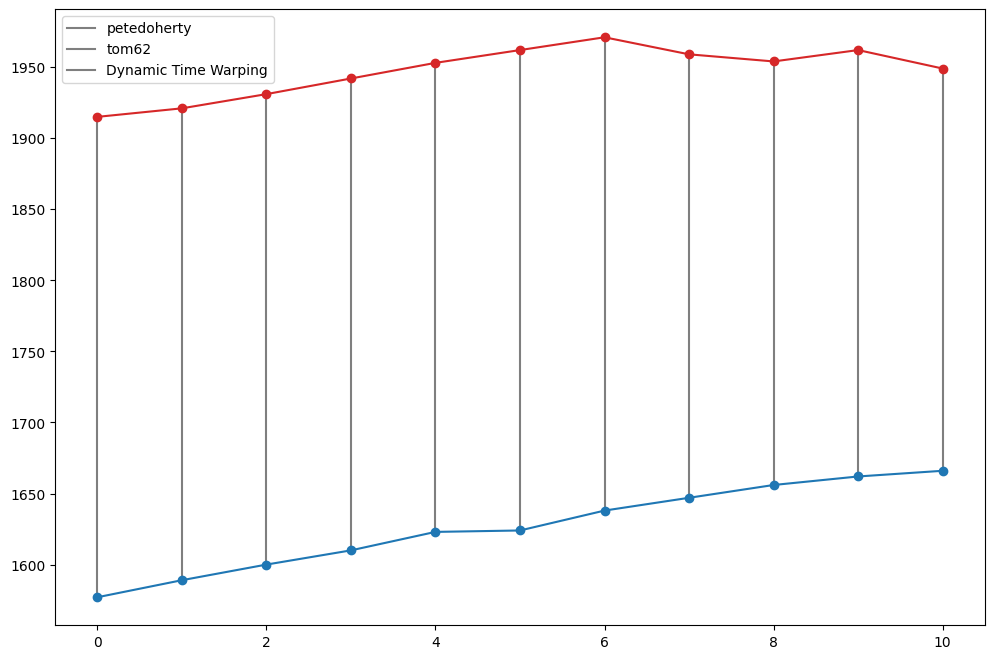

In [54]:


# DTW
path, cost_mat = dp(dist_mat)
print("Alignment cost: {:.4f}".format(cost_mat[N - 1, M - 1]))
print("Normalized alignment cost: {:.4f}".format(cost_mat[N - 1, M - 1]/(N + M)))

plt.figure(figsize=(6, 4))
plt.subplot(121)
plt.title("Distance matrix")
plt.imshow(dist_mat, cmap=plt.cm.binary, interpolation="nearest", origin="lower")
plt.subplot(122)
plt.title("Cost matrix")
plt.imshow(cost_mat, cmap=plt.cm.binary, interpolation="nearest", origin="lower")
x_path, y_path = zip(*path)
plt.plot(y_path, x_path);

plt.figure(figsize=(12, 8))
for x_i, y_j in path:
    plt.plot([x_i, y_j], [w[x_i], z[y_j]], c="C7")
plt.plot(np.arange(w.shape[0]), w, "-o", c="C3")
plt.plot(np.arange(z.shape[0]), z, "-o", c="C0")
plt.legend([w.name, z.name, "Dynamic Time Warping"]);

#### dtw & normalized & wcsss

In [ ]:
# dtw
wcss=kmeans_wcsss(X_train,"dtw",20)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,20),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

K = 2. Took 83.14 seconds to calculate.
K = 3. Took 82.89 seconds to calculate.
K = 4. Took 230.98 seconds to calculate.


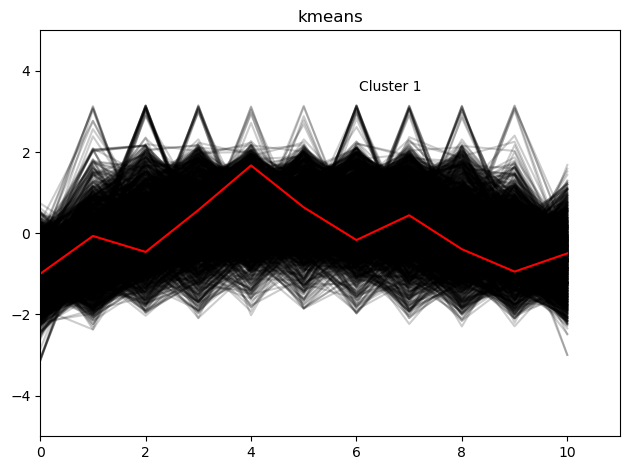

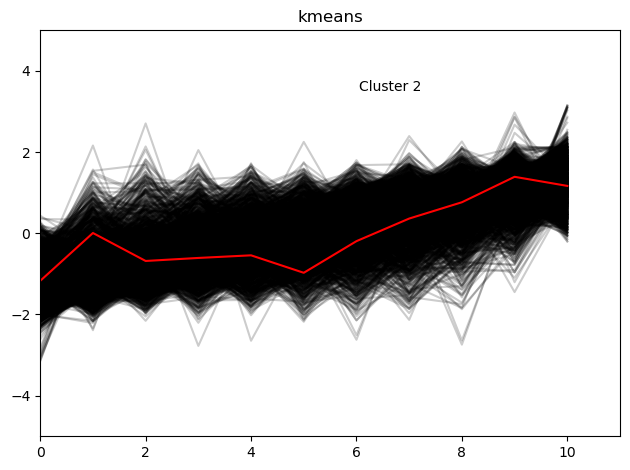

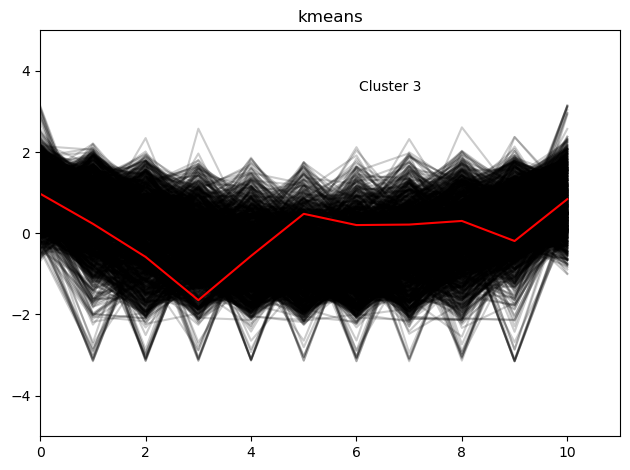

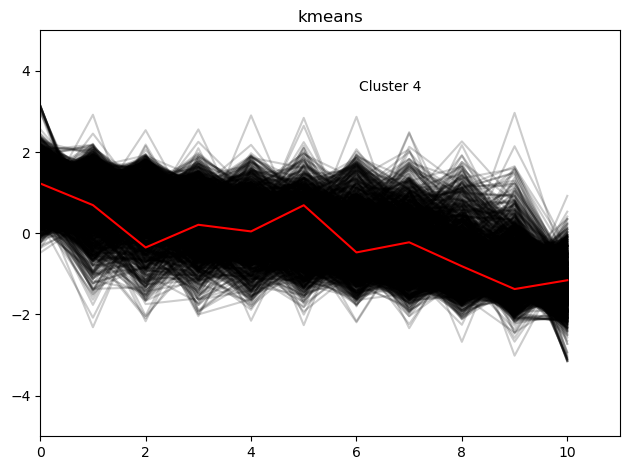

The 22.33% of the observations fall into Cluster 1
The 28.45% of the observations fall into Cluster 2
The 20.18% of the observations fall into Cluster 3
The 29.04% of the observations fall into Cluster 4


array([0, 1, 0, ..., 2, 1, 2])

In [162]:
kmeans_cluster(4,"kmeans_dtw",X_train,"dtw")

#### softdtw & normalized  & wcsss

In [ ]:
# softdtw
wcss=kmeans_wcsss(X_train,"softdtw",20)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,20),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

In [ ]:
kmeans_cluster(4,"kmeans_softdtw",X_train,"softdtw")

#### euclidean & normalized  & wcsss

K = 2. Took 2.11 seconds to calculate.
K = 3. Took 2.74 seconds to calculate.
K = 4. Took 8.25 seconds to calculate.
K = 5. Took 7.34 seconds to calculate.
K = 6. Took 8.32 seconds to calculate.
K = 7. Took 8.35 seconds to calculate.
K = 8. Took 9.04 seconds to calculate.
K = 9. Took 9.34 seconds to calculate.
K = 10. Took 9.26 seconds to calculate.
K = 11. Took 9.21 seconds to calculate.
K = 12. Took 7.40 seconds to calculate.
K = 13. Took 8.93 seconds to calculate.
K = 14. Took 9.13 seconds to calculate.
K = 15. Took 8.30 seconds to calculate.
K = 16. Took 8.86 seconds to calculate.
K = 17. Took 8.74 seconds to calculate.
K = 18. Took 8.33 seconds to calculate.
K = 19. Took 9.19 seconds to calculate.
K = 20. Took 9.25 seconds to calculate.
K = 21. Took 9.10 seconds to calculate.
K = 22. Took 9.10 seconds to calculate.
K = 23. Took 9.33 seconds to calculate.
K = 24. Took 9.28 seconds to calculate.
K = 25. Took 8.52 seconds to calculate.
K = 26. Took 8.36 seconds to calculate.
K = 27. 

Text(0.5, 1.0, 'WCSSS analysis For Optimal K and Optimal Model')

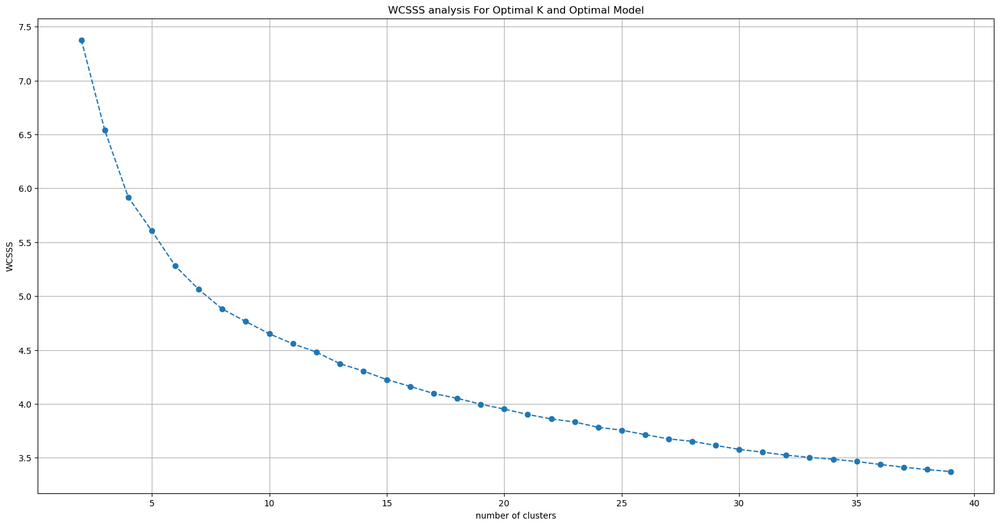

In [175]:
# dtw
wcss=kmeans_wcsss(X_train,"euclidean",40)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,40),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

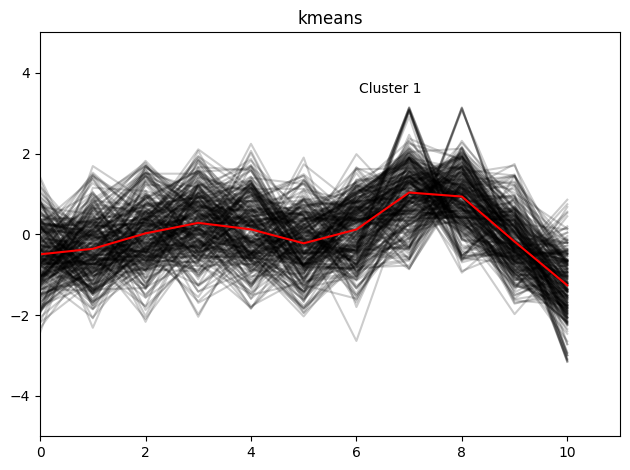

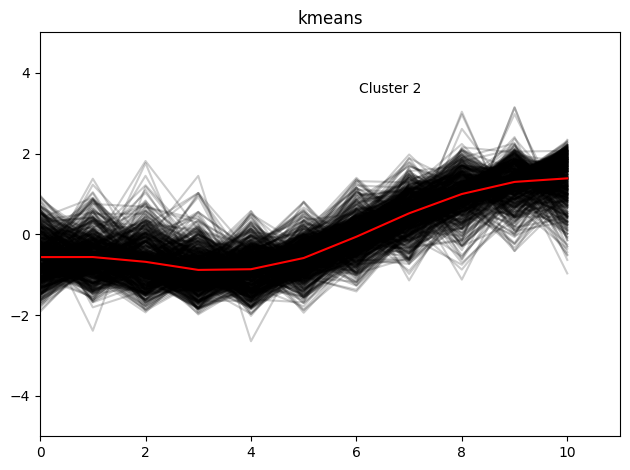

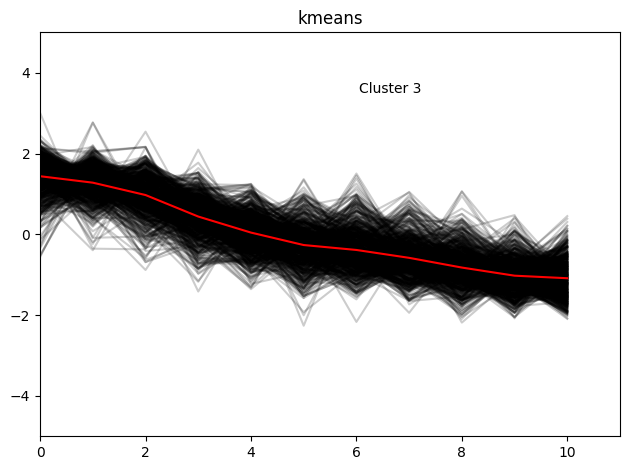

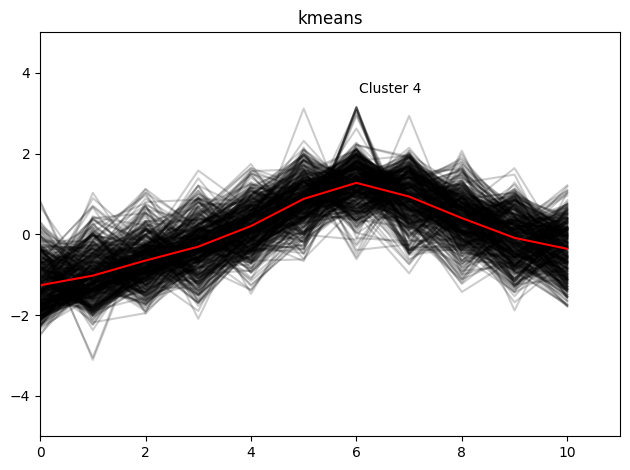

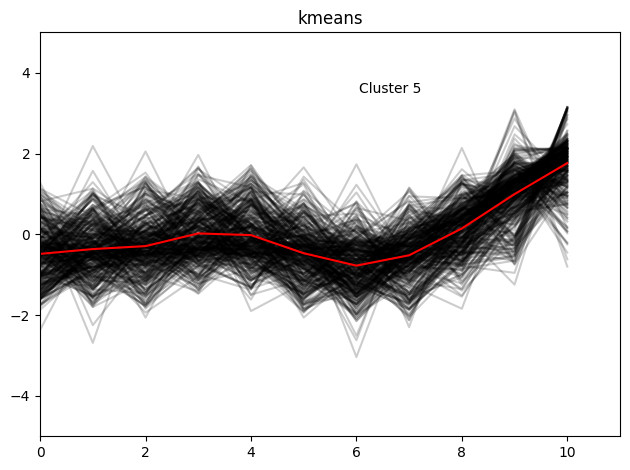

...

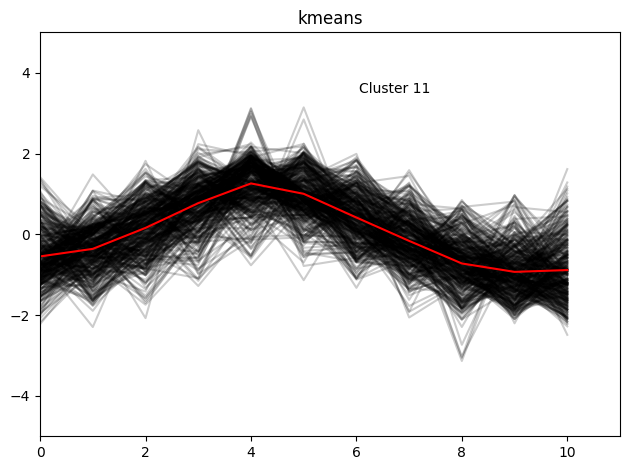

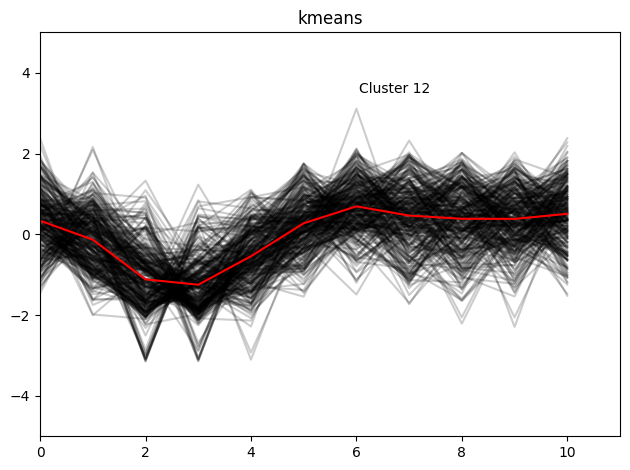

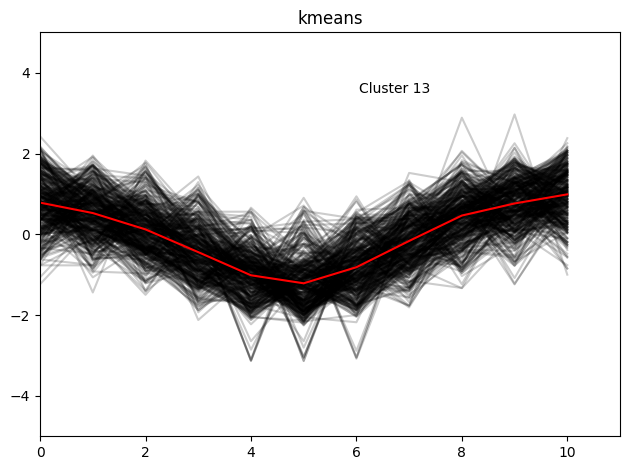

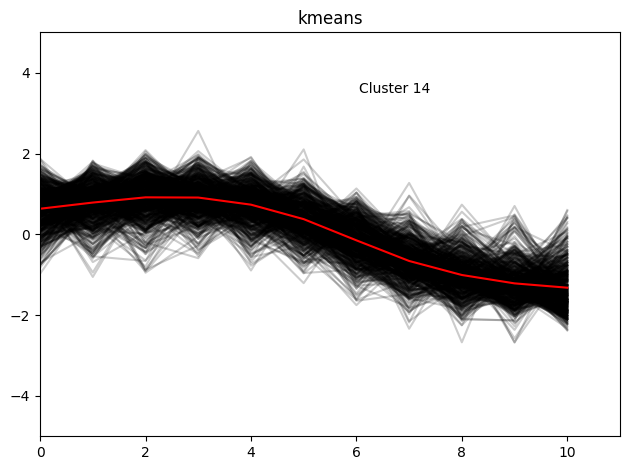

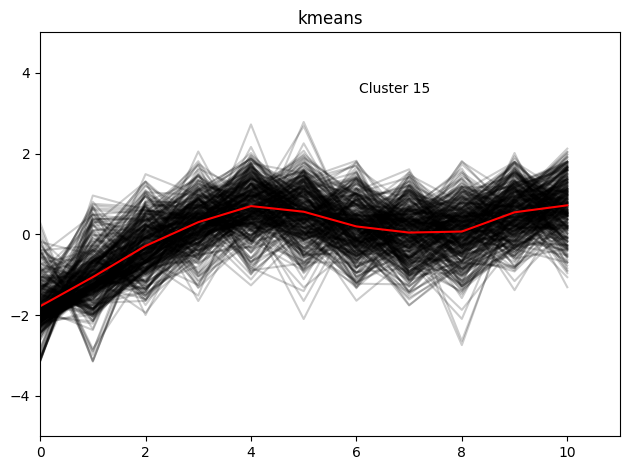

The 3.96% of the observations fall into Cluster 1
The 9.33% of the observations fall into Cluster 2
The 10.75% of the observations fall into Cluster 3
The 6.31% of the observations fall into Cluster 4
The 5.13% of the observations fall into Cluster 5
The 4.68% of the observations fall into Cluster 6
The 12.42% of the observations fall into Cluster 7
The 6.85% of the observations fall into Cluster 8
The 5.35% of the observations fall into Cluster 9
The 4.66% of the observations fall into Cluster 10
The 5.80% of the observations fall into Cluster 11
The 4.55% of the observations fall into Cluster 12
The 5.81% of the observations fall into Cluster 13
The 8.87% of the observations fall into Cluster 14
The 5.53% of the observations fall into Cluster 15


In [135]:
labels=kmeans_cluster(15,"kmeans_euclidean_10",X_train,"euclidean")

In [ ]:
!pip install statsmodels

Defaulting to user installation because normal site-packages is not writeable
DEPRECATION: Loading egg at /usr/local/lib/python3.11/site-packages/numpy-1.26.4-py3.11-linux-x86_64.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330
DEPRECATION: Loading egg at /usr/local/lib/python3.11/site-packages/face_recognition-1.4.0-py3.11.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330
DEPRECATION: Loading egg at /usr/local/lib/python3.11/site-packages/dlib-19.24.2-py3.11-linux-x86_64.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330
DEPRECATION: Loading egg at /usr/l

In [136]:
df["kmeans_euclidean_label"]=labels

In [137]:
df[df["kmeans_euclidean_label"]==14]

,0,1,2,3,4,5,6,7,8,9,10,kmeans_euclidean_label
sniperchess,2147,2159,2165,2172,2182,2192,2180,2185,2190,2185,2178,14
Cybernoid,1429,1438,1435,1452,1459,1465,1449,1460,1457,1450,1458,14
srinathreddy,1510,1530,1542,1534,1549,1541,1532,1546,1537,1535,1531,14
username999,1568,1577,1583,1588,1601,1588,1598,1588,1574,1582,1591,14
brida7,1495,1505,1515,1509,1503,1514,1509,1505,1496,1510,1523,14
...,...,...,...,...,...,...,...,...,...,...,...,...
koga86,1792,1787,1806,1820,1810,1812,1810,1804,1820,1820,1806,14
Victorfuentealba,1160,1177,1183,1207,1218,1217,1212,1209,1197,1218,1216,14
papartis,1993,2002,2010,2016,2020,2010,2001,2006,2012,2022,2014,14
Aldmuo,2231,2243,2252,2261,2271,2269,2256,2266,2253,2262,2271,14


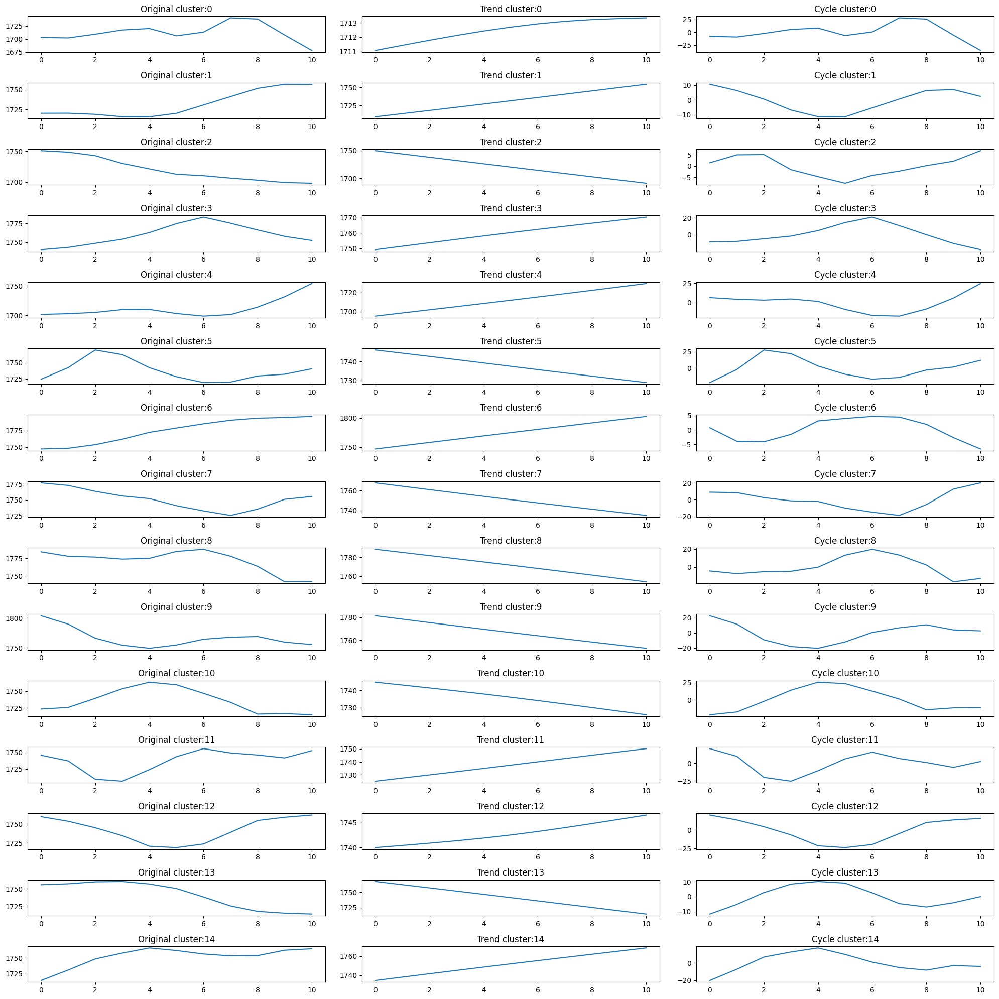

In [263]:
def get_samples(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        v=players_dict[p]
        samples[p]=list(v[(v.index<=offset+num_samples)&(v.index>=offset)]["Elo"])
            
    return samples

def get_samples_dates(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        v=players_dict[p]
        samples[p]=list(v[(v.index<=offset+num_samples)&(v.index>=offset)]["Timestamp"])
            
    return samples


players_names=list(df.index)
df=pd.DataFrame.from_dict(get_samples(players_dict,50,10)).T
df["kmeans_euclidean_label"]=labels
plt.figure(figsize=(20, 20))

for l in list(set(labels)):
    centroii=np.mean(df[df["kmeans_euclidean_label"]==l][[i for i in range(0,11)]], axis=0)
    y=centroii.values.reshape(-1, 1) 
    X=np.array(list(range(len(y)))).reshape(-1, 1) 
    cycle, trend = sm.tsa.filters.hpfilter(y, lamb=1600)
    plt.subplot(15,  3,(3*l)+1) 
    plt.plot(y, label='Original')
    plt.title(f'Original cluster:{l}')
    plt.subplot(15,  3,(3*l)+2) 
    plt.plot(trend, label='Trend')
    plt.title(f'Trend cluster:{l}')
    plt.subplot(15,  3,(3*l)+3) 
    plt.plot(cycle, label='Cycle')
    plt.title(f'Cycle cluster:{l}')
plt.tight_layout()
plt.show()

In [ ]:
plot_centriod(df,4)

In [201]:
import statsmodels.api as sm

In [214]:
cycle, trend = sm.tsa.filters.hpfilter(y, lamb=1600)

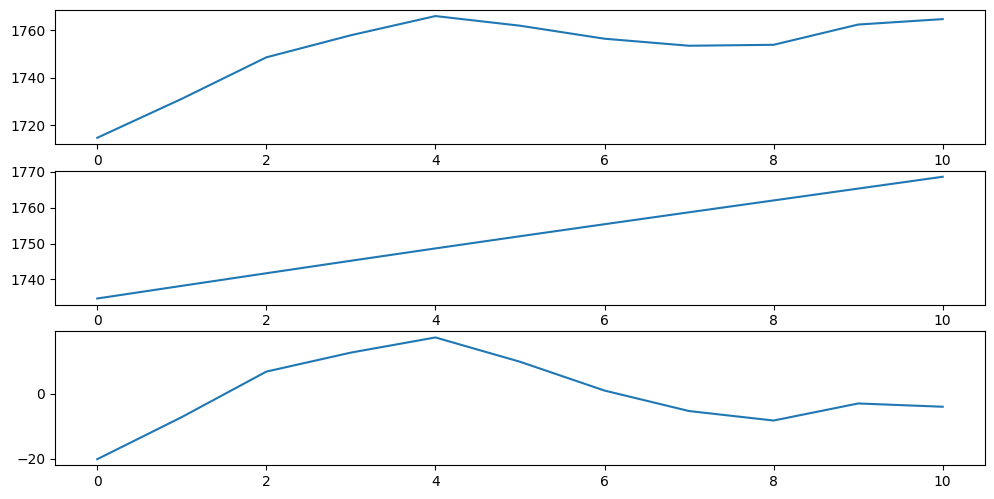

In [215]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))
plt.subplot(411)
plt.plot(y, label='Original')
plt.subplot(412)
plt.plot(trend, label='Trend')
plt.subplot(413)
plt.plot(cycle,label='Cycle')




In [ ]:
kmeans_cluster(4,"kmeans_euclidean",X)

In [267]:
df=pd.DataFrame.from_dict(get_samples(players_dict,50,25)).T

%%time

# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values 
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization 
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)



UsageError: Line magic function `%%time` not found.


In [279]:
df

,0,1,2,3,4,5,6,7,8,9,...,142,143,144,145,146,147,148,149,150,kmeans_euclidean_label
petedoherty,1915,1921,1931,1942,1953,1962,1971,1959,1954,1962,...,1980,1971,1980,1986,1972,1962,1975,1963,1949,3
tom62,1577,1589,1600,1610,1623,1624,1638,1647,1656,1662,...,1617,1612,1621,1613,1624,1637,1628,1615,1607,6
dachampChi,1505,1519,1510,1527,1517,1531,1545,1539,1532,1527,...,1531,1520,1529,1517,1506,1499,1514,1525,1533,3
sniperchess,2147,2159,2165,2172,2182,2192,2180,2185,2190,2185,...,2171,2155,2160,2142,2130,2137,2142,2132,2122,14
Analitico,1944,1956,1968,1978,1978,1988,1998,2006,2013,2025,...,2038,2027,2021,2015,2029,2022,2034,2023,2016,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Eric_1380,1596,1586,1597,1600,1586,1573,1585,1595,1600,1589,...,1632,1616,1603,1592,1605,1596,1603,1600,1588,12
TPC,1559,1569,1587,1605,1620,1633,1622,1612,1608,1605,...,1504,1497,1490,1507,1499,1484,1482,1491,1500,3
jopsyc,1208,1197,1187,1206,1198,1191,1209,1206,1198,1211,...,1302,1298,1298,1284,1290,1282,1276,1270,1264,4
carlosalemao,1432,1428,1426,1435,1430,1422,1431,1449,1442,1455,...,1472,1466,1477,1488,1495,1510,1522,1505,1518,1


In [269]:
# dtw
wcss=kmeans_wcsss(X_train,"euclidean",40)
plt.figure(figsize=(20,10))
plt.grid()
plt.plot(range(2,40),wcss,marker='o',linestyle='--')
plt.xlabel('number of clusters')
plt.ylabel('WCSSS');
plt.title("WCSSS analysis For Optimal K and Optimal Model")

KeyboardInterrupt: 

,0,1,2,3,4,5,6,7,8,9,...,16,17,18,19,20,21,22,23,24,25
petedoherty,-2.387206,-2.078413,-1.563759,-0.997638,-0.431518,0.031671,0.494860,-0.122725,-0.380053,0.031671,...,-0.277122,0.237533,0.700722,1.060981,0.340464,-0.225656,0.597791,1.163912,1.730032,2.038825
tom62,-2.439941,-2.069498,-1.729924,-1.421221,-1.019907,-0.989037,-0.556853,-0.279020,-0.001187,0.184035,...,0.616219,0.986662,0.924922,1.110144,0.647089,0.832311,0.616219,0.955792,0.585348,0.832311
dachampChi,-0.542398,0.096543,-0.314205,0.461653,0.005266,0.644208,1.283149,1.009317,0.689846,0.461653,...,1.146233,0.507292,0.233459,-0.314205,-0.770592,-1.135701,-1.455172,-1.774643,-1.957198,-2.322307
sniperchess,-2.237319,-1.189206,-0.665149,-0.053749,0.819679,1.693106,0.644993,1.081707,1.518421,1.081707,...,-1.014520,-0.490463,0.033593,-1.451234,-0.839835,-0.141092,0.732336,1.343735,-0.053749,-1.189206
Analitico,-2.390943,-2.008784,-1.626625,-1.308160,-1.308160,-0.989694,-0.671228,-0.416455,-0.193529,0.188630,...,0.634482,0.984794,1.303260,0.857408,1.080334,0.634482,0.538942,0.188630,0.538942,0.793715


,0,1,2,3,4,5,6,7,8,9,...,16,17,18,19,20,21,22,23,24,25
petedoherty,0.000000,0.069767,0.186047,0.313953,0.441860,0.546512,0.651163,0.511628,0.453488,0.546512,...,0.476744,0.593023,0.697674,0.779070,0.616279,0.488372,0.674419,0.802326,0.930233,1.000000
tom62,0.000000,0.104348,0.200000,0.286957,0.400000,0.408696,0.530435,0.608696,0.686957,0.739130,...,0.860870,0.965217,0.947826,1.000000,0.869565,0.921739,0.860870,0.956522,0.852174,0.921739
dachampChi,0.493671,0.670886,0.556962,0.772152,0.645570,0.822785,1.000000,0.924051,0.835443,0.772152,...,0.962025,0.784810,0.708861,0.556962,0.430380,0.329114,0.240506,0.151899,0.101266,0.000000
sniperchess,0.000000,0.266667,0.400000,0.555556,0.777778,1.000000,0.733333,0.844444,0.955556,0.844444,...,0.311111,0.444444,0.577778,0.200000,0.355556,0.533333,0.755556,0.911111,0.555556,0.266667
Analitico,0.000000,0.103448,0.206897,0.293103,0.293103,0.379310,0.465517,0.534483,0.594828,0.698276,...,0.818966,0.913793,1.000000,0.879310,0.939655,0.818966,0.793103,0.698276,0.793103,0.862069


(6798, 26, 1) (6798, 26, 1)


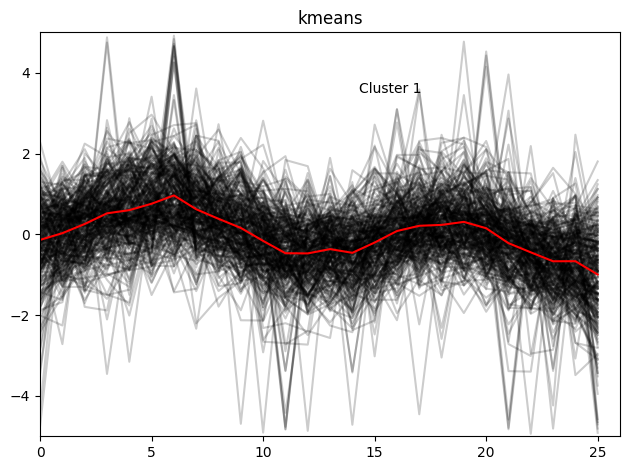

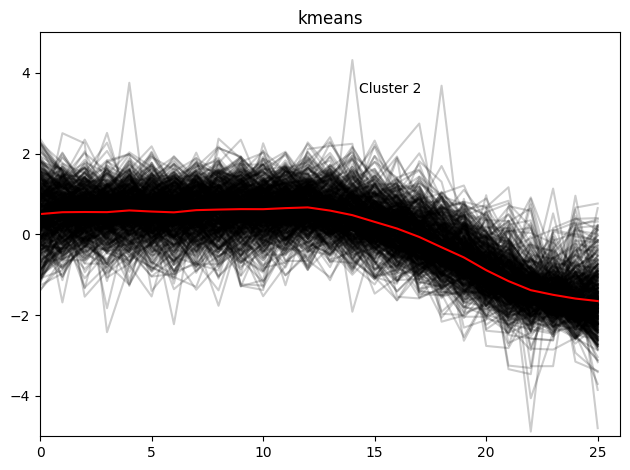

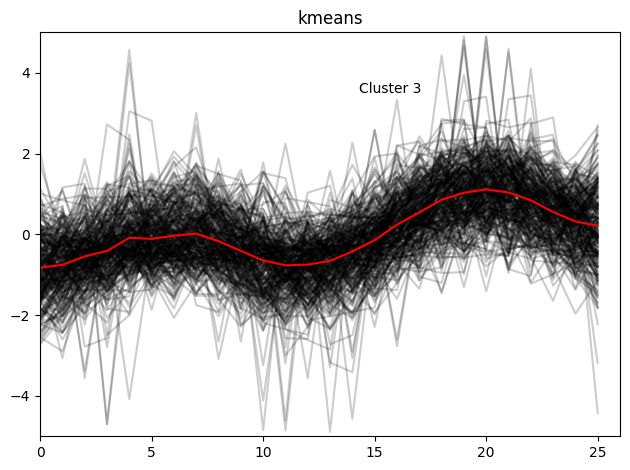

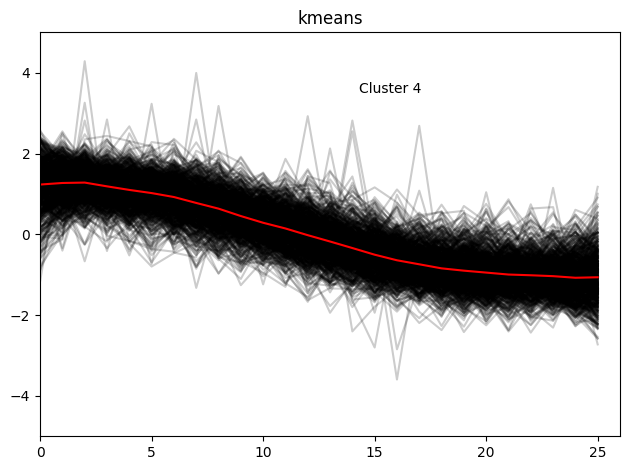

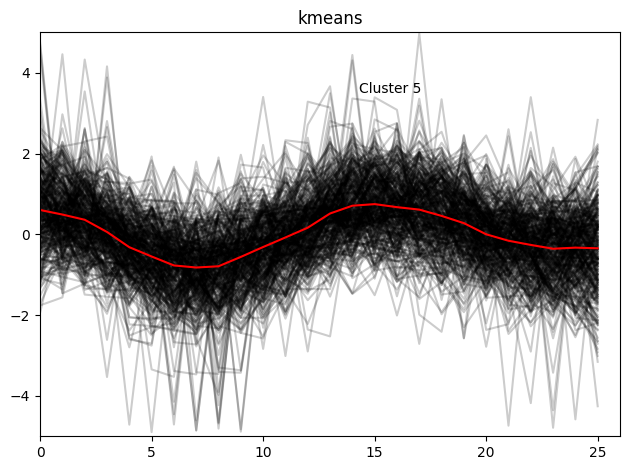

...

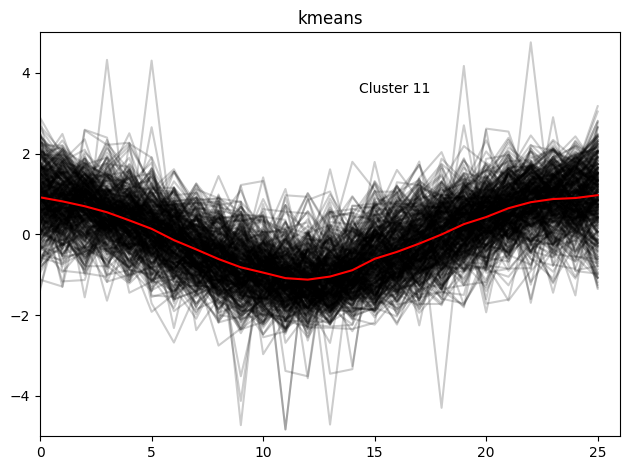

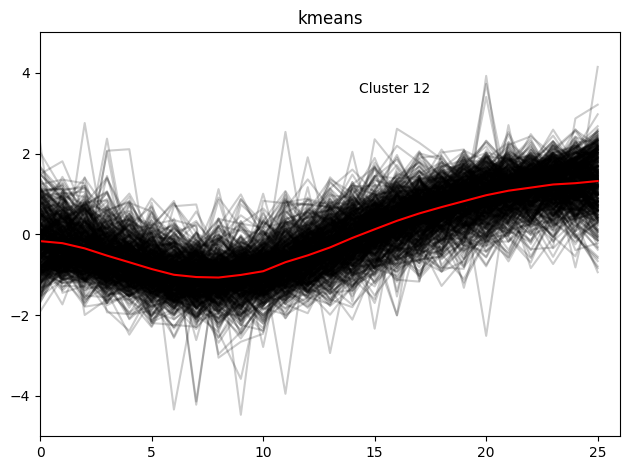

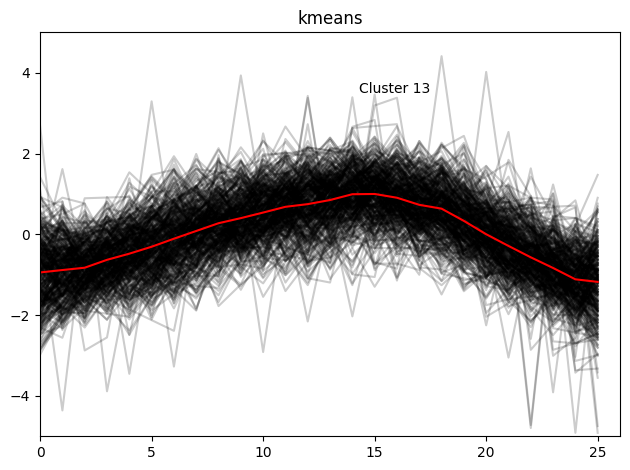

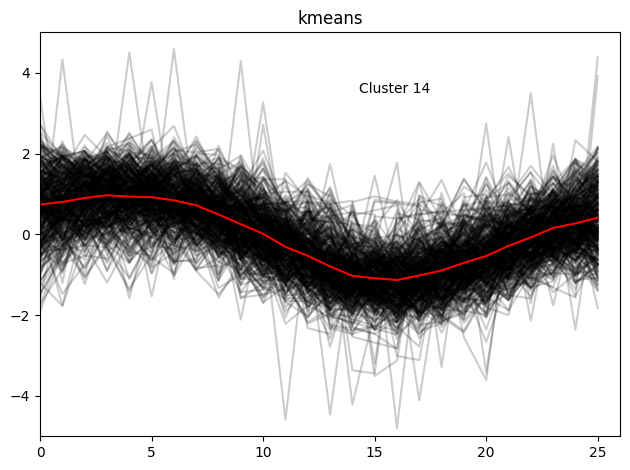

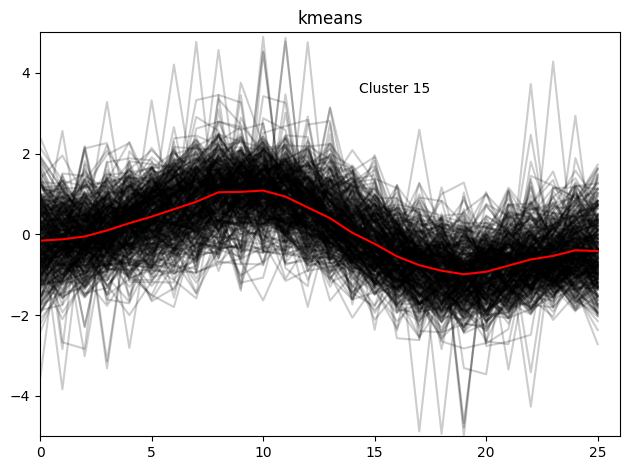

The 4.10% of the observations fall into Cluster 1
The 8.33% of the observations fall into Cluster 2
The 4.32% of the observations fall into Cluster 3
The 11.21% of the observations fall into Cluster 4
The 5.25% of the observations fall into Cluster 5
The 9.31% of the observations fall into Cluster 6
The 5.24% of the observations fall into Cluster 7
The 5.90% of the observations fall into Cluster 8
The 5.69% of the observations fall into Cluster 9
The 8.78% of the observations fall into Cluster 10
The 5.96% of the observations fall into Cluster 11
The 8.22% of the observations fall into Cluster 12
The 5.77% of the observations fall into Cluster 13
The 6.08% of the observations fall into Cluster 14
The 5.84% of the observations fall into Cluster 15


In [272]:
df=pd.DataFrame.from_dict(get_samples(players_dict,50,25)).T


# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values 
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization 
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)



label=kmeans_cluster(15,"kmeans_euclidean_25",X_train,"euclidean")

,0,1,2,3,4,5,6,7,8,9,...,16,17,18,19,20,21,22,23,24,25
petedoherty,-2.387206,-2.078413,-1.563759,-0.997638,-0.431518,0.031671,0.494860,-0.122725,-0.380053,0.031671,...,-0.277122,0.237533,0.700722,1.060981,0.340464,-0.225656,0.597791,1.163912,1.730032,2.038825
tom62,-2.439941,-2.069498,-1.729924,-1.421221,-1.019907,-0.989037,-0.556853,-0.279020,-0.001187,0.184035,...,0.616219,0.986662,0.924922,1.110144,0.647089,0.832311,0.616219,0.955792,0.585348,0.832311
dachampChi,-0.542398,0.096543,-0.314205,0.461653,0.005266,0.644208,1.283149,1.009317,0.689846,0.461653,...,1.146233,0.507292,0.233459,-0.314205,-0.770592,-1.135701,-1.455172,-1.774643,-1.957198,-2.322307
sniperchess,-2.237319,-1.189206,-0.665149,-0.053749,0.819679,1.693106,0.644993,1.081707,1.518421,1.081707,...,-1.014520,-0.490463,0.033593,-1.451234,-0.839835,-0.141092,0.732336,1.343735,-0.053749,-1.189206
Analitico,-2.390943,-2.008784,-1.626625,-1.308160,-1.308160,-0.989694,-0.671228,-0.416455,-0.193529,0.188630,...,0.634482,0.984794,1.303260,0.857408,1.080334,0.634482,0.538942,0.188630,0.538942,0.793715


,0,1,2,3,4,5,6,7,8,9,...,16,17,18,19,20,21,22,23,24,25
petedoherty,0.000000,0.069767,0.186047,0.313953,0.441860,0.546512,0.651163,0.511628,0.453488,0.546512,...,0.476744,0.593023,0.697674,0.779070,0.616279,0.488372,0.674419,0.802326,0.930233,1.000000
tom62,0.000000,0.104348,0.200000,0.286957,0.400000,0.408696,0.530435,0.608696,0.686957,0.739130,...,0.860870,0.965217,0.947826,1.000000,0.869565,0.921739,0.860870,0.956522,0.852174,0.921739
dachampChi,0.493671,0.670886,0.556962,0.772152,0.645570,0.822785,1.000000,0.924051,0.835443,0.772152,...,0.962025,0.784810,0.708861,0.556962,0.430380,0.329114,0.240506,0.151899,0.101266,0.000000
sniperchess,0.000000,0.266667,0.400000,0.555556,0.777778,1.000000,0.733333,0.844444,0.955556,0.844444,...,0.311111,0.444444,0.577778,0.200000,0.355556,0.533333,0.755556,0.911111,0.555556,0.266667
Analitico,0.000000,0.103448,0.206897,0.293103,0.293103,0.379310,0.465517,0.534483,0.594828,0.698276,...,0.818966,0.913793,1.000000,0.879310,0.939655,0.818966,0.793103,0.698276,0.793103,0.862069


(6798, 26, 1) (6798, 26, 1)


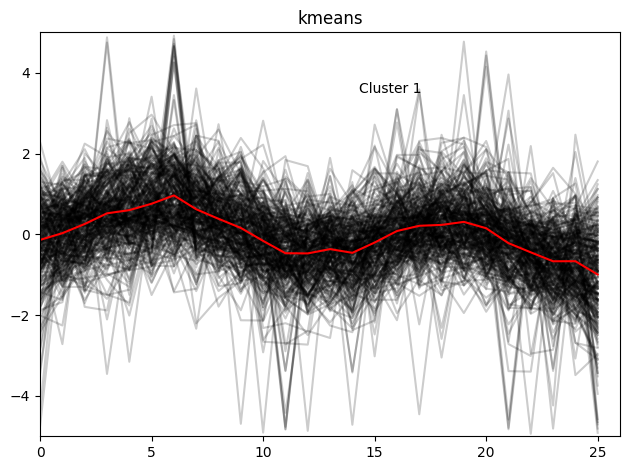

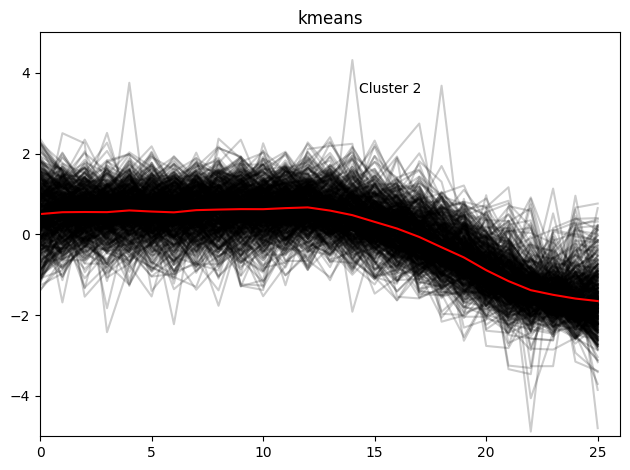

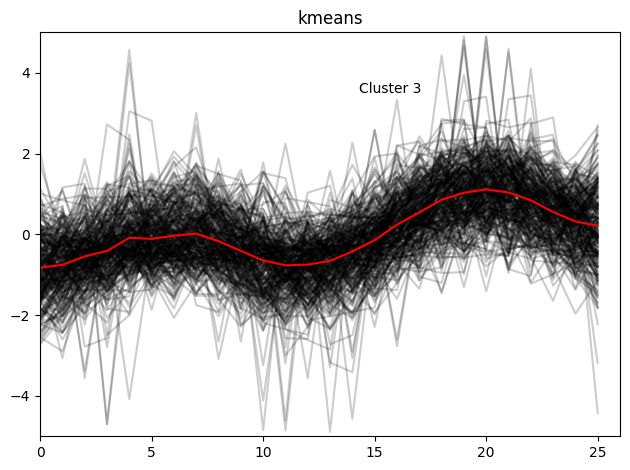

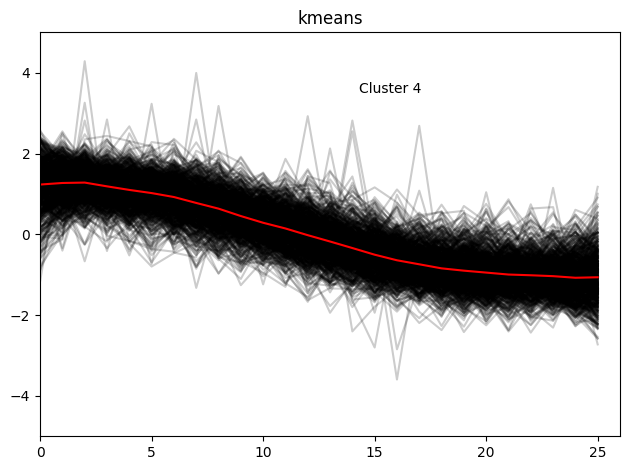

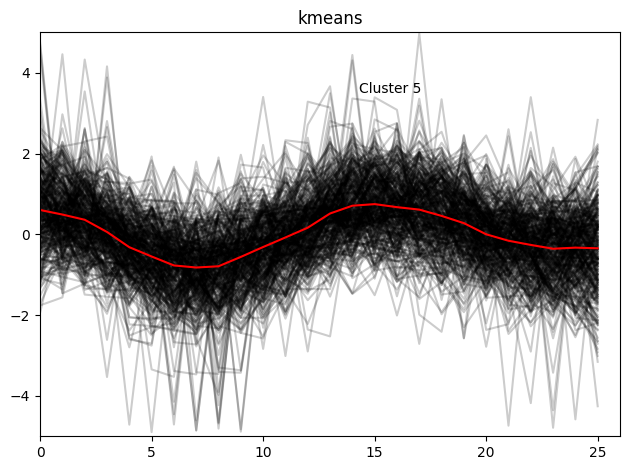

...

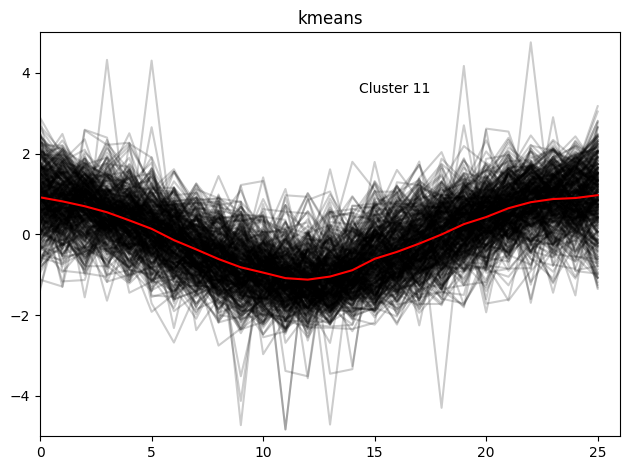

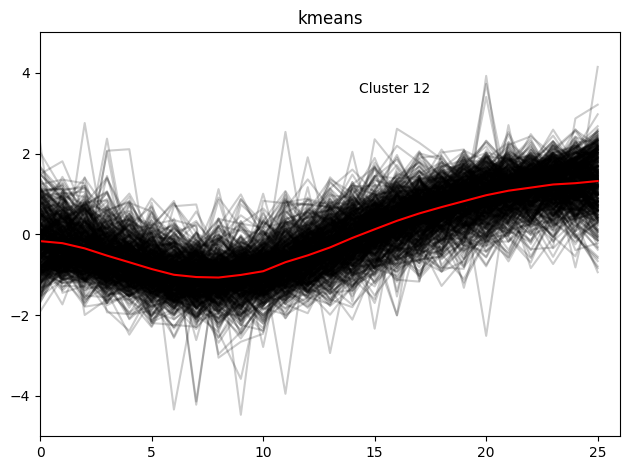

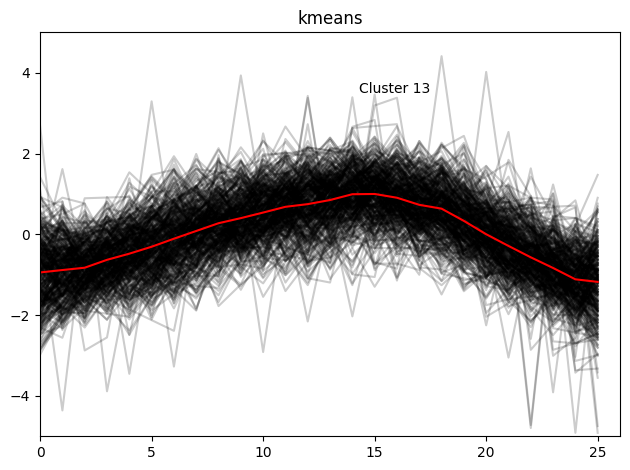

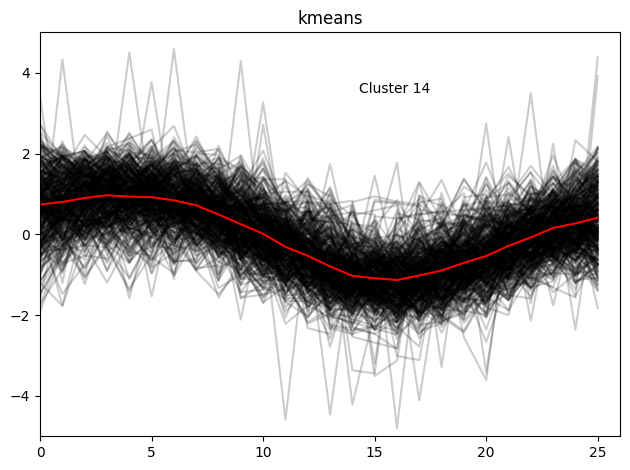

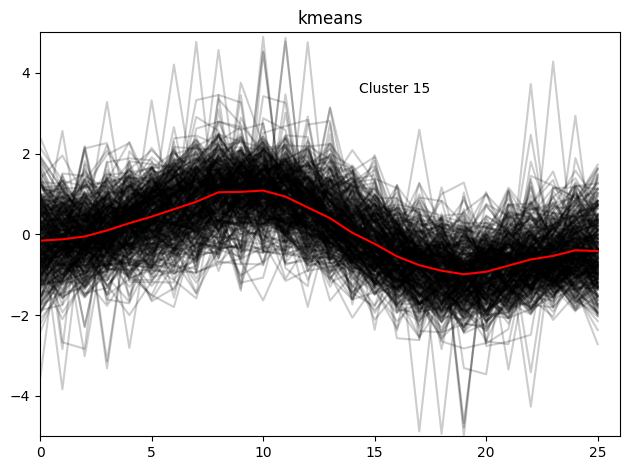

The 4.10% of the observations fall into Cluster 1
The 8.33% of the observations fall into Cluster 2
The 4.32% of the observations fall into Cluster 3
The 11.21% of the observations fall into Cluster 4
The 5.25% of the observations fall into Cluster 5
The 9.31% of the observations fall into Cluster 6
The 5.24% of the observations fall into Cluster 7
The 5.90% of the observations fall into Cluster 8
The 5.69% of the observations fall into Cluster 9
The 8.78% of the observations fall into Cluster 10
The 5.96% of the observations fall into Cluster 11
The 8.22% of the observations fall into Cluster 12
The 5.77% of the observations fall into Cluster 13
The 6.08% of the observations fall into Cluster 14
The 5.84% of the observations fall into Cluster 15


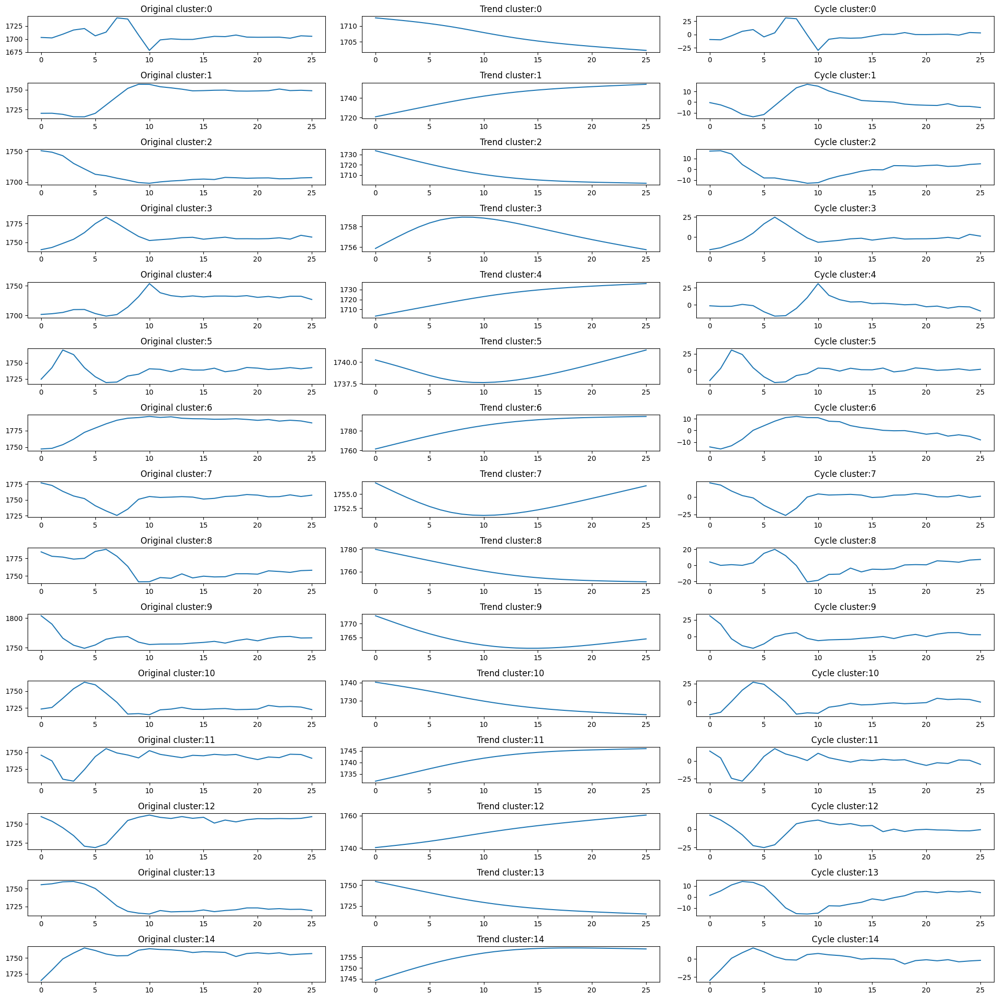

In [275]:
def get_samples(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        v=players_dict[p]
        samples[p]=list(v[(v.index<=offset+num_samples)&(v.index>=offset)]["Elo"])
            
    return samples

def get_samples_dates(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        v=players_dict[p]
        samples[p]=list(v[(v.index<=offset+num_samples)&(v.index>=offset)]["Timestamp"])
            
    return samples

W=25

df=pd.DataFrame.from_dict(get_samples(players_dict,50,W)).T


# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values 
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization 
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)



label=kmeans_cluster(15,"kmeans_euclidean_25",X_train,"euclidean")


players_names=list(df.index)
df=pd.DataFrame.from_dict(get_samples(players_dict,50,W)).T
df["kmeans_euclidean_label"]=labels
plt.figure(figsize=(20, 20))

for l in list(set(labels)):
    centroii=np.mean(df[df["kmeans_euclidean_label"]==l][[i for i in range(0,W+1)]], axis=0)
    y=centroii.values.reshape(-1, 1) 
    X=np.array(list(range(len(y)))).reshape(-1, 1) 
    cycle, trend = sm.tsa.filters.hpfilter(y, lamb=1600)
    plt.subplot(15,  3,(3*l)+1) 
    plt.plot(y, label='Original')
    plt.title(f'Original cluster:{l}')
    plt.subplot(15,  3,(3*l)+2) 
    plt.plot(trend, label='Trend')
    plt.title(f'Trend cluster:{l}')
    plt.subplot(15,  3,(3*l)+3) 
    plt.plot(cycle, label='Cycle')
    plt.title(f'Cycle cluster:{l}')
plt.tight_layout()
plt.show()

,0,1,2,3,4,5,6,7,8,9,...,41,42,43,44,45,46,47,48,49,50
petedoherty,-2.317065,-2.126622,-1.809215,-1.460069,-1.110922,-0.825256,-0.539591,-0.920478,-1.079181,-0.825256,...,0.793516,0.380887,0.698294,0.317406,0.539591,0.825256,1.015700,0.730034,0.952219,1.015700
tom62,-3.183257,-2.724328,-2.303644,-1.921203,-1.424030,-1.385786,-0.850368,-0.506172,-0.161975,0.067490,...,-0.200219,0.067490,0.449930,0.641151,0.029245,-0.429684,-0.773880,-1.194565,-0.697392,-0.429684
dachampChi,-0.867167,-0.354195,-0.683963,-0.061068,-0.427477,0.085495,0.598467,0.378622,0.122136,-0.061068,...,1.331285,0.964876,0.708390,1.074799,0.708390,0.305341,0.305341,0.561827,0.745031,0.488545
sniperchess,-0.991535,-0.261307,0.103807,0.529773,1.138297,1.746820,1.016592,1.320854,1.625116,1.320854,...,-1.660911,-1.234945,-0.565569,-0.261307,0.042955,0.773183,1.077444,0.103807,0.773183,0.164659
Analitico,-3.135740,-2.704585,-2.273429,-1.914133,-1.914133,-1.554837,-1.195541,-0.908104,-0.656596,-0.225441,...,0.996166,0.493152,0.026067,0.313504,0.636870,0.888378,1.283604,1.175815,1.535111,1.786618


,0,1,2,3,4,5,6,7,8,9,...,41,42,43,44,45,46,47,48,49,50
petedoherty,0.000000,0.046154,0.123077,0.207692,0.292308,0.361538,0.430769,0.338462,0.300000,0.361538,...,0.753846,0.653846,0.730769,0.638462,0.692308,0.761538,0.807692,0.738462,0.792308,0.807692
tom62,0.000000,0.101695,0.194915,0.279661,0.389831,0.398305,0.516949,0.593220,0.669492,0.720339,...,0.661017,0.720339,0.805085,0.847458,0.711864,0.610169,0.533898,0.440678,0.550847,0.610169
dachampChi,0.361111,0.490741,0.407407,0.564815,0.472222,0.601852,0.731481,0.675926,0.611111,0.564815,...,0.916667,0.824074,0.759259,0.851852,0.759259,0.657407,0.657407,0.722222,0.768519,0.703704
sniperchess,0.383562,0.547945,0.630137,0.726027,0.863014,1.000000,0.835616,0.904110,0.972603,0.904110,...,0.232877,0.328767,0.479452,0.547945,0.616438,0.780822,0.849315,0.630137,0.780822,0.643836
Analitico,0.000000,0.087591,0.175182,0.248175,0.248175,0.321168,0.394161,0.452555,0.503650,0.591241,...,0.839416,0.737226,0.642336,0.700730,0.766423,0.817518,0.897810,0.875912,0.948905,1.000000


(6798, 51, 1) (6798, 51, 1)


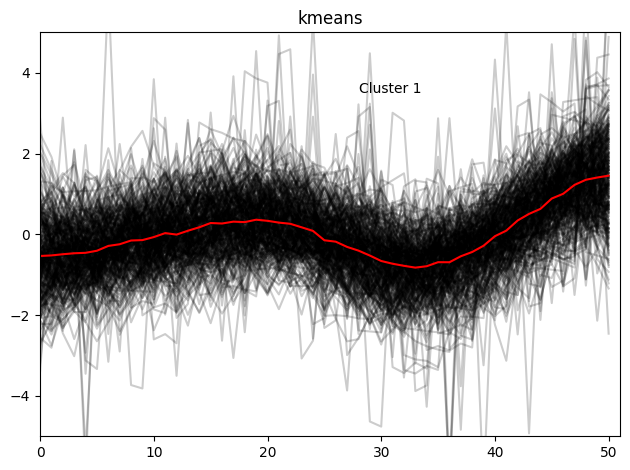

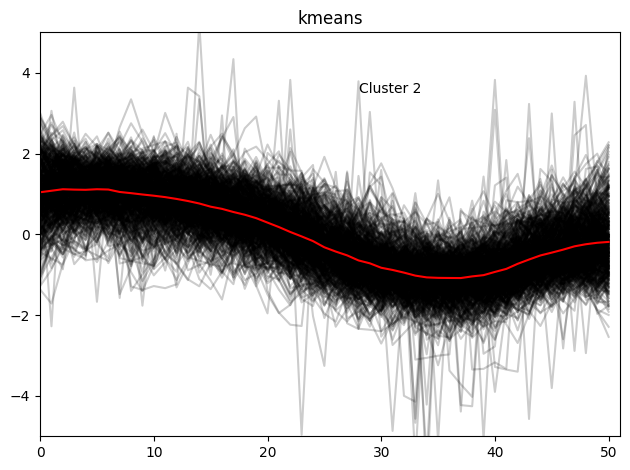

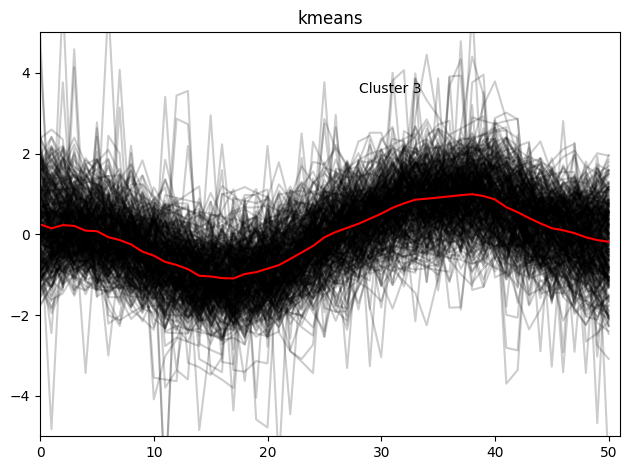

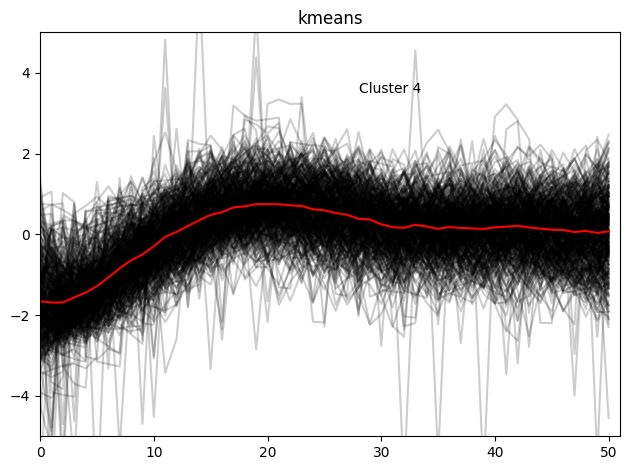

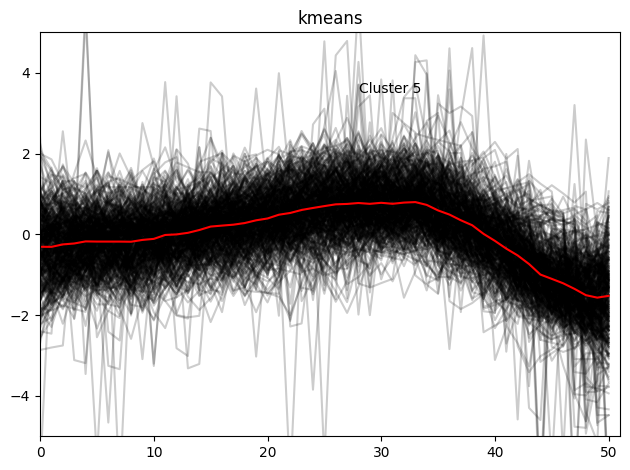

...

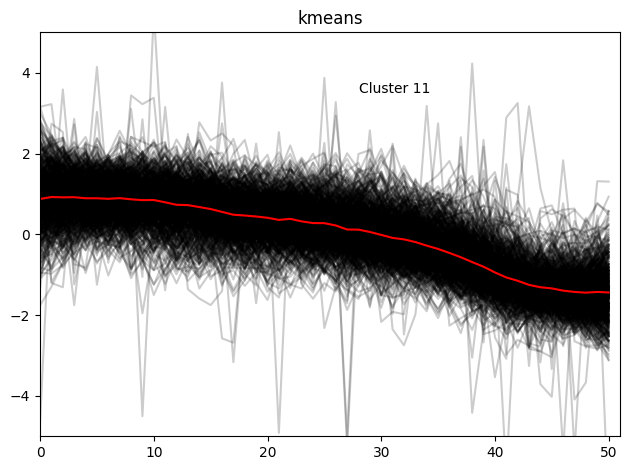

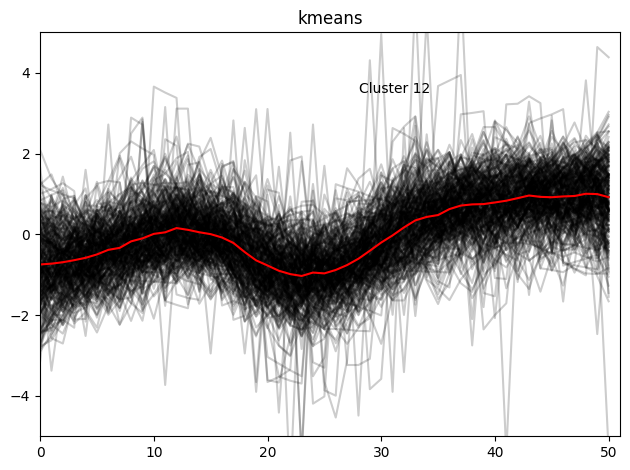

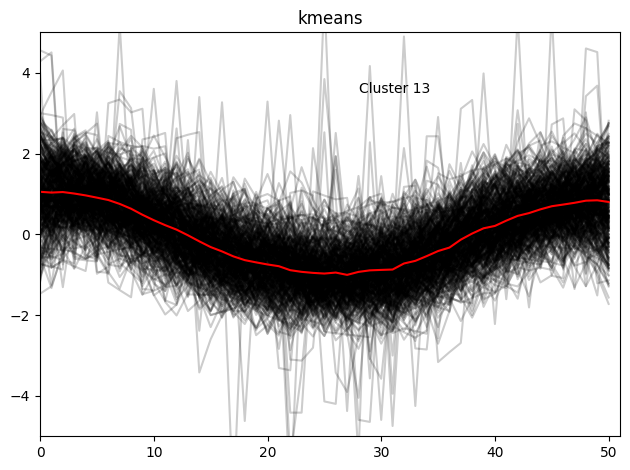

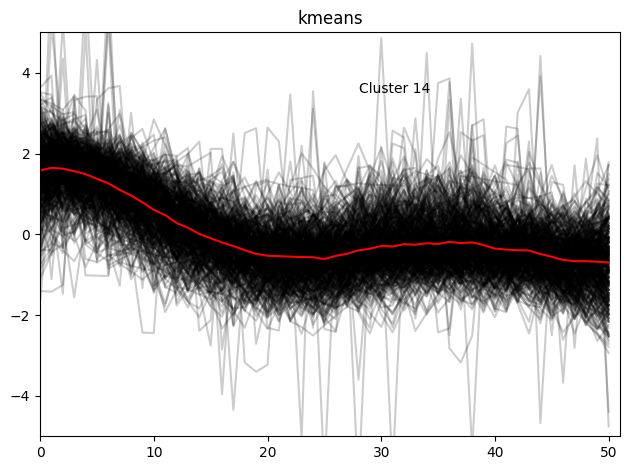

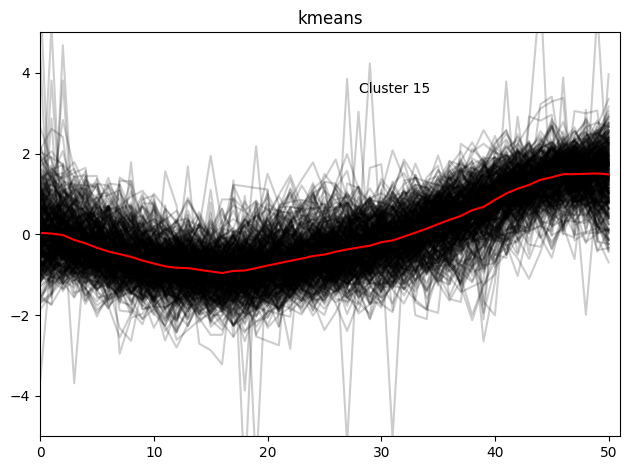

The 4.78% of the observations fall into Cluster 1
The 8.47% of the observations fall into Cluster 2
The 5.43% of the observations fall into Cluster 3
The 6.09% of the observations fall into Cluster 4
The 6.18% of the observations fall into Cluster 5
The 11.44% of the observations fall into Cluster 6
The 4.96% of the observations fall into Cluster 7
The 6.65% of the observations fall into Cluster 8
The 6.28% of the observations fall into Cluster 9
The 6.53% of the observations fall into Cluster 10
The 9.52% of the observations fall into Cluster 11
The 4.31% of the observations fall into Cluster 12
The 6.30% of the observations fall into Cluster 13
The 6.63% of the observations fall into Cluster 14
The 6.43% of the observations fall into Cluster 15


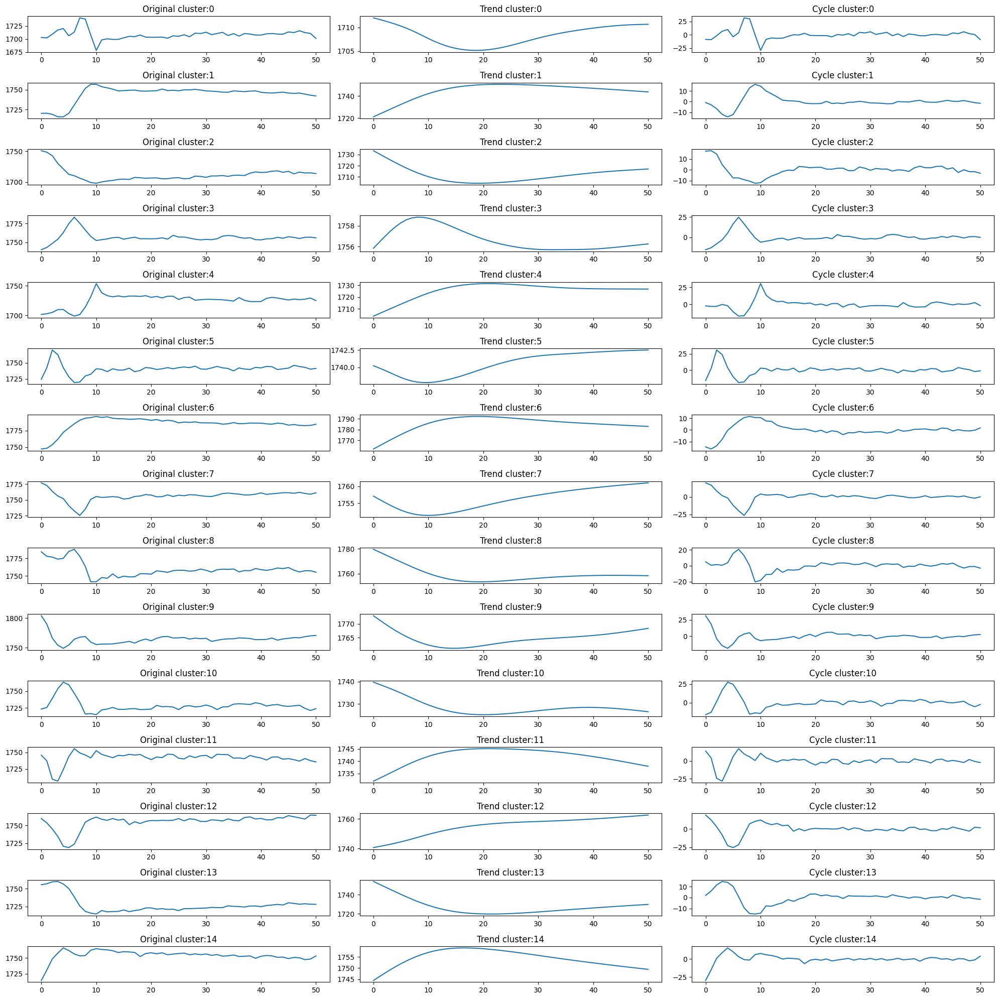

In [276]:
def get_samples(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        v=players_dict[p]
        samples[p]=list(v[(v.index<=offset+num_samples)&(v.index>=offset)]["Elo"])
            
    return samples

def get_samples_dates(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        v=players_dict[p]
        samples[p]=list(v[(v.index<=offset+num_samples)&(v.index>=offset)]["Timestamp"])
            
    return samples

W=50

df=pd.DataFrame.from_dict(get_samples(players_dict,50,W)).T


# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values 
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization 
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)



label=kmeans_cluster(15,"kmeans_euclidean_25",X_train,"euclidean")


players_names=list(df.index)
df=pd.DataFrame.from_dict(get_samples(players_dict,50,W)).T
df["kmeans_euclidean_label"]=labels
plt.figure(figsize=(20, 20))

for l in list(set(labels)):
    centroii=np.mean(df[df["kmeans_euclidean_label"]==l][[i for i in range(0,W+1)]], axis=0)
    y=centroii.values.reshape(-1, 1) 
    X=np.array(list(range(len(y)))).reshape(-1, 1) 
    cycle, trend = sm.tsa.filters.hpfilter(y, lamb=1600)
    plt.subplot(15,  3,(3*l)+1) 
    plt.plot(y, label='Original')
    plt.title(f'Original cluster:{l}')
    plt.subplot(15,  3,(3*l)+2) 
    plt.plot(trend, label='Trend')
    plt.title(f'Trend cluster:{l}')
    plt.subplot(15,  3,(3*l)+3) 
    plt.plot(cycle, label='Cycle')
    plt.title(f'Cycle cluster:{l}')
plt.tight_layout()
plt.show()

In [280]:
X_train

array([[[-2.27963557],
        [-2.13129471],
        [-1.88405994],
        ...,
        [-0.79622695],
        [-1.09290867],
        [-1.43903735]],

       [[-2.29235887],
        [-1.88077006],
        [-1.50348032],
        ...,
        [-0.54310643],
        [-0.98899431],
        [-1.26338685]],

       [[-1.30584249],
        [-0.66962423],
        [-1.07862168],
        ...,
        [-0.89684504],
        [-0.39695926],
        [-0.03340597]],

       ...,

       [[-0.76447156],
        [-0.94286258],
        [-1.10503623],
        ...,
        [ 0.33830927],
        [ 0.24100508],
        [ 0.14370089]],

       [[-1.34711557],
        [-1.48523436],
        [-1.55429376],
        ...,
        [ 1.76055725],
        [ 1.17355239],
        [ 1.62243846]],

       [[ 1.90637713],
        [ 1.81923689],
        [ 1.7224144 ],
        ...,
        [ 0.31848829],
        [ 0.43467527],
        [ 0.38626403]]])

,0,1,2,3,4,5,6,7,8,9,...,91,92,93,94,95,96,97,98,99,100
petedoherty,-2.670964,-2.509104,-2.239336,-1.942592,-1.645848,-1.403057,-1.160267,-1.483988,-1.618871,-1.403057,...,1.483454,1.213686,0.862989,1.105779,0.755082,0.404384,0.674151,0.323454,0.674151,0.970895
tom62,-2.598993,-2.163130,-1.763589,-1.400370,-0.928186,-0.891864,-0.383358,-0.056461,0.270436,0.488368,...,-1.037152,-1.291405,-0.782898,-1.473014,-1.618302,-1.981521,-2.199452,-2.381061,-2.816924,-2.308418
dachampChi,-1.087944,-0.461834,-0.864333,-0.104056,-0.551278,0.074832,0.700942,0.432609,0.119554,-0.104056,...,-1.624610,-1.132666,-0.372389,0.387887,0.566776,0.477331,0.298443,1.103442,0.879831,0.700942
sniperchess,0.082243,0.412306,0.577337,0.769874,1.044926,1.319978,0.989916,1.127442,1.264968,1.127442,...,-2.173185,-1.870628,-1.650586,-1.430544,-1.238007,-1.045471,0.467316,0.742369,-1.458049,-1.238007
Analitico,-3.177516,-2.834826,-2.492136,-2.206561,-2.206561,-1.920986,-1.635411,-1.406951,-1.207049,-0.864359,...,0.963321,0.649188,0.420728,0.734861,0.963321,1.191781,0.963321,0.934763,0.849091,0.620631


,0,1,2,3,4,5,6,7,8,9,...,91,92,93,94,95,96,97,98,99,100
petedoherty,0.000000,0.035714,0.095238,0.160714,0.226190,0.279762,0.333333,0.261905,0.232143,0.279762,...,0.916667,0.857143,0.779762,0.833333,0.755952,0.678571,0.738095,0.660714,0.738095,0.803571
tom62,0.048387,0.145161,0.233871,0.314516,0.419355,0.427419,0.540323,0.612903,0.685484,0.733871,...,0.395161,0.338710,0.451613,0.298387,0.266129,0.185484,0.137097,0.096774,0.000000,0.112903
dachampChi,0.361111,0.490741,0.407407,0.564815,0.472222,0.601852,0.731481,0.675926,0.611111,0.564815,...,0.250000,0.351852,0.509259,0.666667,0.703704,0.685185,0.648148,0.814815,0.768519,0.731481
sniperchess,0.619403,0.708955,0.753731,0.805970,0.880597,0.955224,0.865672,0.902985,0.940299,0.902985,...,0.007463,0.089552,0.149254,0.208955,0.261194,0.313433,0.723881,0.798507,0.201493,0.261194
Analitico,0.000000,0.067416,0.134831,0.191011,0.191011,0.247191,0.303371,0.348315,0.387640,0.455056,...,0.814607,0.752809,0.707865,0.769663,0.814607,0.859551,0.814607,0.808989,0.792135,0.747191


(6798, 101, 1) (6798, 101, 1)


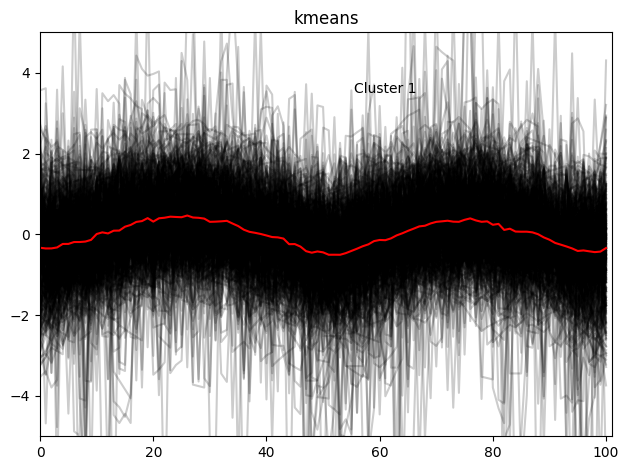

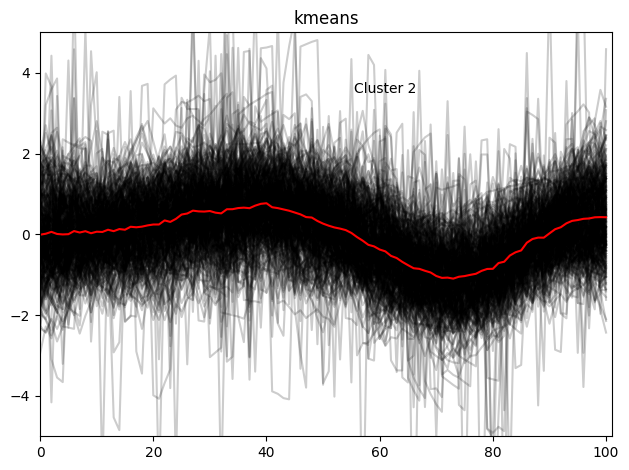

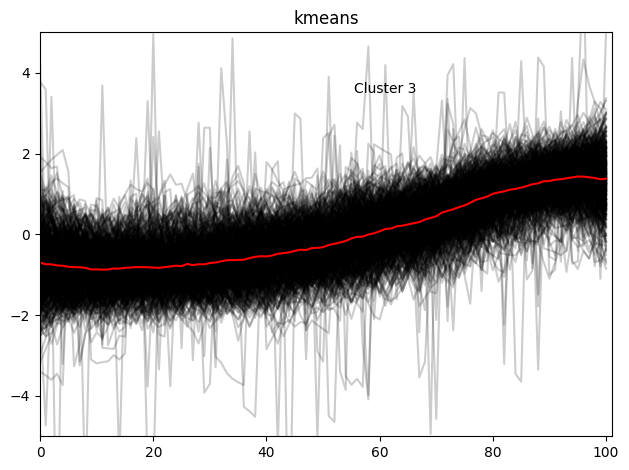

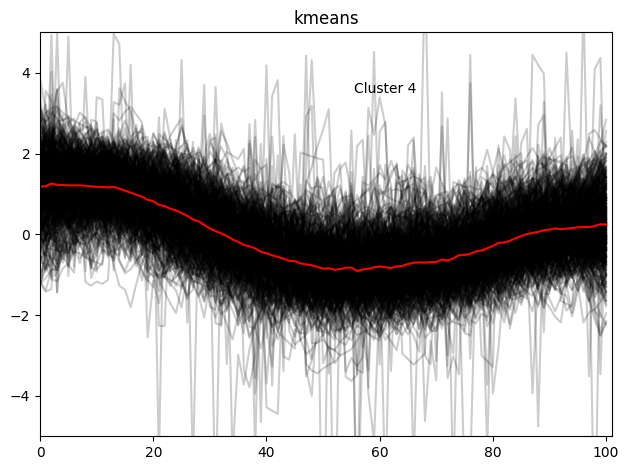

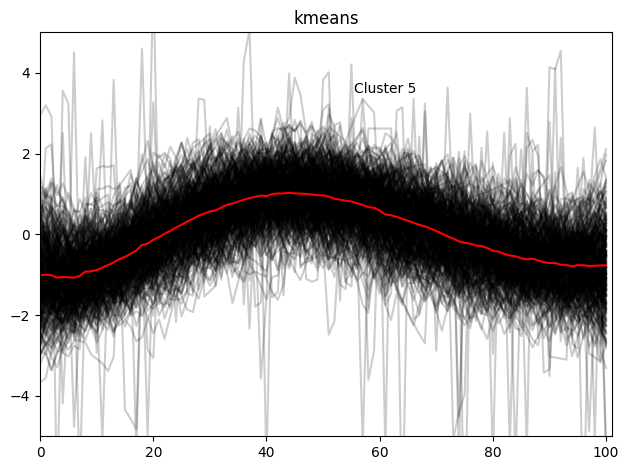

...

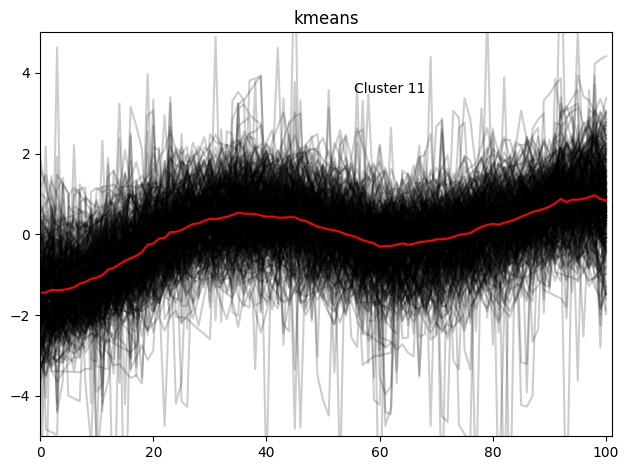

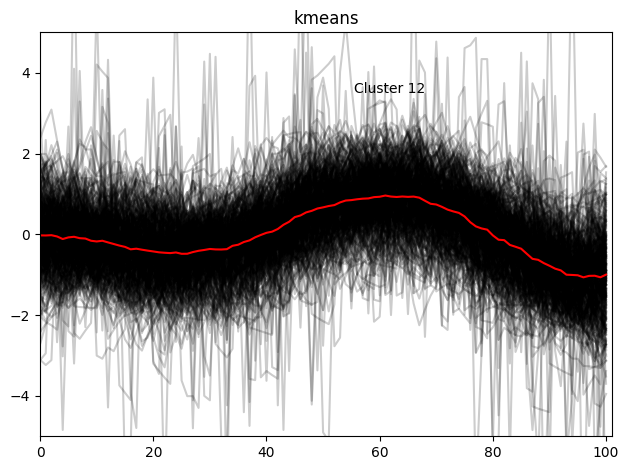

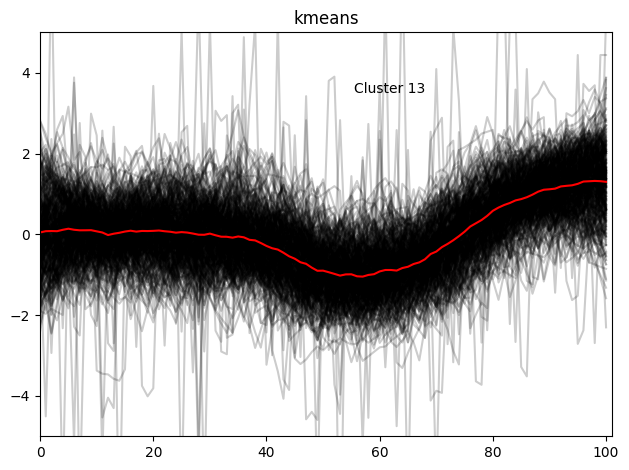

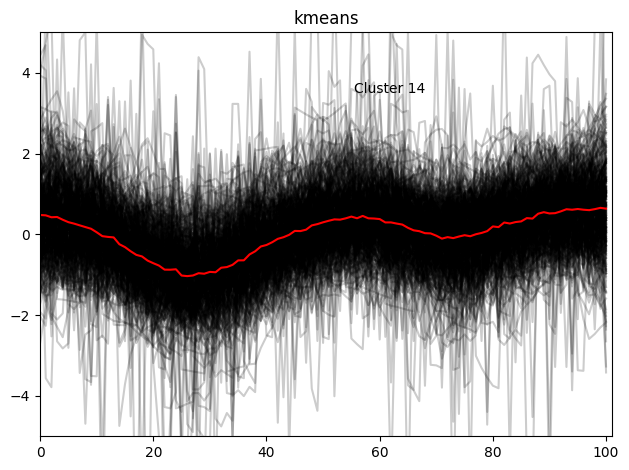

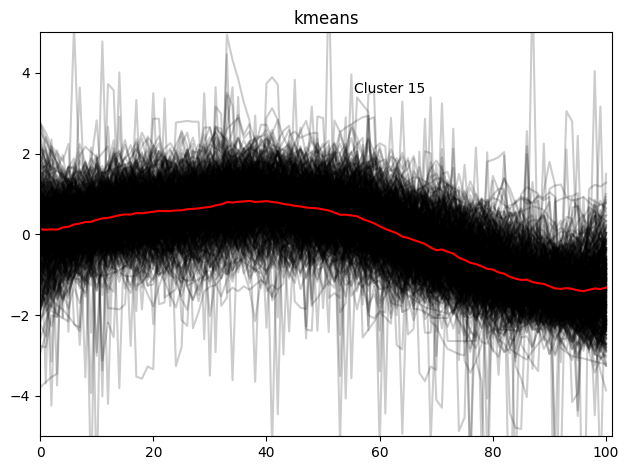

The 7.53% of the observations fall into Cluster 1
The 5.33% of the observations fall into Cluster 2
The 8.65% of the observations fall into Cluster 3
The 7.34% of the observations fall into Cluster 4
The 5.38% of the observations fall into Cluster 5
The 6.38% of the observations fall into Cluster 6
The 7.06% of the observations fall into Cluster 7
The 5.53% of the observations fall into Cluster 8
The 9.21% of the observations fall into Cluster 9
The 6.46% of the observations fall into Cluster 10
The 5.37% of the observations fall into Cluster 11
The 6.08% of the observations fall into Cluster 12
The 5.46% of the observations fall into Cluster 13
The 5.97% of the observations fall into Cluster 14
The 8.25% of the observations fall into Cluster 15


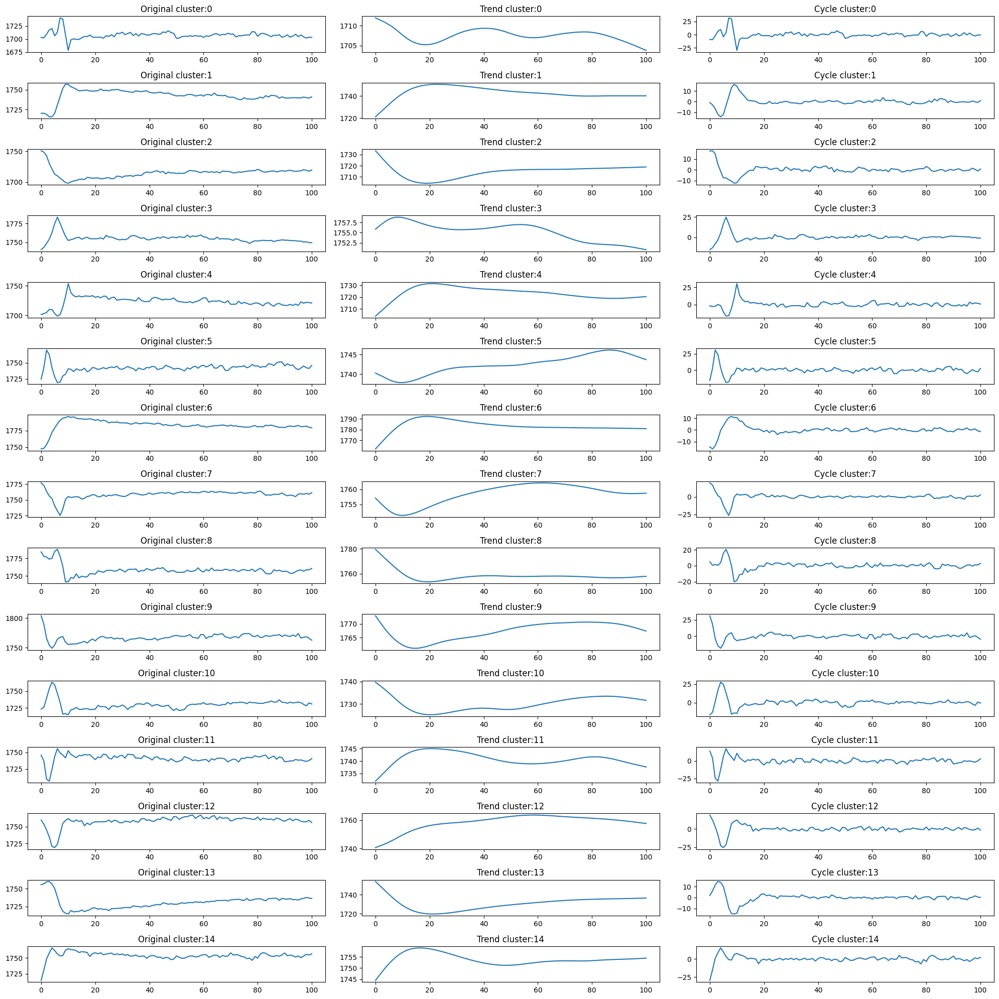

In [277]:
def get_samples(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        v=players_dict[p]
        samples[p]=list(v[(v.index<=offset+num_samples)&(v.index>=offset)]["Elo"])
            
    return samples

def get_samples_dates(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        v=players_dict[p]
        samples[p]=list(v[(v.index<=offset+num_samples)&(v.index>=offset)]["Timestamp"])
            
    return samples

W=100

df=pd.DataFrame.from_dict(get_samples(players_dict,50,W)).T


# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values 
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization 
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)



label=kmeans_cluster(15,"kmeans_euclidean_25",X_train,"euclidean")


players_names=list(df.index)
df=pd.DataFrame.from_dict(get_samples(players_dict,50,W)).T
df["kmeans_euclidean_label"]=labels
plt.figure(figsize=(20, 20))

for l in list(set(labels)):
    centroii=np.mean(df[df["kmeans_euclidean_label"]==l][[i for i in range(0,W+1)]], axis=0)
    y=centroii.values.reshape(-1, 1) 
    X=np.array(list(range(len(y)))).reshape(-1, 1) 
    cycle, trend = sm.tsa.filters.hpfilter(y, lamb=1600)
    plt.subplot(15,  3,(3*l)+1) 
    plt.plot(y, label='Original')
    plt.title(f'Original cluster:{l}')
    plt.subplot(15,  3,(3*l)+2) 
    plt.plot(trend, label='Trend')
    plt.title(f'Trend cluster:{l}')
    plt.subplot(15,  3,(3*l)+3) 
    plt.plot(cycle, label='Cycle')
    plt.title(f'Cycle cluster:{l}')
plt.tight_layout()
plt.show()

,0,1,2,3,4,5,6,7,8,9,...,141,142,143,144,145,146,147,148,149,150
petedoherty,-2.279636,-2.131295,-1.884060,-1.612102,-1.340143,-1.117632,-0.895121,-1.191803,-1.315420,-1.117632,...,-0.400651,-0.672610,-0.895121,-0.672610,-0.524269,-0.870397,-1.117632,-0.796227,-1.092909,-1.439037
tom62,-2.292359,-1.880770,-1.503480,-1.160490,-0.714602,-0.680303,-0.200116,0.108576,0.417267,0.623062,...,-0.543106,-0.920396,-1.091892,-0.783200,-1.057592,-0.680303,-0.234415,-0.543106,-0.988994,-1.263387
dachampChi,-1.305842,-0.669624,-1.078622,-0.306071,-0.760513,-0.124294,0.511924,0.239259,-0.078850,-0.306071,...,-0.124294,-0.124294,-0.624180,-0.215183,-0.760513,-1.260398,-1.578507,-0.896845,-0.396959,-0.033406
sniperchess,0.122342,0.479322,0.657811,0.866049,1.163532,1.461015,1.104036,1.252777,1.401519,1.252777,...,0.628063,0.836301,0.360329,0.509070,-0.026399,-0.383379,-0.175141,-0.026399,-0.323882,-0.621365
Analitico,-3.087735,-2.732318,-2.376901,-2.080720,-2.080720,-1.784539,-1.488358,-1.251414,-1.044087,-0.688670,...,-0.007454,-0.303635,-0.629434,-0.807142,-0.984851,-0.570197,-0.777524,-0.422107,-0.747906,-0.955233


,0,1,2,3,4,5,6,7,8,9,...,141,142,143,144,145,146,147,148,149,150
petedoherty,0.050847,0.084746,0.141243,0.203390,0.265537,0.316384,0.367232,0.299435,0.271186,0.316384,...,0.480226,0.418079,0.367232,0.418079,0.451977,0.372881,0.316384,0.389831,0.322034,0.242938
tom62,0.047619,0.142857,0.230159,0.309524,0.412698,0.420635,0.531746,0.603175,0.674603,0.722222,...,0.452381,0.365079,0.325397,0.396825,0.333333,0.420635,0.523810,0.452381,0.349206,0.285714
dachampChi,0.336207,0.456897,0.379310,0.525862,0.439655,0.560345,0.681034,0.629310,0.568966,0.525862,...,0.560345,0.560345,0.465517,0.543103,0.439655,0.344828,0.284483,0.413793,0.508621,0.577586
sniperchess,0.619403,0.708955,0.753731,0.805970,0.880597,0.955224,0.865672,0.902985,0.940299,0.902985,...,0.746269,0.798507,0.679104,0.716418,0.582090,0.492537,0.544776,0.582090,0.507463,0.432836
Analitico,0.000000,0.067416,0.134831,0.191011,0.191011,0.247191,0.303371,0.348315,0.387640,0.455056,...,0.584270,0.528090,0.466292,0.432584,0.398876,0.477528,0.438202,0.505618,0.443820,0.404494


(6798, 151, 1) (6798, 151, 1)


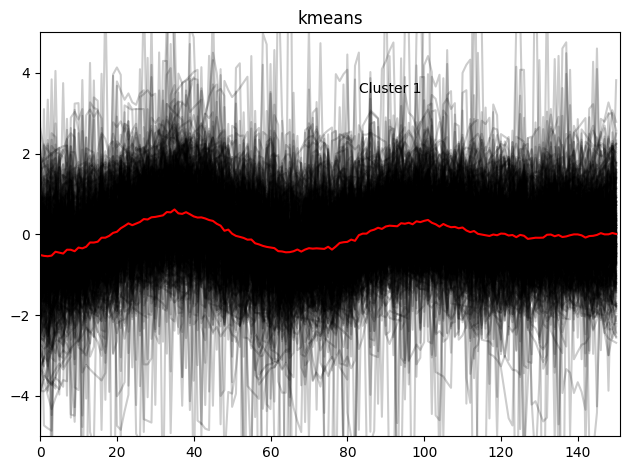

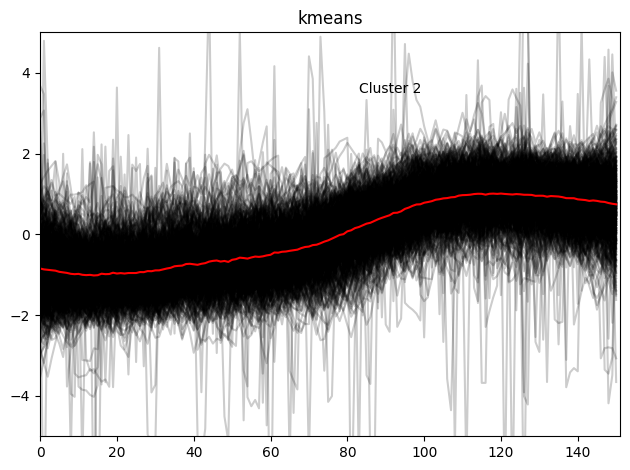

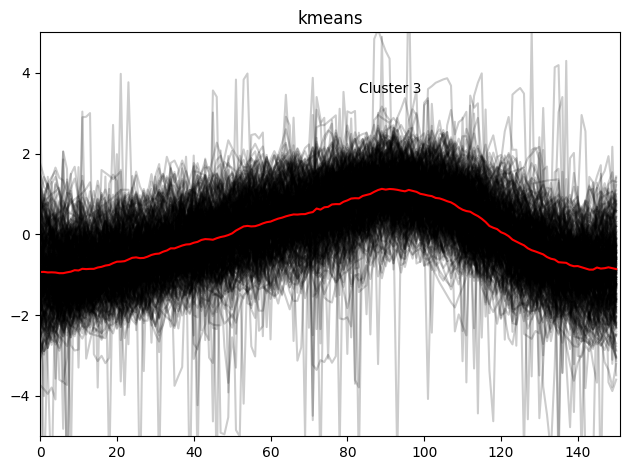

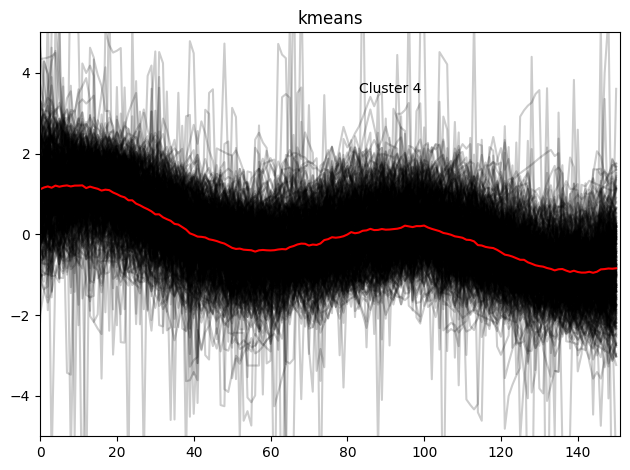

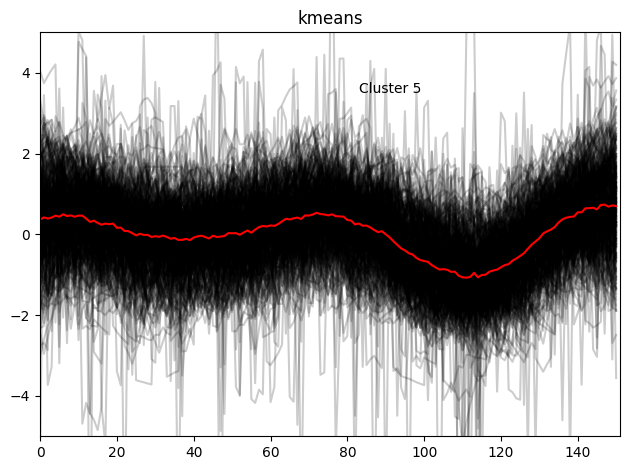

...

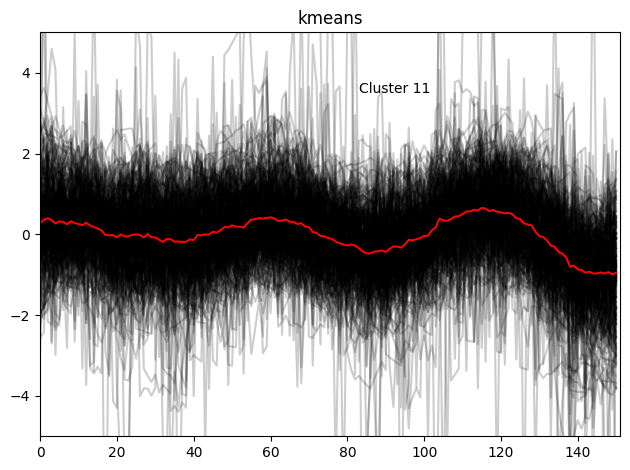

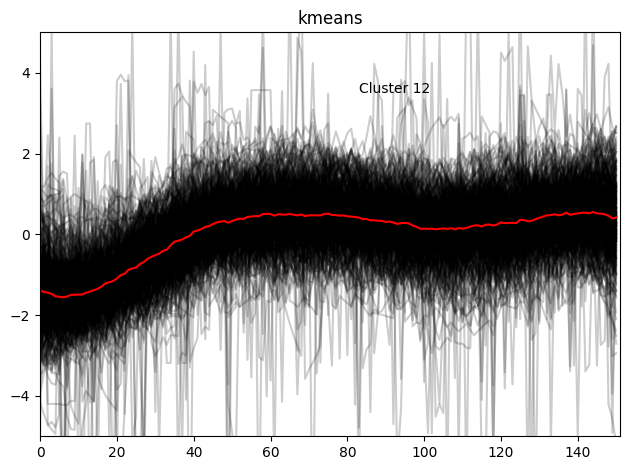

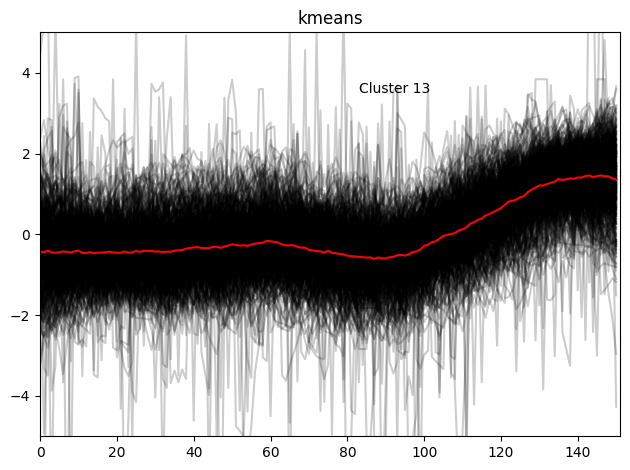

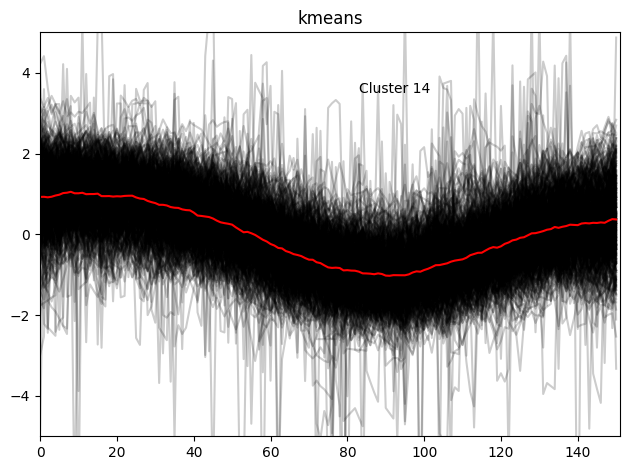

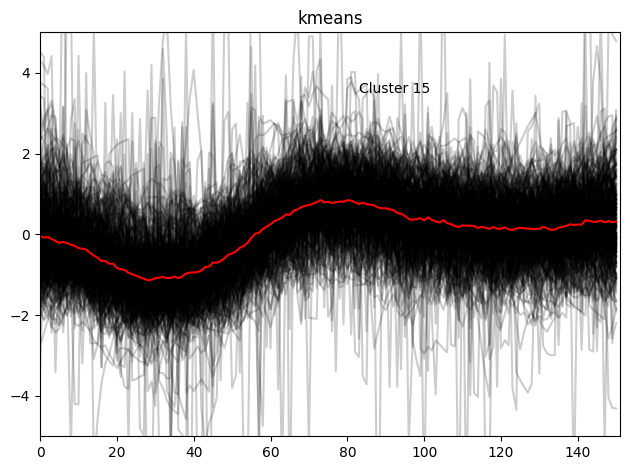

The 6.38% of the observations fall into Cluster 1
The 9.33% of the observations fall into Cluster 2
The 5.46% of the observations fall into Cluster 3
The 6.83% of the observations fall into Cluster 4
The 5.37% of the observations fall into Cluster 5
The 10.58% of the observations fall into Cluster 6
The 6.53% of the observations fall into Cluster 7
The 4.91% of the observations fall into Cluster 8
The 5.28% of the observations fall into Cluster 9
The 7.94% of the observations fall into Cluster 10
The 4.63% of the observations fall into Cluster 11
The 6.37% of the observations fall into Cluster 12
The 6.94% of the observations fall into Cluster 13
The 8.03% of the observations fall into Cluster 14
The 5.41% of the observations fall into Cluster 15


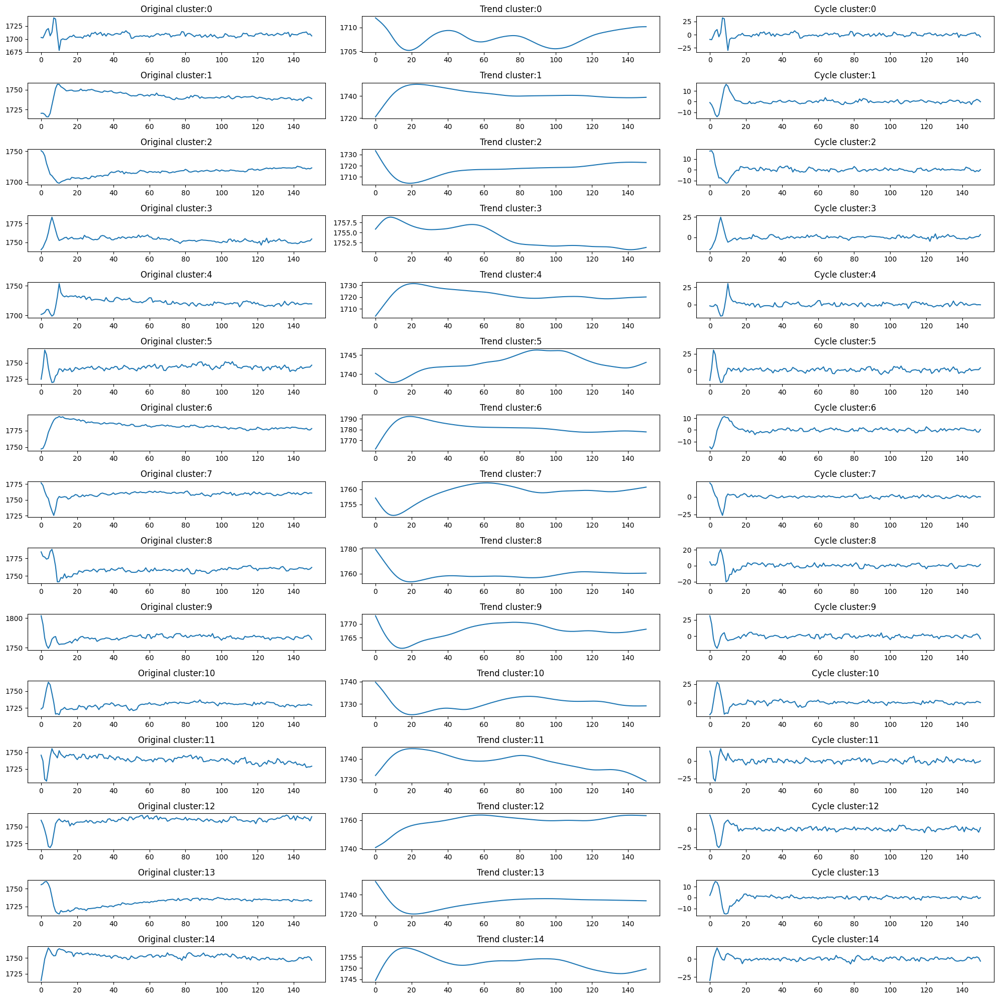

In [278]:
def get_samples(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        v=players_dict[p]
        samples[p]=list(v[(v.index<=offset+num_samples)&(v.index>=offset)]["Elo"])
            
    return samples

def get_samples_dates(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        v=players_dict[p]
        samples[p]=list(v[(v.index<=offset+num_samples)&(v.index>=offset)]["Timestamp"])
            
    return samples

W=150

df=pd.DataFrame.from_dict(get_samples(players_dict,50,W)).T


# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values 
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization 
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)



label=kmeans_cluster(15,"kmeans_euclidean_25",X_train,"euclidean")


players_names=list(df.index)
df=pd.DataFrame.from_dict(get_samples(players_dict,50,W)).T
df["kmeans_euclidean_label"]=labels
plt.figure(figsize=(20, 20))

for l in list(set(labels)):
    centroii=np.mean(df[df["kmeans_euclidean_label"]==l][[i for i in range(0,W+1)]], axis=0)
    y=centroii.values.reshape(-1, 1) 
    X=np.array(list(range(len(y)))).reshape(-1, 1) 
    cycle, trend = sm.tsa.filters.hpfilter(y, lamb=1600)
    plt.subplot(15,  3,(3*l)+1) 
    plt.plot(y, label='Original')
    plt.title(f'Original cluster:{l}')
    plt.subplot(15,  3,(3*l)+2) 
    plt.plot(trend, label='Trend')
    plt.title(f'Trend cluster:{l}')
    plt.subplot(15,  3,(3*l)+3) 
    plt.plot(cycle, label='Cycle')
    plt.title(f'Cycle cluster:{l}')
plt.tight_layout()
plt.show()

In [281]:
!ls

ariel@192.168.1.25	data	    eda4.ipynb	meta	  Untitled-Copy1.ipynb
bigdata_chess		data2	    eda.ipynb	run.txt   Untitled.ipynb
bigdata_chess.egg-info	data3	    extract.py	setup.py
build			dist	    graphs	test
cluster.ipynb		eda2.ipynb  lichness	tsl


In [282]:
with open("data/lichess/dataset_raw/players_dict.pkl", 'wb') as f:
    players_dict=pickle.load(f)  

In [286]:
players=list(players_dict.keys())

In [289]:
len(players)
!mkdir data/lichess/players #

In [1]:
players_info_df=pd.read_csv("data/lichess/players/players-detail-chess-games-for-uni-course.csv")

NameError: name 'pd' is not defined

In [326]:
for c in players_info_df.columns:
    print(c)

Unnamed: 0
createdAt
perfs_rapid_rating
seenAt
perfs_streak_runs
perfs_classical_rating
profile_lastName
count_rated
perfs_racingKings_prog
id
count_winH
perfs_atomic_games
perfs_rapid_prog
perfs_horde_rd
perfs_atomic_rd
perfs_threeCheck_rd
perfs_racer_runs
profile_dsbRating
perfs_antichess_prov
perfs_kingOfTheHill_prog
perfs_storm_score
disabled
perfs_classical_rd
perfs_classical_prov
perfs_chess960_prog
perfs_crazyhouse_rd
profile_uscfRating
perfs_classical_games
perfs_blitz_rd
perfs_horde_prov
perfs_correspondence_prov
username
perfs_horde_games
perfs_ultraBullet_rd
perfs_threeCheck_prog
playTime_tv
perfs_correspondence_games
perfs_threeCheck_rating
perfs_puzzle_rating
perfs_correspondence_rating
perfs_horde_rating
perfs_kingOfTheHill_games
perfs_crazyhouse_prog
perfs_kingOfTheHill_rd
count_lossH
profile_ecfRating
count_import
perfs_puzzle_prog
perfs_threeCheck_prov
profile_firstName
perfs_chess960_rd
perfs_horde_prog
tosViolation
perfs_racingKings_rd
perfs_atomic_prog
perfs_crazyho

In [4]:
chess_games_df=read_file("data/lichess/dataset_raw/chess_games.csv")

NameError: name 'read_file' is not defined

In [ ]:
len(chess_games_df)

In [29]:
w=dict(chess_games_df["White"].value_counts())
b=dict(chess_games_df["Black"].value_counts())

players=list(w)+list(b)
players=list(set(players))
all={}

players=list(w)+
all=w
for k,v in b.items():
    all[k]=all.get(k,0)+v
h=[]
for k,v in w.items():
    if v>200:
        h.append(k)
len(h)

6798

In [30]:
chess_games_df=chess_games_df[chess_games_df["Event"]==" Blitz "]

In [31]:
df1=chess_games_df[(chess_games_df["White"].isin(h))&(chess_games_df["Black"].isin(h))]
df2=chess_games_df[(chess_games_df["White"].isin(h))&(~chess_games_df["Black"].isin(h))]
df3=chess_games_df[(~chess_games_df["White"].isin(h))&(chess_games_df["Black"].isin(h))]
chess_games_df=pd.concat([df1,df2,df3])

In [32]:
players=list(set(chess_games_df["White"]))+list(set(chess_games_df["Black"]))
players=list(set(players))

In [34]:
len(list(set(chess_games_df["White"])))

54080

In [ ]:
def get_players_atleast_x_games_type(x,game_type,df):
        
    df_c=(df[df["Event"]==" Blitz "])
    w=dict(df_c["White"].value_counts())
    b=dict(df_c["Black"].value_counts())
    all={}
    all=w
    for k,v in b.items():
        all[k]=all.get(k,0)+v
    h=[]
    for k,v in w.items():
        if v>200:
            h.append(k)
    len(h)

    #
    df=df[(df["White"].isin(h))|(df["Black"].isin(h))]
    
    #
    df1=df[(df["White"].isin(h))&(df["Black"].isin(h))]
    df1=df1[["White","WhiteElo","UTCDate","UTCTime"]].rename(columns={"White":"Player","WhiteElo":"Elo"})
    
    df2=df[(df["White"].isin(h))&(~df["Black"].isin(h))]
    df2=df2[["White","WhiteElo","UTCDate","UTCTime"]].rename(columns={"White":"Player","WhiteElo":"Elo"})
    
    #
    df3=df[(~df["White"].isin(h))&(df["Black"].isin(h))]
    df3=df3[["Black","BlackElo","UTCDate","UTCTime"]].rename(columns={"Black":"Player","BlackElo":"Elo"})
    
    #
    df4=df[(df["White"].isin(h))&(df["Black"].isin(h))]
    df4=df4[["Black","BlackElo","UTCDate","UTCTime"]].rename(columns={"Black":"Player","BlackElo":"Elo"})
    
    #
    df=pd.concat([df1,df2,df3,df4])
    return df
